In [1]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.io
import math
import sklearn
import sklearn.datasets

from opt_utils_v1a import load_params_and_grads, initialize_parameters, forward_propagation, backward_propagation
from opt_utils_v1a import compute_cost, predict, predict_dec, plot_decision_boundary, load_dataset
from testCases import *

%matplotlib inline
plt.rcParams['figure.figsize'] = (7.0, 4.0)
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

In [2]:
# GRADED FUNCTION: update_parameters_with_gd

def update_parameters_with_gd(parameters, grads, learning_rate):
    L = len(parameters)//2 #number of layers
    for l in range(L):
        parameters["W" + str(l+1)] = parameters["W" + str(l+1)] - learning_rate*grads["dW" + str(l+1)]
        parameters["b" + str(l+1)] = parameters["b" + str(l+1)] - learning_rate*grads["db" + str(l+1)]
        
        
    return parameters


In [3]:
parameters, grads, learning_rate = update_parameters_with_gd_test_case()
parameters = update_parameters_with_gd(parameters, grads, learning_rate)
print("W1 =\n" + str(parameters["W1"]))
print("b1 =\n" + str(parameters["b1"]))
print("W2 =\n" + str(parameters["W2"]))
print("b2 =\n" + str(parameters["b2"]))

W1 =
[[ 1.63535156 -0.62320365 -0.53718766]
 [-1.07799357  0.85639907 -2.29470142]]
b1 =
[[ 1.74604067]
 [-0.75184921]]
W2 =
[[ 0.32171798 -0.25467393  1.46902454]
 [-2.05617317 -0.31554548 -0.3756023 ]
 [ 1.1404819  -1.09976462 -0.1612551 ]]
b2 =
[[-0.88020257]
 [ 0.02561572]
 [ 0.57539477]]


# Stochastic Gradient Descent vs. (Batch) Gradient Descent
A variant of this is Stochastic Gradient Descent (SGD), which is equivalent to mini-batch gradient descent where each mini-batch has just 1 example. The update rule that you have just implemented does not change. What changes is that you would be computing gradients on just one training example at a time, rather than on the whole training set. The code examples below illustrate the difference between stochastic gradient descent and (batch) gradient descent.



In Stochastic Gradient Descent, you use only 1 training example before updating the gradients. When the training set is large, SGD can be faster. But the parameters will "oscillate" toward the minimum rather than converge smoothly.

 SGD leads to many oscillations to reach convergence. But each step is a lot faster to compute for SGD than for GD, as it uses only one training example.
 
Note also that implementing SGD requires 3 for-loops in total:

* Over the number of iterations

* Over the m training examples

* Over the layers (to update all parameters, from (W[1],b[1]) to (W[L],b[L])

In practice, you'll often get faster results if you do not use neither the whole training set, nor only one training example, to perform each update. Mini-batch gradient descent uses an intermediate number of examples for each step. With mini-batch gradient descent, you loop over the mini-batches instead of looping over individual training examples.

The difference between gradient descent, mini-batch gradient descent and stochastic gradient descent is the number of examples you use to perform one update step.

You have to tune a learning rate hyperparameter α.

With a well-turned mini-batch size, usually it outperforms either gradient descent or stochastic gradient descent (particularly when the training set is large).

In [4]:
def random_mini_batches(X, Y, mini_batch_size=64, seed=0):
    np.random.seed(seed)
    m = X.shape[1]
    mini_batches = []
    permutation = list(np.random.permutation(m))
    shuffled_X = X[:, permutation]
    shuffled_Y = Y[:, permutation].reshape((1, m))
    num_compelete_minibatches = math.floor(m/mini_batch_size)# number of mini batches of size mini_batch_size in your partitionning
    for k in range(0, num_compelete_minibatches):
        mini_batch_X = shuffled_X[:, k*mini_batch_size : (k+1)*mini_batch_size]
        mini_batch_Y = shuffled_Y[:, k*mini_batch_size : (k+1)*mini_batch_size]
        mini_batch = (mini_batch_X, mini_batch_Y)
        mini_batches.append(mini_batch)
        
    if m % mini_batch_size != 0:
        mini_batch_X = shuffled_X[:, int(m/mini_batch_size)*mini_batch_size : ]
        mini_batch_Y = shuffled_Y[:, int(m/mini_batch_size)*mini_batch_size : ]
        mini_batch = (mini_batch_X, mini_batch_Y)
        mini_batches.append(mini_batch)
    return mini_batches    

In [5]:
X_assess, Y_assess, mini_batch_size = random_mini_batches_test_case()
mini_batches = random_mini_batches(X_assess, Y_assess, mini_batch_size)

print ("shape of the 1st mini_batch_X: " + str(mini_batches[0][0].shape))
print ("shape of the 2nd mini_batch_X: " + str(mini_batches[1][0].shape))
print ("shape of the 3rd mini_batch_X: " + str(mini_batches[2][0].shape))
print ("shape of the 1st mini_batch_Y: " + str(mini_batches[0][1].shape))
print ("shape of the 2nd mini_batch_Y: " + str(mini_batches[1][1].shape)) 
print ("shape of the 3rd mini_batch_Y: " + str(mini_batches[2][1].shape))
print ("mini batch sanity check: " + str(mini_batches[0][0][0][0:3]))

shape of the 1st mini_batch_X: (12288, 64)
shape of the 2nd mini_batch_X: (12288, 64)
shape of the 3rd mini_batch_X: (12288, 20)
shape of the 1st mini_batch_Y: (1, 64)
shape of the 2nd mini_batch_Y: (1, 64)
shape of the 3rd mini_batch_Y: (1, 20)
mini batch sanity check: [ 0.90085595 -0.7612069   0.2344157 ]


# Momentum

Because mini-batch gradient descent makes a parameter update after seeing just a subset of examples, the direction of the update has some variance, and so the path taken by mini-batch gradient descent will "oscillate" toward convergence. Using momentum can reduce these oscillations.

Momentum takes into account the past gradients to smooth out the update. We will store the 'direction' of the previous gradients in the variable v. Formally, this will be the exponentially weighted average of the gradient on previous steps. You can also think of v as the "velocity" of a ball rolling downhill, building up speed (and momentum) according to the direction of the gradient/slope of the hill.



In [6]:
def initialize_velocity(parameters):
    L = len(parameters)//2
    v = {}
    for l in range(L):
        v["dW" + str(l+1)] = np.zeros((parameters["W" + str(l+1)].shape[0], parameters["W" + str(l+1)].shape[1]))
        v["db" + str(l+1)] = np.zeros((parameters["b" + str(l+1)].shape[0], parameters["b" + str(l+1)].shape[1]))
    return v

In [7]:
parameters = initialize_velocity_test_case()

v = initialize_velocity(parameters)
print("v[\"dW1\"] =\n" + str(v["dW1"]))
print("v[\"db1\"] =\n" + str(v["db1"]))
print("v[\"dW2\"] =\n" + str(v["dW2"]))
print("v[\"db2\"] =\n" + str(v["db2"]))

v["dW1"] =
[[0. 0. 0.]
 [0. 0. 0.]]
v["db1"] =
[[0.]
 [0.]]
v["dW2"] =
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
v["db2"] =
[[0.]
 [0.]
 [0.]]


In [8]:
def update_parameters_with_momentum(parameters, grads, v, beta, learning_rate):
    L = len(parameters)//2
    for l in range(L):
        v["dW" + str(l+1)] = beta*v["dW" + str(l+1)] + (1-beta)*grads["dW" + str(l+1)]
        v["db" + str(l+1)] = beta*v["db" + str(l+1)] + (1-beta)*grads["db" + str(l+1)]
        
        parameters["W" + str(l+1)] = parameters["W" + str(l+1)] - learning_rate*v["dW" + str(l+1)]
        parameters["b" + str(l+1)] = parameters["b" + str(l+1)] - learning_rate*v["db" + str(l+1)]
        
    return parameters, v

In [9]:
parameters, grads, v = update_parameters_with_momentum_test_case()

parameters, v = update_parameters_with_momentum(parameters, grads, v, beta = 0.9, learning_rate = 0.01)
print("W1 = \n" + str(parameters["W1"]))
print("b1 = \n" + str(parameters["b1"]))
print("W2 = \n" + str(parameters["W2"]))
print("b2 = \n" + str(parameters["b2"]))
print("v[\"dW1\"] = \n" + str(v["dW1"]))
print("v[\"db1\"] = \n" + str(v["db1"]))
print("v[\"dW2\"] = \n" + str(v["dW2"]))
print("v[\"db2\"] = v" + str(v["db2"]))

W1 = 
[[ 1.62544598 -0.61290114 -0.52907334]
 [-1.07347112  0.86450677 -2.30085497]]
b1 = 
[[ 1.74493465]
 [-0.76027113]]
W2 = 
[[ 0.31930698 -0.24990073  1.4627996 ]
 [-2.05974396 -0.32173003 -0.38320915]
 [ 1.13444069 -1.0998786  -0.1713109 ]]
b2 = 
[[-0.87809283]
 [ 0.04055394]
 [ 0.58207317]]
v["dW1"] = 
[[-0.11006192  0.11447237  0.09015907]
 [ 0.05024943  0.09008559 -0.06837279]]
v["db1"] = 
[[-0.01228902]
 [-0.09357694]]
v["dW2"] = 
[[-0.02678881  0.05303555 -0.06916608]
 [-0.03967535 -0.06871727 -0.08452056]
 [-0.06712461 -0.00126646 -0.11173103]]
v["db2"] = v[[0.02344157]
 [0.16598022]
 [0.07420442]]


* Note:

    If β=0, then this just becomes standard gradient descent without momentum.

#### How do you choose β? 
* The larger the momentum β is, the smoother the update because the more we take the past gradients into account. But if β is too big, it could also smooth out the updates too much.
* Common values for β range from 0.8 to 0.999. If you don't feel inclined to tune this, β=0.9 is often a reasonable default.
* Tuning the optimal β for your model might need trying several values to see what works best in term of reducing the value of the cost function J.

#### What you should remember?

* Momentum takes past gradients into account to smooth out the steps of gradient descent. It can be applied with batch gradient descent, mini-batch gradient descent or stochastic gradient descent.

* You have to tune a momentum hyperparameter β and a learning rate α.

# Adam
Adam is one of the most effective optimization algorithms for training neural networks. It combines ideas from RMSProp (described in lecture) and Momentum.

#### How does Adam work?
1. It calculates an exponentially weighted average of past gradients, and stores it in variables v (before bias correction) and vcorrected (with bias correction).
2. It calculates an exponentially weighted average of the squares of the past gradients, and stores it in variables s (before bias correction) and scorrected (with bias correction).
3. It updates parameters in a direction based on combining information from "1" and "2".

The update rule is, for l=1,...,L:

\begin{cases}
v_{dW^{[l]}} = \beta_1 v_{dW^{[l]}} + (1 - \beta_1) \frac{\partial \mathcal{J} }{ \partial W^{[l]} } \\
v^{corrected}_{dW^{[l]}} = \frac{v_{dW^{[l]}}}{1 - (\beta_1)^t} \\
s_{dW^{[l]}} = \beta_2 s_{dW^{[l]}} + (1 - \beta_2) (\frac{\partial \mathcal{J} }{\partial W^{[l]} })^2 \\
s^{corrected}_{dW^{[l]}} = \frac{s_{dW^{[l]}}}{1 - (\beta_2)^t} \\
W^{[l]} = W^{[l]} - \alpha \frac{v^{corrected}_{dW^{[l]}}}{\sqrt{s^{corrected}_{dW^{[l]}}} + \varepsilon}
\end{cases}


where:

* t counts the number of steps taken of Adam

* L is the number of layers

* β1 and β2 are hyperparameters that control the two exponentially weighted averages.

* α is the learning rate

* ε is a very small number to avoid dividing by zero

As usual, we will store all parameters in the parameters dictionary

In [10]:
def initialize_adam(parameters):
    L = len(parameters)//2
    v = {}
    s = {}
    for l in range(L):
        v["dW" + str(l+1)] = np.zeros((parameters["W" + str(l+1)].shape[0], parameters["W" + str(l+1)].shape[1]))
        v["db" + str(l+1)] = np.zeros((parameters["b" + str(l+1)].shape[0], parameters["b" + str(l+1)].shape[1]))
        
        s["dW" + str(l+1)] = np.zeros((parameters["W" + str(l+1)].shape[0], parameters["W" + str(l+1)].shape[1]))
        s["db" + str(l+1)] = np.zeros((parameters["b" + str(l+1)].shape[0], parameters["b" + str(l+1)].shape[1]))
        
    return v, s
    

In [11]:
parameters = initialize_adam_test_case()

v, s = initialize_adam(parameters)
print("v[\"dW1\"] = \n" + str(v["dW1"]))
print("v[\"db1\"] = \n" + str(v["db1"]))
print("v[\"dW2\"] = \n" + str(v["dW2"]))
print("v[\"db2\"] = \n" + str(v["db2"]))
print("s[\"dW1\"] = \n" + str(s["dW1"]))
print("s[\"db1\"] = \n" + str(s["db1"]))
print("s[\"dW2\"] = \n" + str(s["dW2"]))
print("s[\"db2\"] = \n" + str(s["db2"]))

v["dW1"] = 
[[0. 0. 0.]
 [0. 0. 0.]]
v["db1"] = 
[[0.]
 [0.]]
v["dW2"] = 
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
v["db2"] = 
[[0.]
 [0.]
 [0.]]
s["dW1"] = 
[[0. 0. 0.]
 [0. 0. 0.]]
s["db1"] = 
[[0.]
 [0.]]
s["dW2"] = 
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
s["db2"] = 
[[0.]
 [0.]
 [0.]]


In [12]:
def update_parameters_with_adam(parameters, grads, v, s, t, learning_rate=0.01, 
                               beta1=0.9, beta2=0.999, epsilon=1e-8):
    L = len(parameters)//2
    v_corrected = {}
    s_corrected = {}
    
    for l in range(L):
        v["dW" + str(l+1)] = beta1*v["dW" + str(l+1)] + (1-beta1)*grads["dW" + str(l+1)]
        v["db" + str(l+1)] = beta1*v["db" + str(l+1)] + (1-beta1)*grads["db" + str(l+1)]
        # Compute bias-corrected first moment estimate.
        v_corrected["dW" + str(l+1)] = v["dW" + str(l+1)]/(1-beta1**t)
        v_corrected["db" + str(l+1)] = v["db" + str(l+1)]/(1-beta1**t)
        
        s["dW" + str(l+1)] = beta2*s["dW" + str(l+1)] + (1-beta2)*np.square(grads['dW' + str(l+1)])
        s["db" + str(l+1)] = beta2*s["db" + str(l+1)] + (1-beta2)*np.square(grads['db' + str(l+1)])
        
        s_corrected["dW" + str(l+1)] = s["dW" + str(l+1)]/(1-beta2**t)
        s_corrected["db" + str(l+1)] = s["db" + str(l+1)]/(1-beta2**t)
        
        parameters["W" + str(l+1)] = parameters["W" + str(l+1)] - learning_rate*v_corrected["dW" + str(l+1)]/(np.sqrt(s_corrected["dW" + str(l+1)]))
        parameters["b" + str(l+1)] = parameters["b" + str(l+1)] - learning_rate*v_corrected["db" + str(l+1)]/(np.sqrt(s_corrected["db" + str(l+1)]))
        
    return parameters, v, s
        

In [13]:
parameters, grads, v, s = update_parameters_with_adam_test_case()
parameters, v, s  = update_parameters_with_adam(parameters, grads, v, s, t = 2)

print("W1 = \n" + str(parameters["W1"]))
print("b1 = \n" + str(parameters["b1"]))
print("W2 = \n" + str(parameters["W2"]))
print("b2 = \n" + str(parameters["b2"]))
print("v[\"dW1\"] = \n" + str(v["dW1"]))
print("v[\"db1\"] = \n" + str(v["db1"]))
print("v[\"dW2\"] = \n" + str(v["dW2"]))
print("v[\"db2\"] = \n" + str(v["db2"]))
print("s[\"dW1\"] = \n" + str(s["dW1"]))
print("s[\"db1\"] = \n" + str(s["db1"]))
print("s[\"dW2\"] = \n" + str(s["dW2"]))
print("s[\"db2\"] = \n" + str(s["db2"]))

W1 = 
[[ 1.63178673 -0.61919778 -0.53561312]
 [-1.08040999  0.85796626 -2.29409733]]
b1 = 
[[ 1.75225313]
 [-0.75376553]]
W2 = 
[[ 0.32648046 -0.25681174  1.46954931]
 [-2.05269934 -0.31497584 -0.37661299]
 [ 1.14121081 -1.0924499  -0.16498684]]
b2 = 
[[-0.88529979]
 [ 0.03477238]
 [ 0.57537385]]
v["dW1"] = 
[[-0.11006192  0.11447237  0.09015907]
 [ 0.05024943  0.09008559 -0.06837279]]
v["db1"] = 
[[-0.01228902]
 [-0.09357694]]
v["dW2"] = 
[[-0.02678881  0.05303555 -0.06916608]
 [-0.03967535 -0.06871727 -0.08452056]
 [-0.06712461 -0.00126646 -0.11173103]]
v["db2"] = 
[[0.02344157]
 [0.16598022]
 [0.07420442]]
s["dW1"] = 
[[0.00121136 0.00131039 0.00081287]
 [0.0002525  0.00081154 0.00046748]]
s["db1"] = 
[[1.51020075e-05]
 [8.75664434e-04]]
s["dW2"] = 
[[7.17640232e-05 2.81276921e-04 4.78394595e-04]
 [1.57413361e-04 4.72206320e-04 7.14372576e-04]
 [4.50571368e-04 1.60392066e-07 1.24838242e-03]]
s["db2"] = 
[[5.49507194e-05]
 [2.75494327e-03]
 [5.50629536e-04]]


### Model with different optimization algorithms


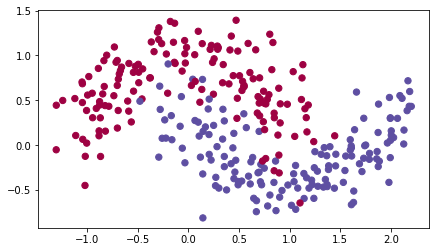

In [14]:
train_X, train_Y = load_dataset()

In [15]:
def model(X, Y, layers_dims, optimizer, learning_rate=0.0007, mini_batch_size=64, beta=0.9,
         beta1=0.9, beta2=0.999, epsilon=1e-8, num_epochs=10000, print_cost=True):
    L = len(layers_dims)
    costs = []
    t = 0
    seed = 10
    m = X.shape[1]
    print("\nThe number of training examples is : %i\n" %m)
    print("The mini-batch size : %i\n" %mini_batch_size)
    parameters = initialize_parameters(layers_dims)
    
    if optimizer == "gd":
        pass # no initialization required for gradient descent
    elif optimizer == "momentum":
        v = initialize_velocity(parameters)
    elif optimizer == "adam":
        v, s = initialize_adam(parameters)
    for i in range(num_epochs):
        # Define the random minibatches. We increment the seed to reshuffle differently the dataset after each epoch
        seed = seed + 1
        minibatches = random_mini_batches(X, Y, mini_batch_size, seed)
        cost_total = 0
        for minibatch in minibatches:
            (minibatch_X, minibatch_Y) = minibatch
            a3, caches = forward_propagation(minibatch_X, parameters)
            print("\n OK OK \n")
            print(minibatch_Y)
            print("\n OK OK \n")
            grads = backward_propagation(minibatch_X, minibatch_Y, caches)
            # Update parameters
            if optimizer == "gd":
                parameters = update_parameters_with_gd(parameters, grads, learning_rate)
            elif optimizer == "momentum":
                parameters, v = update_parameters_with_momentum(parameters, grads, v, beta, learning_rate)
            elif optimizer == "adam":
                t = t + 1
                parameters, v, s = update_parameters_with_adam(parameters, grads, v, s, 
                                                              t, learning_rate, beta1, beta2, epsilon)
        cost_avg = cost_total / m
        if print_cost and i % 1000 == 0:
            print ("Cost after epoch %i: %f" %(i, cost_avg))
        if print_cost and i % 100 == 0:
            costs.append(cost_avg)
            
    # plot the cost
    plt.plot(costs)
    plt.ylabel('cost')
    plt.xlabel('epochs (per 100)')
    plt.title("Learning rate = " + str(learning_rate))
    plt.show()

    return parameters
            

You will now run this 3 layer neural network with each of the 3 optimization methods.

### Mini-batch Gradient descent


The number of training examples is : 300

The mini-batch size : 64


 OK OK 

[[1 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 1
  1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 1 0 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0 0 0 0 1 1 1 1 0 1 1 0
  1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 0 1 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 0 1 1 0 1 1 1 0 1 0 0 0 1 1 1 1 1 1 1
  1 1 0 1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 0 0 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 0 0 1
  0 1 1 0 0 0 0 0 0 0 0 1 1 1 1 0 1 0 0 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 1 0 1 0 0 0 0 1 0 1 1 0 1 0 1 0 0 0 1 0 1 1 1 1 0 1 1 0
  1 0 0 0 0 0 0 0]]

 OK OK 

Cost after epoch 0: 0.000000

 OK OK 

[[0 0 0 0 1 1 1 0 0 0 1 1 0 1 0 1 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 1 0 0 1
  1 0 1 0 1 1 1 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 


[[0 1 0 1 1 1 1 0 0 1 1 0 1 0 0 0 0 1 1 1 0 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0
  0 1 0 1 1 1 1 0 0 1 0 1 0 1 0 0 0 0 0 1 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 1 1 1 0 1 0 1 1 1 0 1 0 1 1 0 0 1 0 0 1 0 0 1 0 0 0 0 1 0
  0 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0 1 0 1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 0 0 0 1 0 0 0 1 1 0 0 1 0 1 0 1 1 1 0 1 0 0 0 0 1 0 1 0
  0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 0 1 0 0 0 0 1 1 1 0 1 1 0 1 1 1 0 1 1 1 0 1 1 1 1 1 1 0
  0 0 0 0 1 0 0 0 0 0 1 0 1 1 0 1 1 0 0 0 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 1 0 1 1 0 0 1 1 1 0 1 1 0 0 1 0 0 1 0 0 0 1 1 1 0 1 1 1
  0 1 1 1 1 1 0 1 1 0 1 0 1 0 1 0 1 1 1 0 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1 1 1 0 0 0 0 1 0 0 1 1 1 0 0 0 1 0 0 0
  1 0 0 0 0 1 1 0 0 1 1 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 0 1 1 1 1 0 1 1 0 0 1 1 0 1 1 1 0 1 1 0 1 1 0 1 1 0 0 0
  0 0 1 1 0 0 0 1 0 0 0 1 0 1 1 1 1 1 0 0


 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 1 0 1 1 1 1 0 1 1 1 1 0 1 0 0 0 1 0 0 0 0 1 0 1 0 0 1 0
  0 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 1 1 0 0 0 0 1 1 1 0 0 0 0 0 1 1 1 1 1 0 0 1 0 1 0 1 1 1
  0 0 1 1 0 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 0 0 1 0 0 1 0 0 0 1 1 0 1 0 1 1 1 0 1 1 0 0 0 1 1 1 0 1
  0 1 1 0 1 0 0 0 1 1 1 0 1 1 0 1 1 1 1 0 0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 1 1 1 0 1 1 1 1 0 1 0 0 1 1 1 0 0 0 1 1 1 0 0 0 0 1 0 1
  1 1 0 0 0 1 1 0 1 1 1 0 0 1 1 0 0 1 1 1 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 0 0 0 0 1 1 1 0 1 0 0 0 1 1 1 1 0 1 1 0 1 0 0 0 0 0 1 0
  1 0 1 0 1 0 0 1 0 0 0 0 0 0 0 1 0 1 0 1 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 1 1 1 1 0 0 1 0 1 0 0 0 1 1 0 0 1 0 0 1 0 1 0 0 0 1 0 0
  1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 1 1 0 0 0 1 0 1 0 0 0 1 0 1 1 0 1 0 0 0 1 0 1 1 1 0 1 1
  1 1 0 1 1 0 0 1 0 0 0 1 0 0 1 0 0 1 0 0 1 0 1 1 1 0 1 1]]

 


[[0 0 0 1 1 1 0 1 1 0 0 1 1 0 0 1 0 0 1 0 1 0 0 1 0 1 0 1 1 0 1 0 0 0 1 1
  0 0 0 0 1 0 1 0 1 0 0 1 0 0 0 0 1 1 1 1 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 1 1 0 1 1 0 0 1 0 1 1 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 0 1
  0 1 0 0 0 0 1 1 0 0 1 1 0 1 0 0 0 1 0 1 0 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 1 0 0 1 0 1 1 1 1 1 1 0 1 1 0 0 1 1 1 1 0 0 0 1 0 1 1 1
  1 1 1 0 1 1 1 0 1 1 0 1 1 0 0 1 1 1 1 0 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 0 0 0 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1 1 0 0 1 0 0 1 1 1
  1 1 0 1 0 1 1 1 0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 0 1 0 1 0 1 1 0 0 1 0 1 0 0 1 0 0 0 0 0 1 0 1 1 0 1 1 0
  0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 0 0 1 1 1 0 1 0 1 1 1 1
  1 0 0 0 1 0 0 1 1 0 0 0 0 1 1 1 1 1 0 1 0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 0 0 0 1 1 1 1 1 0 0 1 0 1 1 1
  0 0 0 0 0 1 0 0 1 0 0 1 1 0 1 1 1 0 0 1


 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 1 1 0 1 0 0 1 0 0 1 1 1 0 0 0 1 0 1 1 1 0
  1 1 1 1 0 1 0 1 1 0 0 0 0 1 1 1 1 0 1 1 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 0 1 0 0 1 0 0 0 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 1 0 0 0 0
  0 1 0 0 1 0 0 1 1 0 1 0 0 1 1 0 0 0 1 1 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 0 0 0 0 0 0 1 1 0 1 1 1 1 0 0 1 0 1 1 0 0 0 1 0 1 1 1 1
  1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 1 1 0 1 1 0 0 1 1 0 1 1 1 1 0 0 0 1 1 0 1 0 1 1 1 1 0 0 0
  0 0 0 0 1 0 0 1 0 1 1 1 1 1 1 1 0 0 1 1 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 1 0 1 0 1 0 1 0 1 1 0 0 0 0 0 1 0 0 1 0 0 0 1 1 1 0 1 1
  0 0 0 0 1 0 0 0 0 0 1 1 0 1 0 1 0 1 1 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 0 1 1 0 1 0 0 1 1 0 1 0 0 1 0 0 0 1 1 1 0 1 1 0 1 0 0
  0 1 0 0 1 0 0 1 1 1 1 0 0 1 1 0 1 1 1 1 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 1 1 0 0 0 1 0 0 1 0 1 1 1 0 0 1 1 1 0 0 0 0 0 0 1 1 0 1
  0 1 1 1 0 1 0 1 0 0 


[[1 1 1 0 1 1 1 0 0 0 0 0 0 0 1 1 0 1 1 0 1 1 0 0 1 1 1 1 0 0 1 0 0 1 0 1
  0 0 0 1 0 1 1 1 0 1 1 0 1 0 1 1 0 0 1 1 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 0 0 1 0 0 1 0 0 0 1 1 0 1 0 0 0 1 0 1 0 0 0 1 1 1 0 0 1
  0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 0 0 1 1 1 1 0 1 0 0 1 0 0 1 1 1 0 0 0 0 1 0 1 0 1 0 0 1
  0 1 1 0 0 0 1 1 0 0 0 1 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 0 1 0 1 0 0 1 0 1 0 1 0 1 0 0 0 1 0 0 0 0 1 1 0 1 1 0 1
  0 0 1 1 0 1 0 0 1 1 0 0 1 1 1 1 1 1 1 0 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 0 1 0 1 0 0 1 1 0 0 1 0 1 1 1 1 0 1 0 1 0 1 1 1 1 0 1 1
  0 0 1 1 0 1 1 0 0 0 1 0 0 1 1 1 0 1 0 0 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 1 1 1 1 0 0 1 0 1 1 0 0 1 1 1 1 0 0 0 0 0 0 1 1 1 1 0 0
  0 0 1 0 0 1 1 0 1 1 1 0 0 1 0 0 0 1 0 0 1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 1 0 1 0 0 0 0 1 0 1 1 1 0 0 1 1 1 0 0 0 0 0 0 0 1 0 1 1
  1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[


 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 1 1 0 1 0 1 0 0 0 0 1 0 1 1 0 1 1 0 1 1 1 0 1 0 0 0 0 0
  0 0 1 1 1 1 1 0 1 0 0 1 0 0 0 0 0 1 0 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 1 0 1 0 0 0 0 0 1 1 1 1 1 0 1 0 1 1 1 0 0 0 0 0 0 0 0 0
  0 1 0 1 0 1 0 0 1 1 0 0 1 0 0 0 1 0 0 1 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 0 1 0 1 0 1 1 0 1 0 0 1 1 0 1 1 1 1 1 0 0 0 1 0 0 1 0 0
  0 0 1 0 1 0 1 1 1 0 1 0 1 0 1 0 0 1 0 0 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 0 1 1 0 0 1 1 0 1 0 1 1 1 0 0 1 0 0 1 1 0 0 1 1 1 0 0 1 1
  1 0 1 0 1 1 1 0 0 1 0 1 1 1 1 1 0 0 1 1 1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 0 0 0 1 1 1 1 1 0 1 1 0 0 1 0 1 0 1 0 1 1 1 1 0 1 0 1 0
  0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 0 1 1 1 1 1 0 0 0 0 0 0 1 0 0 1 0 1 0 0 1 0 1 1 0 1 1
  1 0 1 0 1 0 0 0 0 1 0 0 1 0 1 0 1 1 0 0 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 0 0 1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 1 1 0 1 0 1 0 1 1 0 1
  0 0 1 1 0 0 0 1 0 1 


[[0 0 0 0 1 1 0 1 0 0 1 1 0 0 0 1 0 1 1 0 1 0 1 1 0 1 0 0 0 0 0 1 1 0 1 1
  1 0 0 0 1 0 1 0 0 1 1 0 0 0 0 0 1 1 0 1 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1 1 1 1 0 1 1 1 0 1 1 1 1 0
  1 0 1 1 1 0 1 1 1 1 1 0 0 1 0 0 0 1 0 1 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 0 1 1 1 1 1 1 1 1 1 0 0 1 1 0 0 1 0 0 1 0 1 0 0 0 1 1 0
  1 1 1 0 1 1 0 0 0 0 1 1 0 0 0 1 1 0 0 1 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 1 1 1 1 0 1 1 1 0 1 1 0 0 1 0 1 0 0 1 0 1 1 0 0 0 1 1 0
  0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 0 1 0 0 1 0 0 1 1 1 0 0 0 1 0 1 1 1 0 0 1 1 1 1 1 1 0 1
  0 1 1 1 1 1 0 1 0 0 0 0 0 0 0 1 1 0 1 0 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 0 1 0 0 0 1 0 1 0 0 0 0 1 0 0 1 1 0 1 1 0 1 0 0 1 1 1 1
  1 0 0 0 1 0 0 0 0 1 0 0 0 1 0 1 1 1 1 0 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 1 0 0 0 1 1 1 1 0 0 1 1 1 1 0 1 1 1 0 1 0 0 0 0 1 1 0 0
  1 0 1 1 0 0 0 0 0 0 0 0 1 1 1 1 0 1 1 0

[[0 0 1 0 0 1 0 0 0 0 0 0 1 0 0 0 1 0 0 0 1 1 0 0 0 1 0 1 1 1 0 1 1 1 0 1
  1 0 1 1 1 0 1 1 1 1 1 1 0 0 0 1 1 0 0 1 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 1 1 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 1 0 1 0 1 0 1 0 0 1 0
  1 0 0 0 0 0 0 1 1 1 0 1 1 1 0 1 0 1 1 0 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 0 0 0 1 1 1 1 0 1 0 0 1 1 1 0 0 1 1 0 0 0 1 0 0 1 1 0 1
  0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 1 1 0 1 0 1 1 1 0 0 1 0 0 0 1 0 1 1 1 0 0 1 0 1 0 1 1 1
  1 0 1 1 1 0 1 1 0 1 0 0 1 1 0 0 1 0 0 0 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 0 0 0 1 1 0 1 0 0 1 0 1 0 1 0 0 0 0 1 1 0 1 1 0 0 0 0
  0 0 0 1 0 0 0 1 0 0 0 0 0 1 0 1 0 0 1 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 0 0 0 1 1 0 1 0 1 1 1 0 1 1 1 1 1 1 1 1 0 1 1 1 0 1 1 0
  1 0 0 1 0 0 0 0 0 1 1 1 0 0 1 1 0 0 1 0 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 1 0 1 0 0 1 0 0 1 0 0 1 0 1 1 1 0 0 1 1 0 1 1 1 1 0 0 1
  0 0 1 0 0 1 0 1 1 0 0 1 0 1 0 0 1 1 0 0 


[[1 1 1 0 1 1 0 0 1 1 0 1 1 1 1 1 1 1 1 0 0 0 1 0 0 0 0 0 0 1 0 1 0 1 1 1
  0 1 0 0 1 0 1 0 1 1 1 1 0 1 0 1 1 1 1 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 0 1 1 1 0 0 0 1 1 1 0 0 1 1 0 0 1 1 1 0 1 0 1 0 0 1 0 0
  0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 0 1 1 0 1 0 0 1 0 1 1 1 1 1 0 1 0 0 0 0 1 0 0 1 1 0 1
  0 0 0 0 1 1 1 0 0 1 1 1 0 0 0 1 0 0 0 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 0 1 0 0 0 1 1 0 1 0 1 0 1 0 0 0 0 0
  0 0 1 1 0 0 1 0 1 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 1 1 0 1 1 1 1 1 0 1 0 1 1 1 0 0 0 0 1 1 0 1 1 0 1 1 1 1 1
  0 1 1 1 1 1 0 1 0 1 0 0 0 0 1 1 1 1 0 0 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 0 0 0 1 1 0 1 0 1 1 1 1 1 1 0 1 1 0 1 1 1 0 1 0 1 1 0 0
  0 1 0 1 0 1 0 1 1 1 1 1 0 0 0 1 1 1 0 1 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 0 0 0 1 0 1 0 1 1 1 1 0 0 1 0 0 0 1 1 1 0 0 1 0 1 0 0 0
  1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[


[[1 0 1 0 0 1 1 1 1 1 0 0 1 0 0 0 1 0 0 1 0 1 1 0 0 0 0 1 1 0 1 1 1 1 1 1
  0 1 1 1 0 0 0 1 0 0 0 1 0 1 0 0 0 0 0 0 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 1 1 0 0 1 0 1 1 0 1 0 1 1 1 0 0 1 0 1 0 0 1 0 1 0 0 0 0
  1 0 1 1 1 1 0 0 0 1 0 1 0 1 1 0 1 0 1 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 0 0 0 1 0 0 0 1 1 1 1 0 1 0 1 0 1 0 1 0 0 0 1 0 0 1 1 0
  0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 0 1 1 1 1 0 1 0 1 1 1 0 0 0 1 1 1 0 1 1 0 1 1 0 1 0 1 1
  0 0 0 1 1 0 1 1 0 1 1 0 0 1 0 1 1 0 0 0 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 1 0 1 0 1 0 0 1 1 1 1 0 0 0 1 1 1 0 0 0 1 1 1 0 1 0 0 0
  0 0 0 1 1 0 0 1 0 1 0 1 0 0 0 1 0 1 0 0 0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 0 1 0 0 1 0 1 0 1 0 0 1 1 1 1 1 0 0 1 0 1 0 0 1 0 1 1 0
  1 0 1 1 1 0 1 1 1 1 0 0 0 0 1 1 0 1 0 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 1 0 0 1 1 0 0 0 1 1 0 1 1 1 1 1 0 1 1 1 0 1 0 0 0 1 0 0
  1 1 0 1 1 0 1 1 1 1 0 0 1 0 1 1 1 0 0 0


 OK OK 

[[0 1 0 0 0 0 0 0 1 1 1 1 0 1 1 1 0 1 1 0 0 1 0 0 1 1 0 0 0 0 0 1 0 1 0 0
  1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 1 0 1 0 1 1 1 0 0 1 1 0 1 0 0 1 0 0 1 1 1 0 0 1 1 0 1
  1 0 1 0 0 1 1 1 0 1 0 0 1 1 1 1 1 0 0 0 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 1 0 0 1 0 0 0 0 1 1 1 1 1 1 0 1 1 1 1 1 1 0 1 0 0 1 1 0
  1 0 0 0 1 1 1 0 1 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 1 0 1 0 0 0 1 0 1 1 1 1 0 0 1 0 0 0 1 1 1 1 0 0 0 0 1 0
  1 0 0 0 0 0 0 1 0 0 1 1 1 1 0 1 0 1 0 1 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 1 0 1 0 1 1 1 0 0 1 1 0 1 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1
  1 1 0 1 1 1 0 0 1 0 1 0 1 0 1 1 1 1 0 0 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 0 0 1 0 1 1 1 1 0 0 1 0 0 1 1 0 1 0 1 0 1 0 0 0 1 1 0 0
  1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 1 0 0 0 0 1 1 1 1 1 0 0 0 1 0 0 0 0 0 1 1 0 0 0 0 0 0 1
  0 0 0 1 0 1 1 1 1 0 1 0 1 0 0 1 1 1 0 0 0 0 0 0 1 1 1 0]]

 OK OK 


 


[[1 1 0 1 0 1 0 1 0 1 0 0 0 0 0 1 0 1 0 0 1 0 0 1 0 0 0 0 1 0 0 1 0 0 0 1
  0 1 1 0 0 0 0 0 1 0 1 1 1 1 1 1 0 1 0 1 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 1 0 1 0 1 1 1 0 0 1 1 0 1 1 0 0 1 1 0 1 0 0 0 1 0 1 0 0
  1 0 1 0 0 1 0 1 1 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 1 0 1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 1 1 0 0 1 0 1 0 1 1 0
  1 1 0 1 1 1 1 0 0 0 1 1 0 0 0 0 0 1 1 1 1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 1 1 0 0 1 1 0 1 0 1 1 1 0 1 1 1 0 1 0 1 1 0 0 0 0 1 0 0
  0 1 0 0 1 0 1 0 1 1 1 0 1 0 1 0 1 1 0 1 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 1 0 1 1 0 1 1 1 1 0 1 1 1 1 0 1 1 1 0 0 0 0 1 1 0 0 0 0
  1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 1 0 0 1 1 1 1 0 0 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 0 1 0 0
  1 0 0 1 0 1 0 1 0 1 0 0 1 0 1 0 1 0 0 0 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 1 1 0 1 1 0 0 1 1 0 1 0 1 1 0 1 0 0 1 0 0 1 1 1 0 0 1 0
  0 0 1 0 0 1 1 0 1 0 1 0 0 0 0 0 0 1 0 0


[[1 0 1 0 0 1 1 0 0 1 0 0 0 1 1 0 1 0 0 0 0 1 0 1 1 1 0 0 1 0 0 0 0 1 1 1
  0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 1 1 1 1 0 0 0 0 1 0 1 0 1 1 0 1 1 0 0 0 0 1 0 0 0 1 0 0
  1 0 1 1 1 0 1 1 0 1 0 1 0 0 0 1 1 0 0 0 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 1 1 1 0 1 0 0 1 0 1 1 1 0 1 0 0 0 1 1 1 0 0 0 1 1 1 0 1
  1 1 1 1 0 1 0 0 1 1 0 1 1 1 1 1 0 1 1 0 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 1 0 1 0 0 0 1 1 0 0 1 0 1 1 0 0 1 0 1 0 0 0 0 1 1 1 1 1
  1 0 0 1 0 0 1 0 0 0 1 0 0 0 1 0 0 1 0 0 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 1 0 0 0 1 0 0 0 0 0 0 1 1 0 1 0 0 1 1 1 1 0 0 1 0 0 0 1
  0 0 1 0 0 1 0 1 1 0 0 0 1 1 1 1 0 0 1 0 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 0 1 0 0 1 1 1 1 0 1 0 1 1 0 1 1 0 0 1 1 1 0 0 0 1 0 1 0
  1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 1 0 0 0 0 1 0 1 1 1 0 0 1 0 1 1 0 0 0 0 0 1 0 0 1 1 1
  1 0 1 1 1 0 0 0 0 0 0 1 0 1 1 1 1 1 0 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 1 0 1 0 1 0 0 1 1 1 0 0 0 0 0 1 1 1 0 1 0 1 1 0 1 1 0 1 1 0 1 0 1 0 1
  0 0 1 1 0 1 1 0 0 0 1 1 0 0 1 1 1 1 0 0 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 1 1 0 1 1 1 0 1 0 0 0 1 1 0 1 0 1 1 1 1 0 1 0 0 0 1 1 0
  1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 0 1 1 0 0 1 0 0 1 0 1 0 0 0 1 0 1 0 0 1 0 0 1 1 0 0 1 1
  0 1 0 0 1 1 1 0 1 0 0 1 1 1 0 0 1 0 0 1 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 1 0 0 0 1 0 0 1 1 1 1 1 1 0 1 0 0 1 1 1 0 1 0 0 0 0 1 1
  0 0 0 0 0 1 0 1 1 0 1 1 1 1 0 0 0 0 1 0 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 1 0 0 1 1 1 0 0 0 0 0 0 0 1 1 0 0 0 1 0 0 0 0 0 1 0 1 0
  0 1 1 0 1 0 1 0 0 0 1 1 0 0 1 1 1 0 1 0 0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 1 0 0 0 0 0 1 1 0 1 1 1 0 0 0 0 1 1 1 1 0 0 0 1 1 0 0 1
  1 1 0 1 1 1 0 1 1 1 0 1 0 1 1 0 1 1 0 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 0 1 1 1 1 1 0 1 1 0 0 0 1 1 1 0 1 1 1 1 0 0 1 0 0 0 1 1
  0 0 0 1 1 0 1 1]]

 OK OK 


 


 OK OK 

[[0 1 1 0 1 0 1 0 1 1 1 0 1 0 1 1 1 1 1 1 0 1 1 0 1 1 0 1 0 0 0 0 1 1 0 0
  1 0 0 1 1 0 0 0 1 0 0 0 0 1 1 1 1 0 1 0 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 0 1 0 0 0 1 1 1 1 0 0 0 0 1 1 1 0 1 0 0 1 1 1 0 0 1 1 0
  0 1 0 0 0 0 1 0 0 0 0 1 1 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 0 0 1 0 1 0 0 1 1 0 0 0 1 0 1 1 0 1 0 0 1 0 0 1 1 1 0 0
  1 0 1 0 1 1 0 1 1 1 1 0 1 1 1 0 0 0 0 0 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 1 1 1 1 1 1 0 0 1 1 0 0 0 0 1 1 1 0 1 0 1 0 0 1 1 1 0 0
  0 0 0 1 1 1 1 0 0 1 1 1 0 1 1 1 0 1 0 0 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 0 1 0 0 0 1 0 0 0 0 1 1 1 1 1 1 1 0 0 1 1 1 1 0 1 1 0 0
  0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 0 1 0 0 0 1 0 1 0 1 1 0 0 1 1 1 0 1 1 1 1 1 0 1 0 0 1
  1 0 0 1 0 1 1 1 1 0 0 0 1 0 0 0 1 1 0 0 0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 0 1 0 1 0 0 0 1 0 1 1 0 1 0 0 1 0 1 0 0 1 0 0 0 0 0 0 1
  0 0 0 0 0 0 1 1 1 1 0 0 0 1 1 


[[0 1 1 0 1 1 0 1 1 0 1 1 1 0 0 1 1 0 0 0 0 0 1 1 0 1 0 1 0 0 0 1 0 1 1 0
  1 1 0 1 0 1 0 1 0 1 0 1 0 0 1 0 0 0 1 1 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 1 1 0 0 1 1 0 1 1 1 1 0
  1 1 1 0 0 0 1 0 1 1 0 0 0 0 0 1 0 0 1 1 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0 1 1 1 0 1 0 0 1 0 1 0 1 1 1
  1 1 1 0 1 0 1 0 0 0 0 1 0 1 0 1 0 0 0 1 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 1 1 1 1 0 1 1 1 0 1 1 1 1 1 0 1 0 0 1 1 1 1 0 0 1 0 0 0
  0 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 1 1 1 1 1 0 0 0 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0 1 0 1 0 1
  0 1 1 1 0 1 0 0 0 1 1 0 1 0 1 0 0 0 0 1 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 1 0 0 1 1 1 0 0 1 0 0 0 0 0 1 0 1 0 0 1 0 0 1 1 1 0 1 1
  1 0 1 1 0 1 1 0 1 1 1 1 1 0 1 1 1 1 0 1 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 0 1 0 1 0 0 1 1 0 1 1 0 0 1 1 1 1 1 1 0 1 1 1 0 1 0 1 1
  0 1 1 0 0 1 1 0 0 0 0 0 1 0 0 0 0 1 0 0


[[0 1 1 1 0 1 0 1 0 1 0 1 1 0 0 1 0 1 1 0 1 1 1 1 0 0 1 0 0 1 1 1 1 1 1 1
  1 0 1 1 0 1 1 1 0 0 0 1 1 1 1 1 1 0 0 1 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 1 1 0 1 0 1 1 0 0 1 1 1 0 0 0 1 1 0 1 0 1 1 0 1 0 1 0 0
  0 1 0 1 0 0 1 0 1 1 0 0 0 0 0 0 0 0 1 1 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 0 1 0 0 1 0 0 0 0 1 0 0 0 0 1 1 0 0 0 0 1 1 0 1 0 0 1 1
  1 0 0 0 1 0 1 0 0 1 1 0 1 0 1 0 0 0 1 0 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 1 1 1 0 1 1 0 0 0 0 0 1 1 1 1 0 0 1 0 1 1 0 0 1 0 0 0 0
  1 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 0 0 1 0 0 1 0 0 1 1 1 0 1 1 0 0 0 1 0 1 0 1 1 1 0 0 0 1
  1 1 1 1 0 1 0 0 1 0 0 1 1 0 1 1 0 0 0 1 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 1 1 1 1 1 0 0 1 0 0 0 0 1 0 1 0 0 0 0 1 0 1 1 0 1 0 1 1
  1 0 1 1 0 0 0 1 0 1 0 1 1 0 1 0 1 0 0 1 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 0 0 0 1 1 0 1 1 0 1 1 0 1 0 0 1 0 0 1 1 1 1 1 0 1 1 0 1
  0 1 0 1 1 1 0 1 1 1 0 0 1 1 0 0 0 1 1 0

  0 1 1 0 0 0 0 1 1 0 0 0 1 1 1 1 1 1 1 1 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 0 0 1 0 0 0 1 0 1 0 1 1 1 0 1 0 1 0 1 1 1 1 0 0 1 1 1 1
  0 0 1 0 1 1 1 0 1 1 1 0 0 0 1 0 0 1 0 0 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 0 1 0 1 0 0 1 1 0 0 1 0 1 1 1 1 0 0 0 0 1 0 0 1 0 1 0 0
  0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 0 0 0 1 0 0 1 0 0 1 1 1 0 0 1 1 1 0 0 0 0 0 0 1 0 1 0 0
  1 0 0 0 0 1 0 1 1 0 1 1 0 1 1 1 1 1 1 0 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 0 0 0 1 1 1 0 0 0 0 1 1 1 1 0 0 1 1 1 0 0 1 0 0 0 1 1 1
  0 1 0 0 0 1 0 0 0 0 1 0 1 0 1 1 1 1 0 0 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 1 1 0 1 0 0 0 0 1 0 1 1 1 1 1 0 1 0 0 1 0 0 1 0 1 0 1 0 0
  1 1 1 0 0 1 0 1 1 0 1 1 1 1 0 1 1 0 0 0 0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 0 0 1 0 1 0 1 0 0 1 0 0 1 0 0 1 1 1 0 1 1 0 0 1 0 1 0 0 0
  1 1 1 0 0 0 1 1 1 0 1 1 1 0 0 1 0 1 0 1 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 1 0 1 1 0 1 1 1 0 

  0 1 1 0 0 0 1 1 0 0 0 1 0 0 0 1 0 0 1 0 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 0 0 1 1 0 0 1 1 0 0 0 1 1 0 0 0 0 0 1 1 1 0 1 1 1 0 1
  1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 1 1 1 0 0 0 1 1 1 1 1 0 0 1 0 1 0 1 0 1 0
  1 0 0 0 0 1 0 1 1 1 1 0 0 0 0 0 0 1 0 0 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 1 0 0 1 0 1 1 1 1 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 1 0 1
  1 1 1 0 0 0 0 1 1 1 0 0 1 1 0 0 1 1 1 0 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 1 0 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 0 0 0 1 1 0 0 1 1 1 1 0
  1 1 1 0 1 1 0 0 0 0 0 1 0 0 0 0 0 0 1 1 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 0 1 1 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 1 0 1 0 1
  0 0 1 0 1 1 0 1 1 1 1 0 0 1 1 0 1 1 0 1 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 1 0 1 0 1 0 0 1 1 0 1 1 0 1 0 1 0 1 1 1 1 0 1 0 0 1 1 1
  1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 1 0 0 0 0 1 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 1 0 0 1 0 0
  


 OK OK 

[[0 1 0 0 1 0 0 0 0 1 1 1 0 0 0 0 0 1 0 1 1 1 1 0 0 0 1 1 1 0 0 1 1 1 0 1
  1 0 1 0 0 0 1 0 1 1 0 1 0 1 1 1 1 1 0 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 1 0 0 0 1 1 0 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 0 1 0 1 1 0
  0 1 1 0 1 1 0 0 0 0 1 1 0 0 1 1 0 0 0 1 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 1 1 0 1 0 0 1 1 1 0 0 1 0 1 1 0 0 0 1 0 1 1 0 0 0 1 0 0
  1 0 1 1 0 1 1 1 1 1 1 1 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 1 1 1 0 1 0 1 0 1 0 0 1 0 1 0 1 0 1 0 1 0 1 1 1 1 1 0
  0 0 1 0 1 1 0 1 1 0 0 1 0 1 1 0 1 0 0 0 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 0 0 1 0 1 0 1 0 0 1 0 0 0 1 0 1 1 1 0 0 0 1 1 0 1 0 1 0
  0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 1 0 1 0 1 0 0 0 0 1 1 1 0 1 0 0 1 0 0 1 0 1 1 0 1 1 1 1
  1 0 0 0 0 0 1 1 1 0 1 1 1 1 0 1 1 0 1 1 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0 1 0 0 1 1 0 0 0 0 0 0 1 1 0 1 1 1 1 0 1
  1 0 0 0 1 0 0 1 0 0 0 1 0 0 0 

  1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 1 1 1 0 0 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 1 0 1 0 0 0 1 0 0 0 1 1 1
  0 1 0 1 1 1 0 1 1 1 0 0 1 1 0 0 1 1 0 0 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 0 1 1 1 1 1 1 1 0 0 0 1 0 1 0 0 0 0 1 1 1 0 0 0 1 0 1 1
  0 0 1 0 1 1 1 0 0 1 0 0 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 1 1 0 0 1 1 1 0 1 0 1 1 1 0 0 0 0 0 1 1 0 1 0 1 0 1 0 0 1
  1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1 0 1 0 1 1 1 0 0 1 0 1 0 0 1 0 0 0 0 1 0
  1 1 0 0 0 0 0 1 1 1 1 1 1 1 0 0 1 1 0 1 1 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 1 0 1 1 0 1 0 0 1 0 0 0 1 1 1 0 0 1
  0 1 0 1 0 0 0 0 0 1 0 1 1 0 0 0 1 1 0 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 1 1 1 0 1 1 0 0 0 1 0 0 1 0 1 0 1 0 0 1 1 1 0 0 0 1 0
  1 1 1 1 1 1 0 1 0 1 0 1 1 1 1 0 1 1 1 0 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 1 1 0 0 0 1 0 1 1 


 OK OK 

[[0 0 0 1 0 1 0 0 1 1 0 0 0 1 1 1 0 1 0 0 0 1 0 1 0 0 0 1 0 1 0 0 1 1 1 0
  0 0 1 0 0 1 0 0 1 0 1 1 0 1 1 1 0 0 0 1 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 1 1 0 0 0 0 1 1 0 1 0 0 1 0 1 1 0 0 0 0 0 1 1 0 0 0 1 1
  0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 0 1 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 1 0 0 0 1 0 1 0 0 0
  0 1 0 0 0 0 1 1 0 0 0 0 1 0 0 1 0 0 1 0 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 1 1 1 1 1 1 0 1 0 0 1 0 1 1 0 0 1 0 1 0 1 0 1 1 1 1 1 1
  1 0 1 0 1 0 1 1 0 0 0 0 0 0 1 1 1 0 1 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 0 1 0 1 1 0 0 0 1 1 1 1 1 0 1 1 0 0 0 1 1 1 1 1 0 1 0 1
  0 0 1 0 1 1 1 1 1 1 0 1 0 0 0 1 0 0 1 1 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 0 0 0 0 1 1 0 1 1 1 0 1 0 0 0 0 1 1 1 1 0 0 1 1 1 0 0 0
  1 1 0 0 1 1 0 0 0 1 0 1 0 1 0 0 0 1 0 0 0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 1 1 1 1 0 1 1 1 0 1 0 1 1 1 0 0 0 0 1 1 1 1 0 1 0 0 0
  1 1 1 0 0 0 0 0]]

 OK OK 


 


[[1 0 0 0 0 1 1 1 0 1 0 0 0 1 0 1 1 0 0 0 1 1 1 0 1 0 0 0 0 1 1 0 1 1 0 0
  1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 1 1 1 1 1 0 1 0 1 1 1 0 0 0 0 1 0 1 0 1 0 1 0 0 0 0 0 0 0
  1 1 0 1 1 0 0 1 0 0 1 1 0 0 0 0 0 1 1 1 1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 1 1 0 1 1 1 1 1 1 1 0 1 1 0 0
  1 1 0 1 1 0 0 0 1 1 0 1 1 0 1 0 0 1 1 0 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 0 1 0 1 1 1 0 0 1 0 0 1 0 0 0 0 1 0 0 0 0 0 1 0 1 0 1 1
  1 1 0 0 0 0 0 0 1 0 1 1 0 1 0 1 1 1 0 1 1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 1 1 1 0 1 0 0 0 0 1 0 1 0 0 0 1 1 1 0 0 0 0 1 0 1 1 0 1
  0 1 1 1 0 1 0 0 1 1 0 0 0 1 1 1 0 0 1 0 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 1 1 0 0 0 1 1 0 0 1 1 0 1 0 0 1 1 0 0 1 1 1 0 1 1 1 1 0
  0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 1 1 1 0 0 1 1 1 0 1 0 0 0 1 0 1 1 0 1 0 1 1 0 1 1 1 1 0
  0 1 1 1 0 1 1 0 0 0 1 1 1 0 0 1 0 0 1 0 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[


 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 1 1 1 1 0 1 0 1 1 1 1 1 0 1 1 1 1 0 1 0
  1 1 1 1 0 1 1 0 1 1 1 1 0 1 0 0 0 0 0 1 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 0 0 1 0 0 1 0 1 0 1 1 0 0 0 0 1 0 0 1 0 0 1 0 1 1 0 1 0
  1 1 0 1 0 1 1 0 0 1 0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 1 1 0 1 0 0 1 0 1 0 0 0 0 0 1 0 1 0 1 0 1 0 1 0 0 0 1 1
  1 1 1 0 0 1 1 0 0 0 0 1 1 0 0 1 0 0 1 0 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 0 0 0 1 0 1 1 0 1 0 0 0 0 1 1 0 0 1 1 1 1 0 0 1 0 0 1 0
  0 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 0 0 1 1 0 1 0 0 1 1 1 1 1 0 1 1 0 1 1 1 0 0 1 0 0 1 0 1
  0 0 1 0 0 1 0 0 0 0 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 1 0 0 1 1 0 1 0 1 0 0 0 0 0 0 1 1 1 0 0 0 0 1 1 0 0 0 0 1
  0 0 0 0 0 1 0 1 0 0 1 1 0 1 1 1 0 1 1 0 0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 1 1 1 0 1 1 1 1 1 0 1 0 0 1 0 0 1 1 1
  1 1 0 1 1 1 0 0 0 0 


[[1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 0 1 0 0 0 1 1 0 0 0 1 1 0 1 1 0 1 1 0 0 1
  0 0 1 0 1 0 1 0 0 1 0 0 1 0 0 0 1 0 1 1 0 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 0 1 0 0 0 0 0 1 1 1 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 1 0 0
  1 1 1 1 1 1 1 0 1 1 0 1 0 0 1 0 1 1 1 1 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 0 1 0 1 1 1 1 1 0 0 0 1 1 0 1 1 0 0 0 0 0 0 1 1 1 0 0 0
  1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 1 0 1 0 1 1 1 0 0 1 0 1 1 0 0 1 1 0 0 0 0 1 0 1 1 1 1 0
  1 0 1 1 0 1 0 0 1 1 1 0 0 0 1 0 0 1 1 0 1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 0 1 0 0 0 0 1 0 0 0 0 1 0 0 0 0 1 1 0 1 1 0 0 1 1 1 1 0
  0 1 0 1 1 1 0 0 0 1 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 0 0 0 1 0 1 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 1 0 0 0 1 1 1
  1 1 1 0 1 1 0 0 0 1 0 0 0 1 0 0 1 0 0 1 1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 1 1 0 1 0 1 1 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 0 1 1 1
  0 1 0 0 1 0 0 1 1 0 0 0 1 0 0 0 1 1 1 1


[[0 0 1 0 1 0 0 1 1 0 0 1 1 1 1 1 1 0 0 1 0 0 0 1 0 0 1 0 0 1 0 0 1 0 0 0
  0 0 1 1 0 0 1 1 0 0 1 1 0 1 1 1 1 1 0 0 1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 1 0 0 1 1 1 1 0 0 1 0 1 0 0 0 1 0 1 1 0 0 0 0 1 0 0 1 0
  1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 0 0 0 1 0 0 0 1 1 0 1 0 1 1 1 0 1 1 1 0 1 1 0 0 1 1 0 1
  1 0 1 0 1 1 0 1 0 0 1 0 0 0 1 1 1 1 1 0 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 0 1 1 0 0 0 1 1 0 0 0 1 1 0 1 1 1 1 0 1 0 0 0 1 0 1 0
  0 1 0 1 0 1 1 0 0 0 1 0 0 0 0 1 0 1 0 0 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 0 0 1 0 0 0 1 0 0 1 1 0 1 0 1 0 0 1 1 1 1 0 1 0 1 0 0 1
  0 0 1 0 0 1 1 1 0 1 0 0 1 1 0 1 0 0 1 0 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 1 1 0 0 0 1 1 0 1 1 1 1 1 1 1 0 0 1 1 0 0 1 1 0 0 0 1 0
  0 0 0 0 1 1 0 1 0 1 1 0 0 1 1 1 0 0 0 0 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 0 1 1 1 0 1 0 0 0 1 1 0 0 0 0 0 1 0 1 1 0 1 0 1 1 1 1 1
  1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[


[[1 1 0 1 0 0 0 1 1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 1 0 1 0 0 1 1 0 0 0 1 0
  1 0 0 1 0 1 1 1 0 1 0 0 1 0 0 0 1 1 1 1 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0
  1 0 0 0 0 0 1 0 1 0 0 1 0 0 0 0 1 0 0 0 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 1 0 1 1 1 0 1 1 0 1 0 1 1 1 1 1 0 0 0 0 1 1 0 1 1 1 1 1 1
  0 1 1 1 1 0 1 0 0 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 0 0 0 1 1 0 0 0 0 0 1 1 1 0 0 1 1 0 1 1 0 0 1 0 0 1 0 0
  0 1 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 0 1 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 0 0 0 0 0 1 0 1 0 0 1 1 0 1 1 1 0 0 0 0 1 1 0 1 1 0 0 0
  1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 1 0 0 1 0 1 1 0 0 1 1 0 1 0 1 0 1 0 1 1 0 0 1 0 0 0 1 0
  0 1 0 1 1 1 1 1 0 1 1 1 1 0 1 0 1 0 1 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 1 1 1 0 1 1 1 0 1 1 0 0 1 1 1 0 1 0 0 1 0 0 1 0 1 0 0 0
  1 1 1 0 1 1 0 0 0 0 1 0 0 0 0 0 1 0 0 1


 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 1 1 1 1 0 0 0 0 0 1 0 1 1 1 0 1 0 1 0 1 0 1 1 0 0 1 0 0
  0 1 0 0 0 1 1 1 1 0 0 0 1 1 1 0 0 0 1 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 1 1 0 1 0 0 1 0 0 0 1 1 1 1 0 0 0 0 0 1 1 1 1 1 1 0 0 0
  1 1 1 0 1 0 0 0 0 0 1 1 1 1 0 0 0 0 1 1 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 0 1 1 1 0 0 1 0 0 0 0 0 1 0 1 0 1 0 0 1 0 0 1 1 0 1 0
  0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 1 0 1 0 0 1 0 1 0 1 0 0 0 1 0 0 0 1
  0 0 0 1 0 0 1 0 0 1 1 1 1 0 1 1 1 0 0 0 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 1 1 1 0 1 1 1 0 0 0 1 1 1 1 1 1 0 1 0 1 0 0 1 1 1 0 1 1
  1 0 1 1 1 0 0 1 1 0 1 0 0 0 0 0 0 0 1 1 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 1 1 1 0 1 1 1 0 1 1 0 1 0 1 1 1 1 1 1 0 0 1 1 0 1 1 1 1
  0 0 1 1 1 0 0 0 0 0 1 0 1 0 1 1 1 1 1 0 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 1 0 1 0 1 0 0 1 1 0 0 1 0 0 0 0 1 1 0 1 0 1 0 0 0 1 0 1
  1 1 0 0 0 0 0 0 0 1 


[[0 1 1 1 0 0 1 0 1 0 0 0 1 1 1 1 0 0 0 0 0 1 0 0 1 1 0 0 0 1 1 0 1 0 0 1
  0 0 1 0 0 0 1 0 1 1 1 1 1 1 0 1 0 0 1 1 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 1 0 0 0 1 0 1 1 1 0 0 1 0 0 1 0 1 1 1 1 0 0 1 1 0 0 1 0
  1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 0 1 0 1 1 0 1 1 0 0 1 1 0 0 1 0 0 0 0 1 0 0 0 1 1 0 0 1
  1 1 0 0 1 1 1 0 1 0 1 1 0 0 0 0 1 0 0 1 1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 0 1 0 0 1 0 1 1 1 1 1 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 0 1
  1 1 0 0 0 0 0 0 0 1 1 0 1 1 1 0 0 1 0 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 1 1 1 0 0 0 0 0 0 0 0 0 1 0 1 1 0 1 0 1 1 0 1 0 0 1 0 1
  1 1 0 1 1 1 1 1 0 1 1 0 1 1 1 0 1 1 0 1 1 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 0 0 0 0 1 1 0 1 1 0 1
  0 0 0 0 0 0 1 0 1 0 1 0 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 0 1 0 1 1 0 0 1 0 1 1 1 0 0 1 0 1 0 0 0 1 0 0 0 1 0 1 1
  1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[


 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 0 1 0 1 0 0 0 0 1 1 0 1 0 1 0 1 0 1 0 1 1 1 0 0 0 1 0 1
  0 0 1 1 1 0 0 1 0 1 1 0 0 1 1 0 1 0 1 0 0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 0 0 0 0 1 1 1 1 1 0 0 1 1 1 1 1 0 0 1 0 0 0 1 0 0 0 0 1
  0 0 1 0 1 0 1 0 1 1 1 0 0 1 1 1 1 1 1 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 0 1 0 1 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 1 0 1 1 1 0 1 0 1
  1 1 1 0 1 1 0 0 0 1 1 1 0 1 1 0 0 1 1 1 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 1 1 1 0 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 0 0 0 0 1 1 0 0 1
  1 0 1 1 1 0 0 0 1 0 0 1 0 0 0 1 1 1 0 1 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 1 0 0 1 1 1 0 1 0 1 1 0 0 1 1 1 1 0 0 1 0 1 0 1 0 0 0 1
  0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 0 1 0 1 1 1 0 0 0 0 0 1 0 0 1 0 0 0 1 1 1 1 0 1 1 1 0 0
  0 0 1 1 1 1 0 1 1 0 0 0 0 1 0 1 0 0 1 1 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 1 0 1 0 1 0 0 1 0 1 1 0 1 0 0 0 0 1 1 0 0 0 0 1 1 0 0 1
  1 1 0 0 0 0 0 0 0 0 


 OK OK 

[[1 1 1 0 0 1 0 1 0 1 1 0 0 0 1 1 0 1 0 0 1 0 1 1 0 1 1 1 0 0 0 1 1 0 1 0
  1 0 0 0 0 1 1 1 0 0 0 0 1 0 0 0 1 1 0 0 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 1 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1
  0 0 0 1 0 1 1 0 1 1 1 0 0 1 0 0 1 1 0 0 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 1 1 0 0 1 1 0 0 0 1 0 1 1 0 1 1 1 0 1 0 0 0 0 1 1 0 0 0
  1 0 1 0 0 0 0 1 0 1 1 1 0 1 1 1 1 0 1 0 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 1 0 1 1 0 1 1 0 1 0 1 0 1 0 0 1 1 1 0 0 0 1 0 0 1 1 1 0 0
  0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 0 0 1 0 0 1 0 1 0 1 1 0 1 1 1 1 0 1 0 0 1 0 0 0 0 1 0 1 1
  0 0 1 1 1 0 0 0 1 0 1 1 0 1 1 0 1 1 1 1 0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 0 1 1 1 0 0 1 1 1 0 0 1 1 1 1 1 0 0 1 1 0 1 0 0 0 1 1 1
  0 1 1 1 0 1 0 0 1 0 1 1 1 1 1 0 0 0 1 1 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 1 0 1 0 0 1 0 0 1 0 0 1 0 1 1 0 0 1 1 1 0 0 0 0 0 1 1 0
  1 0 0 0 1 0 1 0 0 1 1 0 1 1 0 

[[0 0 0 1 0 0 0 1 1 0 1 0 0 0 1 1 1 0 1 0 1 0 1 1 0 1 1 0 1 0 1 0 1 1 1 1
  1 0 1 1 1 1 1 0 0 1 0 1 1 0 1 1 0 0 0 0 1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 0 1 0 0 1 0 1 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0
  0 0 1 0 0 0 1 0 1 1 0 1 1 1 1 0 1 0 0 1 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 0 1 1 1 0 1 1 1 1 1 0 1 0 0 1 1 0 1 0 0 0 0 1 0 1 1 0
  1 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 0 1 1 0 0 1 1 1 0 0 0 0 0 1 1 0 0 0 0 1 0 1 0 1 0 0 0 1
  0 0 1 0 0 1 0 1 0 1 0 1 1 0 1 0 0 1 0 1 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 0 1 0 1 1 0 1 0 0 1 1 1 0 1 1 1 1 0 0 1 0 0 0 0 1 0 1 1
  1 1 1 0 1 1 1 0 0 0 1 0 0 1 1 1 0 0 0 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 1 1 1 0 1 1 0 0 0 0 0 0 1 1 0 1 1 1 1 1 1 0 1 0 0 1 1 1
  0 1 0 1 0 0 1 0 1 1 0 0 0 0 1 0 0 1 1 1 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 0 0 1 1 0 1 1 1 1 0 0 0 0 0 0 0 0 1 1 0 1 1 1 1 1 1 0 1
  0 0 1 1 0 1 0 1 1 0 0 1 0 0 0 0 0 1 0 1 



 OK OK 

[[0 0 1 1 1 0 0 0 0 0 0 1 0 0 1 1 1 0 0 1 1 0 0 1 1 1 0 0 1 1 1 1 0 0 1 1
  1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 1 1 1 1 0 0 1 1 1 1 1 1 1 0 1 0 1 0 0 0 1 0 0 1 0 1 1 1
  1 0 1 1 0 0 0 0 0 0 1 1 0 1 0 1 0 0 1 0 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 1 0 0 0 0 1 1 0 0 1 1 0 1 1 0 1 1 0 1 1 1 1 0 0 1 0 0
  0 1 1 1 1 0 0 1 1 1 0 0 0 0 0 0 0 0 1 1 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 0 0 0 0 0 0 0 1 0 1 0 0 1 1 1 1 1 1 0 1 0 1 1 0 0 0 0 1
  1 1 0 1 0 0 1 0 0 1 0 1 1 0 0 1 0 1 0 0 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 1 1 0 1 0 0 1 0 0 1 0 1 0 0 0 1 0 0 0 1 1 0 0 1 1 0 1 1
  1 1 0 0 0 0 1 1 0 0 1 0 1 1 1 1 1 1 1 0 0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 0 0 0 1 0 1 0 1 0 0 1 1 0 1 0 0 0 1 1 0 0 1 0 1 1 1 1 0
  0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 1 1 0 0 0 0 0 1 0 1 1 0 1 0 1 0 0 1 0 1 0 1 0 1 1 1 1 0
  0 0 1 1 1 0 0 0 0 1 0 0 1 0 0 1 0 0 1 1 1 1 0 0 1 1 1 0]]

 OK OK 





[[0 1 0 1 1 0 1 1 1 0 1 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0 1 0 1 1 1 0 1 0 1 0
  1 0 1 1 0 0 0 0 0 0 0 1 1 0 1 0 1 1 1 1 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 0 0 0 0 0 0 1 1 1 0 1 1 0 0 1 1 0 0 0 0 1 1 0 0 1 1 1
  1 1 1 1 0 0 1 0 1 1 1 1 1 0 0 1 1 1 0 0 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 0 0 0 1 0 1 0 0 1 1 1 0 0 1 1 1 1 0 1 0 1 1 0 0 0 1 0 0
  1 0 1 1 1 1 1 1 1 1 1 0 0 0 0 0 1 1 1 0 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 0 1 1 1 1 0 0 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 0 0 1
  0 1 0 0 0 1 0 1 0 1 1 0 1 1 1 1 0 1 1 1 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 1 0 0 0 1 0 0 0 0 0 1 0 1 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1
  1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 1 0 0 1 1 0 0 0 0 1 0 1 0 1 0 0 1 0 0 0 1 0 1 1 1 1 1 1
  1 0 1 0 0 1 1 0 1 1 1 0 0 1 0 1 0 1 1 1 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 0 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 0 0 1 0 1 1 1 0 0 1 1
  0 0 1 1 0 1 0 0 0 1 0 1 0 1 1 0 1 1 0 0



 OK OK 

[[1 1 0 0 0 1 0 0 0 0 1 1 1 0 0 1 0 0 0 1 0 1 1 0 0 1 1 1 0 1 1 0 0 0 1 1
  0 0 1 0 1 0 0 1 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 1 1 1 1 0 0 0 0 0 1 0 1 1 1 0 0 0 0 1 0 1 1 1 1 1 1 0 1
  1 1 1 0 0 0 1 1 0 0 1 1 1 0 1 0 0 0 0 1 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 0 0 1 0 0 0 1 1 0 0 1 0 1 0 0 1 1 1 1 1 1 1 0 1 1 1 0 0
  0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 1 1 0 0 1 1 0 1 1 0 1 1 1 1 1 1 0 0 1 1 0 0 1 1 1 0 0 1
  1 1 0 0 0 1 1 1 1 0 0 0 1 0 1 0 1 1 0 1 1 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1 0 0 1 1 0 1 0 0 1 0 1 1 0 1 0 1 0 1
  0 0 0 0 0 0 1 1 0 1 1 1 0 1 0 1 0 1 0 1 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 1 0 0 0 1 0 1 0 0 0 1 0 0 0 1 1 0 0 0 0 0 1 1 0 1 1 0 1
  1 0 0 1 0 0 1 0 1 0 0 0 1 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 0 0 1 0 1 0 0 0 1 0 0 1 0 0 0 0 0 1 1 0 1 0 0 0 0 1 1
  1 0 1 1 0 0 1 1 0 0 1 1 0 1 1

  0 0 0 1 1 0 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 1 1 0 1 1 1 0 0 0 0 0 1 0 0 0 1 0 0 1 1 1 1 0 1 0 0 1 1
  1 1 0 1 1 0 0 1 0 0 1 0 1 1 0 1 1 0 0 1 0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 0 1 0 1 0 1 1 0 1 0 1 1 0 1 1 1 0 1 0 0 1 1 0 1 1 0 1 1
  1 1 1 1 0 1 1 0 1 0 1 0 0 1 1 0 1 0 0 0 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 0 0 1 1 0 0 1 0 0 0 1 0 0 0 0 0 1 0 0 0 0 1 0 1 0 1 1 0
  1 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 0 0 0 0 0 0 1 1 1 0 1 0 0 0 1 1 0 0 1 1 1 1 1 0 1 0 0 0
  0 1 0 0 1 0 1 1 0 0 1 0 1 0 1 1 0 1 0 1 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 0 0 1 1 1 1 1 1 0 0 0 1 0 0 1 1 0 0 1 1 0 1 1 1 1 0 1 1
  0 1 1 0 1 0 1 1 0 0 1 1 1 1 0 1 0 1 1 1 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 0 0 1 1 1 0 0 1 1 0 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 1 1 0
  1 0 0 0 1 1 1 0 0 0 1 1 1 1 0 1 1 0 1 0 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 0 0 1 1 0 1 1 0 1 



 OK OK 

[[0 0 0 0 0 0 1 1 1 0 1 0 0 1 1 1 1 1 0 1 0 1 0 1 1 1 0 1 0 1 0 1 0 1 1 0
  1 0 1 1 0 0 0 1 1 0 0 0 0 0 1 1 0 0 1 0 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 1 0 1 1 1 1 0 0 0 1 0 1 0 1 1 1 0 0 1 0 0 1 1 1 0 0 1 1
  1 1 1 0 0 1 0 1 0 1 0 1 1 1 0 0 1 1 0 0 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 0 1 0 0 0 0 0 0 1 0 0 1 1 1 1 0 1 1 1 0 1 0 1 1 0 0 0 1
  0 1 0 1 0 1 1 0 1 0 1 1 0 1 0 1 0 1 0 1 0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 0 0 0 0 1 1 1 0 0 0 0 0 0 1 1 1 0 1 1 0 0 1 0 1 0 1 1 0
  1 1 1 0 1 0 1 0 0 1 0 0 0 0 0 1 1 0 1 0 1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 0 1 0 1 1 0 0 1 1 1 1 1 1 0 1 1 1 1 0 1 1 0 1 1 0 0 0 0
  0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 0 1 0 0 1 0 0 0 1 0 1 0 1 1 1 1 0 0 1 0 1 1 1 1 1 0 0 1
  0 0 0 1 1 1 1 1 0 1 0 1 0 0 1 1 1 1 0 1 0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 0 0 0 1 1 1 0 0 0 0 0 1 0 0 1 1 0 1 1 1 1 1 0 0 0 1 0 0
  1 1 0 0 1 1 0 1 0 0 0 1 0 0 0


 OK OK 

[[1 0 0 0 0 1 1 0 0 1 1 0 0 1 1 0 1 0 1 1 1 0 1 1 0 0 1 1 1 0 0 1 0 1 1 0
  0 1 1 0 1 1 0 0 0 1 1 1 0 1 0 0 0 0 1 0 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 0 1 1 1 0 0 1 0 1 1 1 1 0 1 0 0 1 0 1 0 1 1 1 0 0 0 0 0
  1 1 0 1 0 1 1 0 1 0 1 1 0 1 0 0 1 1 0 0 0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 1 0 0 0 1 1 0 1 1 1 0 1 0 1 1 0 0 1 0 0 1 1 1 0 1 0 0 0
  1 0 1 1 0 0 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 1 1 1 1 0 0 0 0 1 0 0 0 1 1 1 0 0 0 0 1 1 0 1 0 1 0 1 0 1
  0 0 1 0 1 1 0 1 1 1 1 0 1 0 1 1 0 1 1 1 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 1 0 0 1 0 1 1 1 0 0 1 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0 0
  0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 0 1 1 1 1 1 0 0 1 1 0 0 0 1 1 0 0 1 0 0 1 0 1 0 1 1 1 1
  1 1 0 1 1 0 1 1 0 0 1 1 0 1 0 0 1 1 1 0 0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 1 0 1 1 0 0 1 1 0 1 1 1 0 1 0 0 1 1 0 0 0 1 0 0 1 1 1
  0 1 1 1 0 1 1 0 1 1 1 1 1 0 0 

  1 0 0 1 1 1 1 0 0 0 0 0 1 1 0 1 0 0 1 1 0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 1 0 0 0 1 0 1 0 0 0 0 1 1 1 0 0 1 1 0 1 1 1 1 1 1 1 1
  1 1 0 0 1 1 1 0 1 0 0 0 1 1 0 1 0 0 0 0 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 1 1 1 1 0 1 0 1 0 1 1 0 0 0 1 0 0 0 0 0 1 0 0 0 0 1 0 1
  0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 1 1 0 1 1 1 0 1 0 0 0 1
  0 0 0 0 0 0 0 0 1 1 1 0 1 0 1 0 1 1 1 0 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 1 0 1 0 0 0 1 1 0 1 1 1 1 1 1 0 1 1 0 1 1 1 0 0 1 0 1 1
  0 0 0 0 0 1 1 0 1 0 0 0 1 1 1 1 0 1 0 1 0 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 1 0 1 0 0 0 0 1 1 0 0 0 1 1 1 1 0 0 1 1 1 1 1 0 0 1 1 0
  1 1 1 0 1 0 0 1 1 0 0 1 1 1 1 1 1 0 0 1 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 0 1 1 1 1 0 0 1 0 0 0 1 0 0 0 1 1 1 0 0 1 0 0 0 0 1 1
  0 0 1 0 1 0 1 1 1 0 0 1 0 0 0 0 1 0 1 0 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 1 1 1 0 1 1 1 1 1 


 OK OK 

[[1 1 1 1 1 1 1 1 1 0 0 0 1 0 0 1 1 1 1 1 1 1 0 0 0 1 1 0 1 1 1 0 1 0 1 0
  0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 1 1 1 1 0 0 1 1 1 0 0 1 0 1 1 0 0 0 1 1 1 1 1 0 1 1 1
  1 1 0 1 0 1 1 0 0 0 0 0 1 1 1 1 0 1 0 1 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 1 0 1 1 1 1 0 1 1 0 0 0 0 0 0 1 1 0 0 1 1 0 0 0 0 0 1 0
  1 1 1 0 1 0 1 0 0 1 0 1 1 0 0 0 1 0 0 0 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 0 1 1 0 1 1 1 1 1 1 0 1 0 1 1 0 0 0 0 1 0 0 1 1 0 0 0 1
  1 0 1 1 1 1 0 1 0 1 0 1 0 0 0 1 0 1 0 1 0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 0 1 0 0 1 1 0 1 1 1 0 1 0 0 0 0 1 1 0 0 0 1 0 0 0 0 0 0
  0 1 1 1 0 1 1 1 0 0 1 1 0 0 0 1 0 1 0 1 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 1 0 0 1 1 0 0 0 0 0 1 1 1 0 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0
  0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 0 0 0 1 1 1 1 0 1 0 0 1 0 0 1 1 0 1 1 1 0 0 1 1 1 0 1 0
  1 1 1 0 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 1 0 0 1 0 0]]

 OK OK 


 

  0 0 1 1 1 0 1 1 0 1 0 0 1 1 0 0 0 1 0 1 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 0 1 1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 1 1 0 1 0 1 1 0 0
  1 1 0 0 1 0 0 1 1 0 1 0 1 0 0 1 0 1 0 1 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 1 1 0 1 1 0 0 0 1 1 1 1 1 0 0 1 0 0 0 1 0 1 1 0 1 0 1
  1 0 0 0 1 0 1 0 0 1 1 0 1 1 0 0 0 1 1 0 1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 1 0 0 0 0 1 1 0 0 1 1 0 1 1 1 0 0 1 0 1 0 0 0 0 1 1 0 0
  0 0 1 1 1 0 1 0 0 1 1 0 1 1 0 0 1 0 0 0 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 0 0 1 1 0 0 1 1 0 0 1 0 1 0 1 0 0 1 0 1 0 0 1 0 1 1 0 0
  1 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 0 1 0 1 1 0 1 0 0 1 0 0 0 1 0 0 0 1 1 0 0 0 0 1 0 1 1 1
  1 0 0 1 0 0 0 1 1 1 1 1 1 1 1 1 1 0 0 0 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 0 1 0 1 1 0 1 1 0 0 0 1 0 1 1 1 0 1 1 1 1 0 0 1 0 0 1 0
  1 0 1 1 1 0 1 1 1 1 0 1 1 0 0 0 1 0 1 1 0 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 1 1 1 1 1 0 0 1 


 OK OK 

[[0 1 1 1 0 0 0 1 0 1 0 1 0 0 0 0 0 1 1 0 0 1 0 0 0 1 1 1 0 1 1 0 1 1 1 0
  1 1 0 1 1 0 1 0 0 0 1 1 0 1 0 0 0 1 0 1 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 0 1 1 0 1 0 0 0 0 0 1 0 1 1 0 0 0 0 0 0 1 0 1 0 0 0 0 1
  1 0 1 1 1 1 1 0 0 0 0 0 0 1 0 0 0 1 0 0 1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 0 1 0 1 0 1 0 1 1 1 0 0 0 1 1 1 0 0 1 1 0 0 1 1 0 0 1
  1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 1 0 0 1 0 1 1 0 0 0 0 0 1 0 1 0 1 1 1 1 0 0 0 1 0 1 0 1
  1 1 1 0 0 0 1 0 0 1 1 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 1 0 1 0 0 1 1 1 1 1 1 0 1 0 1 1 0 0 0 0 1 0 1 1 1 1 0 0
  1 0 1 1 0 1 0 1 0 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 1 0 1 0 0 1 0 1 0 0 0 1 1 0 0 1 1 1 0 0 0 0 0 1 1 0 0 0
  0 0 0 0 0 1 0 0 0 0 1 1 1 1 1 0 1 0 0 0 1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 0 1 0 1 0 0 0 1 0 0 0 1 1 1 1 0 0 0 0 1 1 1 0 0 1 0 1 1
  1 1 1 0 1 0 1 0 0 0 1 1 1 0 1 

  0 1 1 1 0 1 1 1 0 0 0 0 1 0 0 1 0 1 1 1 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 0 1 1 0 1 0 1 0 1 0 1 0 0 1 0 0 0 0 1 0 0 0 1 1 0 1 1 0
  0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 1 0 0 1 0 0 0 1 1 0 0 1 0 0 1 0 1 1 0 1 0 1 0 0 1 1 1
  1 1 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1 0 0 1 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 1 1 1 1 1 0 0 1 1 0 0 1 1 1 1 1 0 1 1 0 1 0 1 1 0 0 0 0
  0 1 1 0 1 1 0 1 0 0 1 0 0 0 1 1 0 0 0 1 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 1 0 0 0 1 0 0 1 0 1 1 1 0 0 1 0 0 0 0 1 1 1 1 1 1 1 1 0
  0 1 1 0 0 1 1 0 0 0 0 0 1 0 1 1 1 1 0 0 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 0 0 0 0 1 1 1 0 0 1 0 1 1 1 0 0 0 1 0 0 0 1 0 0 0 0 1 0
  1 0 0 0 0 0 0 0 1 1 1 1 0 1 1 1 1 0 0 1 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 1 1 1 0 0 1 1 1 0 0 1 1 0 0 1 0 1 0 0 0 1 1 0 1 0 0 0 0
  1 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 1 1 1 1 0 0 1 1 0 1 1 0 0 0 0 1 0 0
  


 OK OK 

[[1 1 0 1 1 0 1 0 0 1 1 1 0 1 0 1 1 1 1 1 1 1 0 1 0 0 0 0 0 1 0 1 1 0 1 1
  1 0 1 1 0 0 1 1 1 1 1 1 0 0 1 1 1 0 1 1 1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 1 0 0 0 0 1 0 0 0 1 0 0 1 0 0 1 0 0 1 1 1 1 1 0 0 1 1 0
  1 1 0 0 0 1 1 0 1 0 0 0 0 0 0 0 1 1 1 1 1 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 0 0 0 1 1 0 1 0 1 1 1 0 0 1 0 0 0 0 1 1 1 0 1 1 0 0 1 0
  1 1 1 0 0 0 1 0 1 1 0 0 1 0 1 0 0 1 0 0 1 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 0 1 0 0 0 1 0 1 1 1 0 0 1 1 1 0 0 1 0 0 0 0 0 1 1 1 1 1
  0 1 1 0 1 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 0 0 0 0 1 0 0 0 1 0 0 0 1 0 0 1 0 0 1 1 1 0 1 0 1 1 1 1
  1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 1 0 0 1 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 1 1 0 0 0
  1 0 0 1 1 0 1 1 0 0 0 1 1 1 0 1 1 0 0 1 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 1 1 1 1 0 0 1 0 1 1 0 0 1 1 1 0 1 0 1 0 0 0 1 1 0 1 0 1
  1 1 1 1 0 0 0 0 0 1 1 0 1 1 0 


 OK OK 

[[0 1 1 0 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1 0 0 1 1 1 0 0 0 0 1 0 0 0 0 0 1
  0 0 1 0 0 1 0 0 0 0 0 1 0 1 1 1 1 1 0 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 1 1 0 1 0 0 1 0 1 1 1 1 0 1 0 0 1 0 0 0 1 0 1 0 1 0 1 0
  1 1 1 0 0 1 0 1 0 1 0 1 0 1 1 0 1 1 0 0 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 1 0 1 1 1 0 0 0 0 1 1 0 1 0 1 0 1 0 1 1 0 0 1 1 1 1 0 0
  0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 1 1 0 1 1 1 1 0 1 0 1 0 0 0 0 0 0 1 1 1 0 1 0 1 0 1 0 1
  1 0 0 1 1 1 1 0 0 0 1 1 0 1 1 0 1 0 1 0 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 0 0 1 0 0 0 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 1 0 1 1 1 0
  0 0 0 0 1 1 1 0 1 1 1 0 0 0 0 0 1 0 1 1 1 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 0 1 1 1 1 0 1 1 0 0 0 0 0 1 0 1 1 1 0 1 1 0 1 1 1 0 0 0
  1 0 0 1 0 1 0 1 0 1 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 1 0 1 1 1 0 1 0 0 0 0 1 1 1 0 0 1 0 1 0 1 1 0 0 0 1 0 1
  0 0 1 1 0 0 0 1 1 1 1 1 0 0 0 

  0 1 0 1 0 1 1 1 1 0 0 1 1 0 0 0 0 1 0 0 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 0 0 1 0 1 0 0 0 1 1 1 0 0 0 1 0 1 0 0 1 1 0 0 0 0 0 0 0
  1 1 0 1 0 0 0 0 1 0 1 1 1 0 1 0 0 0 1 0 1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 1 1 0 1 0 0 0 0 1 0 1 1 1 1 1 0 0 1 1 0 0 1 1 0 1 0 1 1
  0 0 1 1 1 1 0 1 1 0 1 1 1 1 1 1 1 0 1 0 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 0 1 1 0 1 1 1 0 0 1 1 1 1 1 0 1 0 0 0 0 0 0 0 0 1 0 1 1
  1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 0 1 0 1 0 0 0 1 0 1 0 1 1 0 0 0 1 1 1 0 0 0 1 0 1 1 0
  1 1 1 0 1 1 1 1 1 1 0 1 1 1 1 0 1 1 0 0 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 0 1 0 1 1 1 0 1 1 0 1 0 0 1 0 1 1 0 0 1 0 1 1 0 0 0 0 1
  0 0 0 0 1 0 1 0 0 0 0 1 1 0 0 0 1 1 0 0 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 0 1 0 1 0 1 1 0 1 1 1 0 0 0 0 0 0 0 0 1 0 1 1 1 1 0 0 1
  1 1 1 1 1 0 1 0 1 1 0 1 1 1 1 0 1 1 1 0 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 1 0 0 1 0 0 0 1 1 


[[0 1 0 1 0 0 0 1 1 1 1 1 0 1 0 0 1 0 0 0 1 1 0 1 0 0 0 0 1 0 0 1 1 0 0 1
  1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 0 0 0 1 1 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0 0 0 1 0 0 0 0 1
  1 1 0 0 0 1 0 1 1 1 0 0 1 0 1 0 0 0 0 1 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 0 1 1 0 0 0 1 1 0 0 1 1 1 0 1 0 0 1 0 1 1 1 1 1 1 1 1 0
  0 1 1 0 1 1 1 0 1 0 1 0 1 1 1 0 0 0 0 1 1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 0 1 0 1 1 1 0 1 1 0 0 0 1 1 1 1 0 1 0 0 1 1 0 1 0 1 0 0
  1 1 0 1 0 0 0 0 1 0 0 1 0 1 1 1 1 1 1 1 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 1 1 1 0 0 1 0 0 0 1 1 1 1 0 1 0 0 1 0 1 0 1 0 0 1 0 0 0
  1 0 1 0 0 0 1 0 0 0 1 0 1 1 1 0 1 1 1 1 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 1 1 0 0 0 0 0 0 0 0 1 0 1 1 0 1 0 0 1 1 0 1 0 1 0 0 0 1
  1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 0 1 1 0 1 0 0 1 0 0 0 1 1 1 0 1 1 1 1 0 1 0 0 1 0 1 0 0
  0 1 1 0 1 1 1 0 1 0 0 0 1 0 0 0 0 0 0 0 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[1 0 0 0 0 1 0 1 1 0 0 0 0 1 0 0 1 1 1 1 1 0 1 1 1 0 0 0 0 1 1 1 1 1 1 0
  0 1 0 0 0 0 1 1 1 0 1 1 1 0 1 0 1 1 0 0 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 1 0 1 1 0 1 1 0 0 0 1 1 0 0 1 0 0 0 1 0 1 1 0 1 0 1 0 0
  1 1 0 1 0 0 1 0 1 1 1 1 0 1 1 0 0 1 0 1 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 0 0 1 1 1 1 0 1 0 1 1 1 1 1 1 0 0 1 1 1 1 0 1 1 0 0 1 1
  0 1 0 1 1 1 1 0 0 1 0 1 1 0 0 0 0 0 1 1 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 1 0 1 1 0 1 1 0 1 0 1 1 1 0 1 0 1 0 0 1 0 0 0 1 1 0 1 1
  1 0 0 0 1 1 1 0 1 1 1 1 0 0 0 1 1 0 0 1 1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 0 0 0 0 0 1 1 0 0 0 1 1 0 1 0 0 0 0 1 1 0 1 1 0 1 0 0 1
  0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 1 0 1 1 1 1 1 1 0 0 1 1 1 0 1 0 0 1 1 1 1 0 1 1 1 1 1
  0 1 0 1 0 0 0 0 0 1 1 1 0 1 0 0 0 0 1 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 0 1 1 0 0 0 1 1 1 0 0 0 1 0 1 1 1 0 1 0 1 1 1 1 1 0 1 0
  0 0 1 0 1 1 1 1 0 0 1 1 0 1 1 


[[1 0 1 1 0 0 0 0 1 1 1 1 0 0 1 0 1 0 1 0 1 1 0 0 1 1 0 0 0 0 1 1 1 1 1 0
  1 0 0 1 0 1 1 0 0 0 0 1 1 0 1 1 1 1 0 1 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 0 1 1 1 0 0 0 0 1 1 0 1 1 0 1 1 0 0 0 1 1 1 0 1 0 1 1 0
  1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 0 1 1 0 0 0 1 0 1 0 1 1 1 1 1 0 1 1 0 0 1 0 1 0 0 0 0
  1 1 1 1 1 1 0 0 1 1 1 0 1 1 1 0 1 0 1 1 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 1 0 0 1 1 0 1 0 0 1 1 1 0 1 1 1 0 1 0 0 1 1 1 0 0 1 1 1
  1 1 1 1 0 1 0 0 1 0 0 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 0 0 1 1 0 1 1 1 0 1 1 1 1 1 0 0 0 0 0 0 0 0 1 0 0 0 0
  0 1 1 1 0 1 1 0 0 1 0 0 1 0 0 0 0 1 1 0 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 1 0 0 1 1 1 0 0 1 1 0 1 1 1 0 0 1 1 0 0 0 1 1 0 1 1 1 1
  1 0 0 1 0 0 0 0 0 0 1 1 1 0 0 0 1 1 1 0 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 0 1 1 0 1 0 1 1 0 0 1 0 0 1 1 0 1 1 1 1 0 0 1 1 0 0 0 0 0
  0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[


[[0 0 0 1 0 0 1 1 1 1 1 1 1 1 1 1 1 0 1 0 1 0 0 0 0 0 1 1 0 1 0 1 0 0 1 0
  0 1 1 0 0 0 1 0 0 1 1 1 1 0 1 1 1 1 1 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 1 0 0 1 0 0 0 0 0 1 1 0 1 0 0 1 0 1 1 0 0 1 1 0 0 1 0 1 1
  0 1 0 1 0 1 0 0 1 0 1 1 0 1 0 1 0 1 1 0 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 1 1 0 0 0 0 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1 1 1 0 0 1
  1 0 1 1 0 1 1 0 0 1 1 1 0 1 1 0 0 1 1 1 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 0 1 1 0 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 0 1 0 1 0 0 0 1
  1 0 1 1 1 1 1 1 0 0 0 1 1 0 1 0 0 0 1 1 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 0 1 0 0 1 1 1 1 1 0 0 0 0
  0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 0 1 1 1 1 1 1 0 1 0 1 0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 1 1
  0 0 0 1 1 1 1 1 1 0 0 1 1 1 0 0 1 0 0 1 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 0 1 0 0 0 1 0 1 1 0 0 0 1 1 1 1 0 0 0 0 1 0 0 0 0 0 1 0
  1 0 0 1 0 1 1 0 0 0 1 1 0 1 0 1 1 0 0 1

  1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 0 1 1 0 1 1 1 1 0 0 1 1 0 0 1 1 1 0 1 0 1 1 0 0 0 1 1 1
  1 0 1 1 0 1 1 1 0 1 0 1 1 0 1 0 0 0 1 0 0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 1 1 1 0 0 0 1 0 0 1 0 1 0 0 0 0 0 1 1 1 1 1 1 1 0 1 1 0
  1 0 1 1 0 0 1 1 0 1 1 0 0 0 1 0 1 1 0 1 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 1 0 1 0 0 0 0 1 1 0 1 0 1 0 1 0 0 0 0 0 0 1 0 0 1 0 1 0
  1 0 1 0 0 0 0 1 1 0 1 0 0 1 0 1 1 0 0 1 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 1 1 0 0 1 1 1 1 1 0 0 0 0 1 0 0 1
  0 0 1 1 0 1 1 1 1 0 0 0 1 0 0 0 0 1 1 1 0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 0 1 0 0 1 1 1 0 1 1 1 0 0 1 1 0 0 0 1 0 0 1 0 0 0 1 0
  1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 0 0 0 0 0 1 1 0 1 0 0 0 0 0 0 1 1 0 1 0 1 1 1 0 0 1 0 1
  1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 1 0 1 1 1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 1 1 1 0 0 0 1 0 0 1 0 0 0 0 1 0 1 1 1 0 1 1 0 1 0 1 0 1
  


 OK OK 

[[0 1 1 1 0 1 1 1 0 1 0 0 1 1 1 0 1 0 0 0 0 1 1 0 0 1 1 0 1 0 1 1 0 0 1 0
  0 0 1 1 1 1 1 0 0 0 0 0 1 1 1 1 0 1 0 0 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 0 0 0 1 0 0 0 0 0 1 1 1 0 0 0 1 0 0 1 0 0 0 1 1 0 1 1 0
  0 0 1 1 1 1 1 1 1 0 1 0 0 0 1 1 1 1 1 1 1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 1 1 1 0 0 0 0 1 0 1 1 0 1 0 0 1 0 1 0 1 1 1 0 0 1 0 1 1
  1 0 0 1 1 0 0 1 1 1 1 1 1 0 0 1 0 1 0 0 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1 1 1 1 0 1 1 1 1 0 0 0 0 1 1 0 0 0 1
  1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 1 0 1 1 1 0 0 0 0 0 1 0 1 1 1
  1 1 1 0 0 1 1 0 1 0 0 1 0 1 1 1 0 1 1 0 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 1 0 1 0 1 0 0 0 0 1 1 0 0 1 1 1 1 1 0 1 0 0 0 0 0 0 1
  1 1 1 0 1 1 1 0 0 0 1 1 0 0 0 0 1 0 1 1 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 0 1 1 0 0 1 1 1 0 1 0 1 1 1 1 0 1 0 1 1 0 1 1 0 1 1 1 0
  0 1 0 0 1 0 1 0 1 0 1 1 1 1 1 


 OK OK 

[[1 1 1 0 1 0 0 1 1 0 1 0 0 0 0 0 1 1 1 0 0 0 0 1 1 1 1 0 1 0 0 1 0 1 0 1
  0 0 0 1 1 0 1 1 0 1 1 1 1 1 0 1 0 0 0 1 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 1 1 0 1 0 1 0 1 1 0 1 0 0 1 0 0 0 0 1 1 0 1 1 0 0 1 1 0
  0 0 1 1 0 0 1 1 1 0 0 0 0 0 1 0 1 0 0 0 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 1 1 1 0 1 0 1 1 1 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 1 0 1 0
  1 1 1 1 0 1 1 1 0 0 0 1 1 0 1 0 1 0 0 0 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 1 1 0 0 1 1 1 1 0 0 1 0 1 1 1 1 0 0 1 1 0 0 0 1 1 1 1 1
  0 1 1 1 0 0 1 1 0 0 0 0 1 0 1 0 1 1 0 1 1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 1 1 0 0 0 1 1 0 1 1 0 1 1 0 1 1 1 1 0 0 1 0 0 0 0 1 0 1
  1 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 1 1 0 1 0 0 0 1 1 1 1 1 0 1 0 0 0 0 1 0 0 1 1 0 1 1 1 0
  0 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 0 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 1 1 0 1 1 0 0 0 1 0 1 1 0 0 0 1 1 1 1 0 1 1 1 0 0 0 1 0
  0 0 0 0 1 1 0 0 1 1 0 1 0 0 0 

  0 1 1 1 0 0 1 1 1 0 0 0 1 1 0 0 0 1 1 0 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 1 0 1 0 1 0 0 1 0 0 0 1 1 0 1 1 1 0 0 1 1 1 1 1 1 1 1 1
  0 1 1 1 1 1 0 0 0 1 0 1 1 0 1 1 0 0 1 0 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 1 0 0 1 0 1 1 1 1 0 1 0 1 0 0 1 0 1 1 1 0 1 0 0 0 1 0 0
  1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 1 1 1 1 1 0 1 0 1 0 0 1 1 1 1 1 0 1 0 0 1 1 0 1 1 0 1 0
  0 0 0 0 1 0 0 0 1 1 1 1 1 1 0 0 1 1 0 1 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 1 1 0 0 1 0 1 0 0 0 1 0 0 0 1 0 1 0 1 0 1 0 0 0 1 1 1 1
  0 0 1 1 0 1 1 1 1 1 0 0 0 1 0 0 0 0 1 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 0 1 0 1 0 0 0 1 0 0 1 0 0 0 1 1 1 1 0 0 0 0 0 1 0 1 0 1
  0 0 1 1 1 0 1 1 0 1 1 1 1 1 0 1 1 1 1 0 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 0 0 1 0 1 1 0 1 0 0 0 1 0 0 0 0 1 1 1 1 0 1 0 1 0 1 1 0
  1 0 0 1 1 1 1 1 1 0 0 0 0 1 0 0 1 0 0 0 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 0 1 0 1 1 1 1 0 0 

  1 0 0 0 0 1 1 0 1 0 0 1 1 0 1 1 1 0 0 1 1 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 1 0 0 0 1 0 0 0 1 0 1 0 1 0 0 1 0 0 1 0 1 0 0 1 1 0 0 1
  1 1 1 1 0 0 1 1 0 0 0 0 0 1 1 1 0 0 1 0 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 1 1 1 1 0 0 0 1 0 1 1 0 1 0 1 1 0 0 1 1 0 0 0 1 0 0 1 1 1
  0 0 1 0 0 0 1 0 0 0 0 1 1 1 0 1 0 0 1 1 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 1 0 0 0 1 1 1 0 1 1 1 1 0 1 1 1 1 0 1 1 1 1 0 0 1 0 0 1 0
  0 0 0 0 1 1 0 0 0 0 1 1 1 1 1 1 0 0 0 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 0 1 0 0 0 1 0 1 1 1 0 0 0 1 0 1 1 0 1 0 0 0 0 0 0 1 0 1
  1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 1 1 0 1 0 1 1 1 1 0 1 0 0 0 1 1 0 0 1 1 1 0 0 0 1 0 1 1 1
  1 0 0 1 1 1 0 0 1 1 1 1 0 0 0 1 0 0 0 1 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 1 0 0 0 0 0 1 1 0 0 1 0 0 0 1 1 0 0 0 1 1 1 0 1 1 0 1 0
  1 0 0 0 1 0 1 0 0 0 1 0 1 1 1 0 0 0 1 0 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 0 1 1 1 1 1 1 0 0 0 


 OK OK 

[[1 0 1 1 1 0 0 0 1 1 0 0 1 0 1 1 0 1 0 1 1 0 0 1 0 0 1 1 0 0 1 0 1 0 1 1
  0 1 1 1 0 1 0 0 1 1 0 0 0 1 0 1 1 1 0 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 0 0 1 1 1 0 1 0 1 0 1 1 0 0 0 0 0 0 1 0 1 1 0 0 1 0 1
  0 1 0 1 0 0 1 1 0 0 0 0 0 0 1 0 0 0 0 1 0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 0 1 1 1 1 1 0 1 0 0 0 1 1 1 1 0 1 0 1 0 0 1 1 1 0 0 0 1
  0 1 1 0 0 0 1 1 1 0 1 0 0 1 0 0 0 1 1 1 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 1 1 0 0 1 1 0 0 0 0 1 1 1 0 1 0 0 1 0 1 1 0 1 0 0 0 0 0
  0 1 1 1 1 0 0 1 1 0 0 0 1 1 1 1 1 1 1 0 1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 0 0 1 1 1 0 1 1 1 1 1 0 1 1 1 1 0 1 0 0 1 1 1 0 1 0 1 0 1
  0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 1 1 1 1 1 1 0 1 0 1 1 0 0 0 0 0 0 0 0 1 1 0 1 0 0 1 0 1
  1 1 0 0 0 1 0 1 1 1 0 1 0 0 0 0 1 0 0 0 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 0 1 1 0 0 1 0 1 0 0 0 1 0 1 0 1 0 1 0 1 0 1 1 0 0 1 1 0
  0 0 1 0 0 0 0 0 1 1 1 0 1 1 1 

  1 0 1 1 1 0 0 0 0 0 0 1 1 1 0 0 1 1 1 1 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 0 0 1 0 1 0 1 0 0 1 0 1 0 1 0 0 0 0 0 1 1 1 1 1 1 0 0 1
  1 1 1 0 1 1 0 1 1 0 1 1 0 1 0 1 0 0 1 1 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 1 1 1 1 0 0 1 1 1 1 0 1 0 1 1 0 1 1 0 0 1 1 1 1 1 1 1 0
  0 1 1 0 0 0 0 0 0 1 0 1 1 1 0 0 1 1 0 0 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 1 1 0 1 0 0 1 1 0 0 0 0 0 0 1 1 1 1 0 0 0 0 1 0 1 1 0 1
  1 0 0 0 1 0 1 1 1 0 1 0 0 1 0 1 1 0 0 0 1 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 0 0 1 0 0 1 0 1 0 1 1 0 0 1 1 0 1 0 1 1 0 0 1 0 1 0 1 0
  0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 0 1 0 1 1 1 0 1 1 1 0 1 1 0 1 1 0 1 0 1 1 1 0 0 1 0 1 1
  0 0 1 1 0 0 0 0 0 0 0 0 0 1 1 1 1 0 1 0 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 0 1 1 1 1 1 0 0 0 0 1 1 0 1 1 1 0 1 1 0 1 0 0 0 1 1 0 0
  1 0 0 1 1 1 0 1 1 0 1 1 0 1 1 1 0 1 1 0 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 0 1 0 1 0 0 1 0 0 


 OK OK 

[[0 0 1 1 1 0 1 0 1 1 1 0 0 1 1 0 0 0 0 1 0 0 1 1 1 0 1 1 1 0 0 1 0 1 1 1
  1 1 0 1 0 0 0 0 1 0 1 1 1 0 1 0 1 1 1 0 1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 0 1 1 0 0 1 1 0 0 0 1 1 0 1 1 1 1 1 1 0 1 1 1 0 0 0 0 1
  1 1 1 0 1 0 0 0 0 1 1 0 0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 0 1 0 1 1 0 0 0 0 1 1 0 1 0 1 0 0 1 0 0 1 1 1 1 1 0 1 1 1
  0 0 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0 0 0 1 0 0 0 1 1 0 1 1 0 0
  0 1 0 0 0 0 0 0 1 1 0 1 0 1 1 0 1 0 0 0 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 0 1 0 0 1 0 1 1 1 0 0 1 1 1 0 1 1 0 1 0 0 0 0 0 1 0 1 1
  1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 1 1 1 1 0 1 1 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 1 1 1
  1 1 0 1 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 1 1 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 0 1 1 0 1 0 1 0 0 1 0 1 0 0 1 1 0 1 1 1 0 1 1 0 0 1 0 0
  0 1 1 1 0 0 0 0 1 1 0 0 1 0 1 


[[0 0 1 1 1 0 1 0 0 1 1 1 1 0 0 0 0 1 1 1 0 1 0 0 0 0 0 0 0 1 1 1 1 1 1 1
  0 1 1 1 0 0 1 1 1 1 1 0 1 0 0 0 0 0 0 1 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 0 0 1 1 0 1 0 0 0 1 0 1 1 0 1 0 1 1 0 0 0 1 1 0 0 0 0 1
  1 1 0 1 1 0 1 1 1 0 1 1 1 0 1 1 0 0 1 0 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 1 1 0 0 0 1 1 0 0 0 0 1 0 1 1 1 1 1 1 1 1 0 0 0 0 0 1 1
  0 1 1 1 1 0 0 1 0 1 0 1 0 1 1 0 1 1 1 0 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 0 0 1 1 0 1 0 0 1 0 1 1 0 1 1 1 0 1 1 1 0
  0 1 1 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 0 0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 0 0 1 1 0 0 0 1 1 0 0 1 0 1 0 0 0 1 1 1 0 1 0 0 1 0 0 0 0
  0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 1 1 0 0 1 0 0 1 1 0 0 0 1 1 1 1 0 0 0 1 1 1 0 0 1 0 1 1
  0 1 1 1 1 1 1 1 0 0 1 0 0 1 0 0 0 1 1 1 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 0 1 1 0 0 0 1 1 1 1 1 0 0 0 0 0 1 0 0 0 1 0 1 1 0 1 0
  0 1 1 1 1 1 1 0 1 1 0 1 1 0 0 0 0 1 1 0

  0 0 0 1 0 0 1 0 1 1 1 1 1 1 0 0 1 1 0 1 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 0 1 1 0 0 1 1 0 0 1 0 0 1 1 1 1 0 1 0
  1 0 1 0 0 1 1 1 0 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 1 1 1 0 0 1 1 1 0 0 1 0 1 0 0 1 1 1 1 0 0 0 0 0 0 1 0 0
  1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 1 1 1 0 0 1 1 0 0 0 1 0 1 0 1 1 0 0 0 0 0 0 0 1 1 0 1 1
  0 1 0 1 1 0 1 0 0 0 1 0 1 1 1 0 0 1 1 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 0 0 1 1 0 0 0 1 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 1 1 1 1 0
  1 0 1 1 1 0 1 0 1 1 0 0 0 0 1 0 0 1 1 1 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 1 1 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 1 1 1 1 0 1 1 1 1 1
  1 0 0 0 0 1 1 1 0 0 1 0 0 0 1 1 0 0 1 1 0 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 0 1 1 0 1 0 1 0 0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 1 1 1 1
  1 1 1 0 1 1 1 0 1 0 1 0 1 1 1 1 1 1 1 1 0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 1 0 0 1 1 1 1 0 1 


[[1 0 1 0 1 1 1 0 0 1 1 0 0 1 1 1 0 1 0 0 1 1 0 0 0 1 0 0 1 0 0 0 1 0 1 1
  0 0 0 1 0 0 1 1 1 1 1 1 1 0 1 0 1 0 1 0 0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 1 0 0 0 0 0 0 1 0 0 1 0 1 1 0 0 0 0 0 0 0 1 0 0 1 1 1 0
  1 1 1 0 1 1 0 0 1 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 1 1 0 0 1 0 0 1 0 1 0 1 1
  1 0 1 1 0 1 0 0 1 0 0 1 0 1 1 1 0 0 1 0 1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 0 1 0 0 0 0 0 0 0 1 1 1 1 1 1 0 0 0 1 0 1 0 0 0 0 0 1 0
  0 0 1 0 1 0 1 0 1 0 0 1 1 0 1 0 0 1 0 1 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 0 1 0 1 0 1 0 0 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1
  0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 1 0 1 0 0 0 1 1 1 0 0 0 1 1 1 0 0 0 1 1 0 1 1 1 0 1 1 1
  1 0 0 0 0 1 0 0 0 0 0 1 0 1 0 1 0 1 0 1 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 1 0 1 1 1 0 0 1 0 0 0 1 1 0 0 0 1 0 1 1 1 1 0 0 1 0 0 1
  0 0 1 0 0 0 1 0 1 1 0 0 0 1 0 0 1 0 1 0


 OK OK 

[[1 0 1 0 0 0 1 1 0 1 0 1 1 0 1 0 1 1 1 1 0 0 0 0 1 1 0 0 1 1 0 0 1 0 1 0
  1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 0 1 1 1 1 1 1 0 1 1 1 0 1 0 0 1 0 1 0 0 0 1 1 0 0 1 0 0
  1 0 0 1 1 1 0 1 1 1 0 0 1 1 1 0 1 0 1 0 1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 0 0 0 0 0 1 1 0 1 1 0 1 0 0 1 1 0 0 0 0 1 0 1 0 0 0 1 0 0
  0 0 0 1 0 0 0 1 1 1 1 1 1 1 0 1 1 0 0 1 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 1 1 0 1 1 0 0 0 1 0 0 1 0 1 0 0 0 0 1 1 0 1 1 1 1 1 0 1
  1 0 0 0 1 1 0 1 0 1 0 1 0 1 0 0 0 1 1 0 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 1 0 1 1 0 0 0 0 1 1 1 0 0 1 0 0 1
  0 1 0 1 0 1 1 1 0 1 0 0 0 0 1 0 0 1 0 0 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 0 1 0 0 0 1 1 1 0 1 1 1 1 1 0 0 1 0 1 1 0 0 1 0 0 0 0 1 0
  1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 1 1 1 0 0 1 0 0 0 1 1 0 1 1 1 1 1 1 1 0 0 0 1 1 0 1 0 1
  1 1 1 0 1 0 0 0 0 0 0 1 0 0 0 0 1 0 1 0 0 1 0 1 1 0 0 0]]

 OK OK 


 

  0 1 0 1 0 1 1 1 1 0 1 0 1 1 1 1 0 0 0 1 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 1 1 0 0 0 1 1 0 1 1 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 1 1 1
  0 0 0 0 0 1 1 0 0 0 1 0 1 1 0 0 1 1 1 0 1 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 0 0 1 1 0 0 1 0 0 1 1 0 1 1 1 0 1 1 0 0 1 1 0 0 0 1 1 0
  1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 1 1 1 1 0 0 0 1 1 1 1 1 0 1 1 0 1 1 0 1 0 0 1 0 1 1 1 1
  1 0 1 1 1 0 0 1 0 1 1 1 1 0 1 0 0 0 1 1 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 0 0 0 1 1 1 0 1 0 0 1 0 0 0 1 0 1 0 0 1 1 0 0 0 0 0 0
  0 1 1 1 0 0 1 1 1 0 0 0 0 1 1 0 1 1 0 0 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 0 1 0 1 0 1 1 0 1 0 0 0 0
  1 1 1 0 1 0 1 1 0 1 1 1 0 0 1 0 0 0 1 0 0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 1 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1 0 1 0 0 0 1 0 0 1 1 0 1
  1 0 0 1 0 0 1 1 0 0 1 1 0 0 0 1 0 1 1 0 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 1 0 1 0 1 1 1 0 0 1 


 OK OK 

[[1 1 0 0 0 1 0 1 1 0 1 1 1 1 0 1 0 0 0 1 1 0 1 1 1 1 0 0 1 0 1 0 0 1 1 0
  1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 1 0 0 0 1 0 1 1 0 1 0 0 1 0 1 1 0 0 1 0 0 0 0 0 0 1 1 0
  1 0 0 0 0 1 1 1 1 1 1 0 0 0 0 0 1 0 1 1 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 0 1 0 1 1 0 1 1 0 1 1 0 1 1 1 1 1 0 1 1 0 0 0 0 0 1 0 1
  0 1 1 0 0 0 1 0 0 1 1 0 1 1 0 1 0 0 0 1 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 0 0 0 0 1 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 0 0 1
  1 0 0 0 1 0 1 0 1 1 1 1 1 1 0 1 0 1 0 0 1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 1 1 0 1 0 1 0 0 0 0 1 0 1 1 1 1 0 1 1 1 1 1 1 1 0 1 1 0 1
  0 1 0 1 1 0 1 0 1 1 1 1 1 0 0 0 0 1 1 1 0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 1 1 1 0 0 1 0 0 0 1 0 1 0 0 1 1 0 0 0 0 0 1 0 1 0 0 0
  1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 1 1 0 0 1 0 1 0 0 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 1 0 1
  0 0 1 0 0 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 0 0 0 1 1 0 0 1]]

 OK OK 


 

  0 0 0 1 0 1 1 0 0 1 0 1 0 1 0 1 1 1 1 0 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 0 0 0 1 0 1 0 1 1 1 0 0 0 0 1 0 1 1 1 1 0 0 1 1 0 0 0 0
  0 0 0 0 0 0 0 0 1 0 0 1 1 0 0 0 0 0 1 1 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 1 0 1 1 0 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 1 1 0 1 1 0 0
  1 0 0 0 0 1 1 1 1 0 0 1 1 1 0 0 0 1 0 0 1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 0 1 1 0 1 0 1 1 0 1 0 1 0 0 0 1 1 1 1 1 1 0 1 1 1 0 1 0
  1 0 1 0 1 0 1 0 0 0 1 0 0 0 0 1 0 0 0 0 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 0 1 0 0 1 0 1 1 0 1 0 1 1 1 1 0 0 0 1 0 1 0 0 0 0 0 1 1
  0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 1 0 1 0 1 0 0 1 0 0 1 1 0 1 0 0 0 1 1 0 0 1 0 0 1 1 0 1
  1 1 0 0 0 1 0 1 0 1 1 0 0 0 0 1 1 0 0 0 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 1 0 0 1 0 1 1 0 0 0 1 1 0 1 0 0 0 0 0 0 1 0 1 0 1 1 0
  0 1 0 0 1 1 0 1 0 1 1 0 0 0 0 0 0 0 1 0 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 0 1 1 0 0 1 1 1 1 


 OK OK 

[[1 1 1 1 0 1 1 1 1 1 1 1 0 1 0 0 1 1 0 0 0 1 1 0 1 0 1 0 0 1 0 1 0 0 0 0
  0 0 1 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 0 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 0 0 0 1 0 1 1 0 1 0 1 1 1 1 1 0 0 0 0 1 1 1 0 0 0 0 0 0
  0 0 0 0 0 0 1 0 0 0 0 1 0 1 0 1 0 1 1 1 0 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 0 0 1 0 1 1 0 1 1 0 0 1 1 1 0 0 0 1 0 1 1 1 1 1 0 0 1 1
  0 1 0 0 1 1 0 1 1 0 0 0 1 0 1 0 1 0 0 0 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 1 1 1 0 1 1 0 1 1 1 0 0 0 1 1 0 0 0 1 1 1 1 1 0 0 0 0 0
  1 0 1 1 1 1 1 1 1 1 0 1 0 0 1 0 1 0 1 0 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 1 1 0 0 1 0 1 1 1 0 1 0 0 1
  0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 1 1 0 1 1 1 1 0 1 0 1 1 0 1 0 0 1 0 1 1 0 0 1 0 1 0 1 0 1
  0 1 1 0 1 1 1 1 1 0 1 0 0 1 1 0 1 0 0 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 1 1 0 1 1 1 1 0 0 0 0 0 1 0 0 0 0 1 0 1 0 1 0 1 0 1 0 0
  0 0 1 1 1 1 0 1 1 1 0 1 1 0 0 


[[1 0 0 0 1 0 0 1 0 0 1 1 0 0 0 1 1 0 1 1 1 0 0 1 1 1 0 0 0 0 1 1 1 1 0 1
  1 1 0 1 0 0 0 0 0 1 1 0 0 1 1 0 0 1 1 0 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 0 1 1 1 0 1 1 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 1 1 0 1 0
  0 0 0 1 1 1 1 0 0 1 1 0 1 1 0 0 0 0 1 0 1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 0 1 1 0 1 1 0 1 0 0 1 1 0 0 0 0 1 1 1 1 1 1 0 0 1 1 0 0
  1 0 0 0 1 1 1 0 1 1 0 0 1 1 0 0 0 0 0 1 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 0 0 1 0 1 1 0 1 0 1 1 0 0 0 0 0 0 1 0 1 1 1 1 1 0 1 0 1
  1 0 0 1 0 1 0 1 1 1 0 0 0 1 1 1 1 1 1 0 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 1 1 0 1 0 0 0 1 0 0 0 0 0 0 1 1 1 1 1 0 1 1 0 0 0 1 1
  0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 1 0 0 0 1 1 1 1 1 1 0 1 0 0 1 1 1 1 1 1 1 0 0 1 1 1 0 1
  1 1 0 1 1 1 1 1 0 0 0 0 1 0 0 0 1 1 0 1 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 0 0 1 1 1 1 1 0 1 1 0 0 1 1 0 1 0 0
  0 1 0 0 1 1 0 1 1 1 0 1 1 0 0 0 0 0 1 0


 OK OK 

[[1 1 0 1 1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 1 0 1 1 1 0 1 0 1 0 0 1 0 1 1 1 0
  0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0 1 0 0 1 0 0 0 1 0 1 1 0 0 0 0 1 0
  0 1 0 1 1 0 0 1 1 0 1 1 1 1 1 0 1 0 1 0 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 0 0 1 1 1 0 1 0 0 0 0 0 1 0 1 1 0 0 0 1 1 1 0 1 0 1 1 1
  1 1 1 1 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 1 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 0 0 0 0 0 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1 0 0 0 0 0 1 0 1 1
  1 1 1 1 0 0 1 0 1 1 0 0 1 0 1 0 1 0 0 1 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 1 1 0 0 1 1 1 1 1 0 1 1 1 1 1 1 1 0 1 0 1 1 0 0 1 0 0 0
  0 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 0 0 1 1 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 1 0 1 1 1 0 0 0 1 1 0 1 0 0 1 1 0 0 0 1 1 0 0 1 0 0 1 1
  1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 1 1 1 0 1 0 0 1 1 1 0 1 0 1 0 1 0 1 0 1 1 0 0 0 1 0 0 1 0
  1 1 0 0 0 1 0 1 0 1 1 1 0 0 1 1 0 1 1 1 0 0 1 1 0 0 0 1]]

 OK OK 


 


 OK OK 

[[1 0 1 0 0 0 1 0 1 1 1 0 0 0 1 1 0 0 1 0 1 1 0 0 0 0 1 1 0 0 1 0 0 1 1 0
  0 0 0 0 0 1 1 1 0 1 1 1 1 1 1 1 0 0 1 0 0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 1 0 0 1 1 0 0 0 0 1 1 1 1 0 0 1 0 0 0 0 0 1 1 0 0 0 0 1
  0 1 0 0 1 0 1 0 0 0 0 1 1 0 1 1 1 0 0 1 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 0 0 0 1 0 0 1 1 1 0 1 0 1 0 1 1 0 1 1 0 1 1 1 0 1 1 1 0
  0 1 1 1 1 1 0 0 0 0 1 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 0 1 0 0 0 1 1 1 1 0 1 1 0 0 0 0 1 0 0 0 1 0 0 0 0 1 1 1
  1 0 0 1 1 0 0 1 1 0 1 0 0 0 0 1 1 0 0 0 1 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 0 1 0 0 1 1 0 0 1 0 0 0 1 1 0 0 1 0 1 1 0 0 1 1 1 1 0
  0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 1 0 1 0 1 0 1 0 0 0 0 1 0 0 1 0 1 1 0 0 1 0 1 0 0 0 0 0
  1 1 0 0 0 1 1 0 0 1 1 0 1 0 1 0 0 1 0 0 1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 1 0 0 0 1 1 1 0 0 1 1 1 0 0 1 0 1 1 1 0 1 0 1 0 0 1 0 1
  0 0 0 0 0 0 0 1 0 1 0 1 0 1 1 


 OK OK 

[[1 0 0 1 1 1 1 0 1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 0
  1 1 0 0 0 1 0 0 0 0 1 1 1 1 1 1 1 1 1 0 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 1 0 0 1 0 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 0 0 0 1 1 1 0 1
  1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 0 1 0 1 0 1 0 0 1 0 0 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 1 1
  1 0 1 0 0 1 1 0 1 0 0 0 0 0 1 1 0 1 0 0 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 0 1 1 1 1 1 1 0 0 0 0 0 1 0 0 0 0 0 0 1 1 1 1 0 1 1 1 0
  0 1 0 1 1 0 0 1 0 1 1 0 1 0 0 1 0 0 1 1 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 1 1 0 1 0 0 0 0 1 1 0 0 1 1 0 0 1 1 0 1 1 1 0 0 1 1 0 1
  0 0 0 0 1 0 1 0 1 0 1 1 0 1 1 1 1 1 0 1 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 1 0 1 1 0 1 1 1 0 1 1 0 0 0 0 0 1 1 1 1 0 0 0 1 0 0 1 1
  1 0 1 0 1 1 0 0 1 0 1 0 1 0 0 1 0 1 0 1 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 1 0 1 1 0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 1 1 1 0 1 1 0 1 0
  1 0 1 0 0 0 1 0]]

 OK OK 


 

  0 0 0 0 0 1 1 1 1 1 0 0 0 1 1 0 1 1 0 1 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 0 1 0 0 1 0 1 1 1 1 1 1 1 0 1 0 0 1 0 0 0 0 1 1 0 1 1 0
  1 0 0 1 1 0 0 0 1 1 1 1 0 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 0 0 1 0 0 1 0 1 0 1 1 0 1 1 0 1 1 1 0 1 0 1 0 1 0 1 0 0
  1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 1 0 0 1 1 0 1 1 1
  1 1 1 0 1 1 0 1 0 0 1 0 0 1 0 0 0 0 0 1 1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 1 0 0 0 0 1 0 0 1 0 0 1 1 0 0 1 1 0 0 1 0 1 0 0 1 1 0 1
  0 0 0 0 0 1 1 0 0 1 0 1 0 0 1 0 0 1 1 1 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 0 0 0 1 1 0 1 0 1 1 1 0 0 1 0 1 0 1 0 0 1 0 1 1 1 1 0 1
  1 1 1 1 1 1 1 1 1 0 1 1 1 1 0 1 1 0 1 0 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 1 0 0 1 1 0 0 1 1 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1 1 0 1 1
  0 1 0 0 1 1 1 0 1 0 0 1 1 0 0 1 1 1 1 0 1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 1 0 0 1 1 0 0 0 1 


 OK OK 

[[1 1 0 1 1 1 0 1 1 0 1 0 0 1 0 1 1 1 1 1 1 1 1 0 1 0 0 1 0 0 0 0 1 1 1 0
  0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 1 1 1 0 1 0 0 1 1 1 0 0 1 0 1 1 1 0 0 0 0 0 0 1 1 0 0 0
  0 1 0 0 0 1 0 1 1 1 1 1 0 0 0 0 0 0 1 0 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 1 1 1 0 1 1 0 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1 1 0 0 0 1 0
  0 0 1 1 1 0 1 0 1 0 0 0 0 1 1 1 0 0 0 0 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 0 0 1 0 1 1 0 0 1 0 0 0 1 1 0 1 1 0 0 1 0 1 0 0 1 0 0 1
  1 0 1 1 0 1 0 0 1 0 1 0 0 0 1 1 1 1 0 1 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 0 0 1 0 1 0 0 1 1 0 0 0 0 1 0 1 0 1 0 1 1 1 1 1 1 1 0 1
  0 1 1 0 1 0 1 1 0 0 1 0 1 1 0 1 0 1 1 0 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 0 1 0 1 0 0 1 1 1 1 0 0 0 1 0 1 1 1 0 1 1 1 0 0 0 0 0 1 1
  1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 1 1 0 0 0 1 1 0 1 1 0 0 0 1 0 0 1 0 0 0 0 1 0 1 1 1 0 0
  0 0 1 0 0 1 0 1 1 0 1 0 1 1 1 0 1 0 0 1 0 1 1 0 0 0 0 0]]

 OK OK 


 

  0 0 0 1 0 1 0 0 0 0 0 1 1 0 0 0 1 1 1 1 0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 1 0 1 1 1 0 1 1 0 1 1 0 0 1 1 0 1 1 1 0 0 0 0 1 1 0 1 0
  0 0 0 0 1 1 0 0 0 1 0 1 0 0 0 0 1 0 1 0 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 1 0 1 0 0 1 0 1 1 0 0 1 0 1 0 1 1 1 0 1 1 1 0 0 1 0 1 0
  0 1 1 0 0 1 0 1 0 0 0 1 1 0 0 1 0 0 1 1 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 1 1 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 1 0 1 1 1 0 0 0 0 0 0
  1 0 1 1 1 0 1 0 0 1 0 1 1 0 0 0 0 0 0 1 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 1 0 1 0 0 0 0 1 1 0 0 0 0 0 1 1 1 1 1 1 1 1 0 1 1 0 1 0
  0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 0 0 1 1 1 0 0 0 0 1 0 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 1 1
  1 0 1 0 1 0 1 0 1 1 0 0 0 0 0 1 0 1 1 1 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 0 1 0 1 0 1 1 0 1 0 0 0 0 1 1 0
  1 1 1 0 0 1 1 0 1 1 0 1 1 0 1 0 0 1 1 0 1 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 0 1 0 1 1 0 1 0 1 


 OK OK 

[[0 0 0 0 1 0 1 0 1 0 0 0 0 1 1 1 0 0 1 0 0 0 0 0 0 0 0 1 1 0 0 0 1 1 0 0
  1 0 0 0 0 1 1 0 0 0 0 0 1 1 0 0 1 1 0 1 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 1 0 1 0 1 0 1 1 1 1 0 0 1 1 0 0 1 0 1 0 1 0 1 1 1 1 1 1
  0 1 1 1 0 1 0 1 1 0 1 0 0 1 1 0 1 0 1 0 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 0 1 1 0 0 0 0 1 1 1 0 1 0 0 0 0 1 0 0 1 1 1 0 1 1 1 0
  1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 1 1 1 1 1 1 0 0 1 1 0 1 1 0 1 1 1 0 1 1 0 0 0 1 1 1 1 1
  0 1 1 1 0 0 0 1 0 1 0 1 0 0 0 1 0 0 0 0 1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 0 0 0 1 0 0 0 1 0 0 0 0 0 0
  0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 0 0 0 0 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 1 1 1 1 1 0 0 0 1 0 0 0 1 0 1 0 1 0 0 1 0 0 1 0 0 0 0 1 0
  1 0 1 0 1 1 1 1 1 1 1 0 1 1 1 1 0 0 0 1 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 1 1 0 1 0 0 0 0 1 0 1 1 1 0 1 0 1 1 1 0 1 0 0 1 0 1 0 1
  1 0 0 0 0 0 0 1 0 1 1 1 1 0 1 

  0 0 1 0 0 0 1 1 0 0 1 1 1 1 0 0 0 1 0 0 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 0 1 1 0 0 0 0 1 0 0 1 1 1 1 0 1 0 0 1 0 0 1 1 0 1 0 0 1
  0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 1 1 0 0 1 0 0 0 0 1 0 1 1 1 0 0 0 0 0 0 1 0 0 0 0 1 0
  0 0 1 1 0 1 0 1 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 0 1 0 0 1 0 1 1 1 0 1 1 0 0 0 1 1 0 0 0 1 1 0 1 1 1 0 0
  0 0 1 0 1 0 0 0 0 0 1 0 1 1 1 1 0 1 0 0 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 0 1 1 0 1 1 1 0 1 1 0 0 0 0 1 1 1 1 1 0 0 0 0 1 0 0 1 1
  0 1 0 0 0 1 0 0 1 1 1 1 0 1 1 1 0 0 0 1 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 1 0 1 0 1 1 1 1 0 0 1 1 0 1 1 1 1 1 1 1 1 0 1 0 0 1 0 1
  1 1 1 0 1 0 1 1 0 1 0 0 0 0 1 0 1 0 0 0 1 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 1 0 1 0 1 1 1 1 1 0 1 1 1 0 1 0 0 0 1 1 0 1 1 1 0 0 1 1
  0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 0 0 0 1 1 1 0 0 1 0 1 0 0 1 0 1 1 1 0 0 1 1 0 0 1 0 1 1
  


 OK OK 

[[1 1 1 0 1 0 0 0 0 0 1 0 1 1 1 1 1 1 0 0 1 1 0 0 0 1 0 1 1 0 0 0 1 1 1 0
  0 0 1 0 0 0 1 0 0 0 0 0 0 0 1 1 0 1 0 1 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 1 1 1 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1 1 1 0 0 1 0 1 0 1 0
  0 0 1 0 1 0 1 1 1 1 0 0 1 0 1 1 0 1 1 1 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 1 1 0 1 0 0 0 0 0 0 0 1 1 1 1 0 0 0 0 1 1 1 0 0 1 1 0 1
  1 0 0 0 0 1 0 1 0 1 0 1 1 1 0 0 1 0 0 1 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 0 1 1 1 0 0 1 1 1 1 0 0 0 0 1 1 0 1 1 0 1 0 0 1 1 1 0 0
  1 1 0 0 0 0 0 1 1 0 0 0 0 1 1 1 0 1 0 0 1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 0 0 1 0 0 1 0 1 1 0 1 1 0 1 1 1 1 1 1 1 0 0 0 0 1 0 1 1
  0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 0 1 1 0 1 1 0 1 1 1 0 0 1 1 1 0 0 0 0 0 1 0 0 0 0 1 1
  1 0 0 0 0 0 1 0 1 0 1 1 1 1 1 0 1 1 0 0 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 1 1 0 1 1 1 0 1 1 1 0 1 0 1 1 0 0 0 0 1 1 1 0 0 1 1 0
  1 1 1 1 0 1 0 0 1 0 0 1 1 1 1 

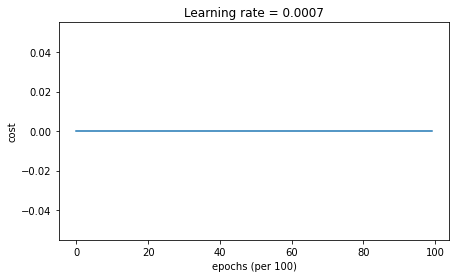

Accuracy: 0.5


AttributeError: module 'numpy' has no attribute 'arrange'

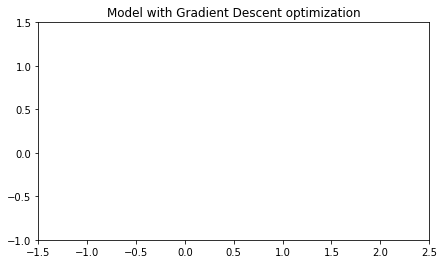

In [16]:
layers_dims = [train_X.shape[0], 5, 2, 1]
parameters = model(train_X, train_Y, layers_dims, optimizer = "gd")

# Predict
predictions = predict(train_X, train_Y, parameters)

# Plot decision boundary
plt.title("Model with Gradient Descent optimization")
axes = plt.gca()
axes.set_xlim([-1.5,2.5])
axes.set_ylim([-1,1.5])
plot_decision_boundary(lambda x: predict_dec(parameters, x.T), train_X, train_Y)

### Mini-batch gradient descent with momentum


The number of training examples is : 300

The mini-batch size : 64


 OK OK 

[[1 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 1
  1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 1 0 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0 0 0 0 1 1 1 1 0 1 1 0
  1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 0 1 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 0 1 1 0 1 1 1 0 1 0 0 0 1 1 1 1 1 1 1
  1 1 0 1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 0 0 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 0 0 1
  0 1 1 0 0 0 0 0 0 0 0 1 1 1 1 0 1 0 0 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 1 0 1 0 0 0 0 1 0 1 1 0 1 0 1 0 0 0 1 0 1 1 1 1 0 1 1 0
  1 0 0 0 0 0 0 0]]

 OK OK 

Cost after epoch 0: 0.000000

 OK OK 

[[0 0 0 0 1 1 1 0 0 0 1 1 0 1 0 1 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 1 0 0 1
  1 0 1 0 1 1 1 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 

  1 0 1 1 1 0 1 0 1 1 0 0 0 0 0 1 0 1 1 1 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 0 0 1 1 1 1 1 0 0 1 0 1 0 1 1 0 1 1 1 0 1 0 0 1 0 1 0 1
  1 0 0 0 0 0 1 1 0 0 0 1 1 0 0 0 0 0 1 1 0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 1 0 0 1 1 1 1 1 0 1 1 1 0 1 1 0 1 1 1 1 1 0 0 1 1 1 1 1
  1 0 0 1 1 1 0 0 1 1 0 0 0 1 1 0 0 1 1 1 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 1 1 0 0 0 0 0 0 1 1 1 1 0 1 1 0 0 0 0 1 1 1 0 0 1 1 1 1
  1 1 0 0 0 0 0 0 0 1 0 0 0 0 1 1 0 0 0 1 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 1 0 1 1 0 0 1 0 1 0 0 1 1 0 0 1 1 0 0 0 0 0 0 0 1 0 1 1
  1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 1 0 1 0 1 1 0 1 1 0 0 1 0 0 0 0 0 0 1 0 1 0 1 1 0 1 0 1
  1 0 0 1 0 0 0 0 1 1 1 1 0 0 1 0 0 1 1 0 0 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 1 0 1 0 1 0 0 0 1 0 1 1 1 1 0 1 0 0 1 0 0 0 0 1 0 0 0
  0 0 0 1 0 0 0 0 1 0 1 0 1 1 0 1 0 0 1 0 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 1 0 1 0 1 1 1 1 0 


 OK OK 

[[0 0 1 1 0 1 0 1 1 1 0 1 0 1 1 0 1 1 0 1 0 1 1 0 1 1 0 0 0 1 0 0 1 0 0 1
  1 1 1 1 0 1 1 0 1 0 0 1 1 1 1 1 0 1 1 0 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 0 0 1 1 0 0 1 0 0 1 0 1 0 0 0 1 1 0 0 1 0 1 1 0 0 1 1 1 0
  0 0 1 0 0 0 1 1 0 1 0 1 1 1 0 0 1 0 1 1 0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 1 1 0 0 0 1 1 1 1 0 1 0 0 0 0 0 1 0 0 1 1 1 1 1 0 1 0 0 0
  0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 1 1 0 0 0 0 1 1 0 0 1 0 0 0 1 1 0 0 1 1 0 0 0 0 1 0 1 0 0
  0 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 0 0 1 0 0 0 1 1 0 1 1 0 1 1 0 1 0 0 1 0 1 0 1 0 1 1 1 0
  0 1 0 0 0 0 0 0 1 1 0 0 1 1 1 1 0 0 1 1 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 0 1 0 0 0 1 0 0 0 1 0 0 0 1 1 0 1 0 1 0 0 0 1 1 0 0 0
  0 0 1 1 1 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 1 0 1 1 1 1 0 0 1 0 1 0 1 0 1 1 0 1 0 0 1 0 1 1 0 1 0 0
  1 0 0 1 0 1 0 1 1 0 1 1 1 0 1 

  0 0 1 1 0 1 0 0 1 1 0 0 0 1 0 1 0 1 1 1 0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 0 0 1 0 1 1 0 0 0 0 0 0 1 0 0 0 0 1 1 0 1 0 0 0 0 1 0
  0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 1 1 0 0 0 0 0 0 0 0 1 1 0 1 0 0 0 1 1 0 1 1 0 1 0 1 1 0 0
  1 0 0 0 0 0 1 0 0 0 1 0 0 1 0 0 1 0 0 1 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 1 1 0 1 1 0 1 0 1 1 0 0 0 1 0 1 0 0 1 0 0 0 1 1 1 0 0
  0 0 0 1 1 0 1 0 1 1 1 0 1 1 1 0 1 0 0 0 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 0 0 1 0 1 1 0 1 1 1 0 1 0 1 0 0 0 1 0 1 1 1 0 0 1 1 1 1
  0 1 1 0 1 0 1 1 0 0 0 0 1 0 1 0 0 1 0 1 0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 0 1 0 1 0 1 0 0 0 1 0 0 1 0 1 0 0 1 1 0 1 1 1 1 0 0 1 1 0
  1 0 0 1 1 1 1 1 1 0 0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 1 1 1 1 0 0 1 1 1 1 0 0 1 1 1 0 1 1 1 0 1 1 0 1 0 1 1 1
  1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1 0 1 0 0 0 0 1 1 1 0 0 0
  


 OK OK 

[[1 0 0 0 1 1 0 1 0 1 1 1 0 1 0 1 0 1 0 1 1 1 1 0 1 1 0 1 1 0 0 0 0 1 0 1
  0 1 0 1 1 0 1 1 0 0 1 1 0 0 0 1 1 1 1 1 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 0 0 1 0 1 0 0 1 1 0 1 0 0 1 0 1 1 0 0 1 0 0 0 1 1 0 1 1
  1 0 0 0 1 0 0 0 0 1 1 0 0 0 1 1 0 0 0 1 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 1 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1 0 1 1 0 1 1 1 0 1 1 1 0
  1 0 1 1 0 0 1 1 1 0 0 0 1 1 0 0 1 0 1 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 1 0 0 0 1 0 0 1 1 0 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0
  0 0 0 0 1 1 0 1 1 0 1 1 1 0 1 1 0 0 0 1 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 1 1 0 1 1 0 1 1 1 0 1 0 0 0 0 0 1 1 1 1 1 0 0 0 0 0 0
  0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 0 0 0 1 0 0 0 1 1 0 1 0 1 1 0 0 0 0 0 1
  1 1 1 1 1 1 0 0 1 1 1 1 0 1 0 1 0 1 0 0 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 0 0 0 1 0 1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 0 1 0 1 0 0 1 1
  0 0 1 1 1 1 0 1 1 1 1 1 0 1 1 

  0 1 1 0 0 0 0 1 1 1 0 1 1 1 1 0 1 1 1 1 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 0 0 1 0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 1 1 1 1 1 1
  1 0 0 0 1 0 0 1 1 1 0 1 1 1 0 0 0 0 0 0 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 1 1 1 0 1 1 0 1 1 1 1 1 1 1
  0 0 1 0 0 1 0 0 1 0 1 0 1 1 0 0 1 1 0 1 1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 1 1 1 0 1 1 0 1 0 0 0 0 0 0 1 0 0 1 1 0 1 0 1 0 0 0 0 1
  0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 1 1 0 0 0 0 0 1 1 0 1 0 0 1 1 0 1 1 1 1 0 1 0 0 0 1 0 1
  0 1 1 0 1 1 1 0 1 1 1 0 1 0 1 1 0 1 1 0 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 0 1 0 0 1 0 0 0 1 1 1 1 0 0 0 1 1 1 0 1 0 0 0 0 0 0 0 1
  0 1 1 1 1 1 1 1 0 0 0 0 0 1 1 1 0 1 1 1 1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 1 0 0 1 1 1 1 1 1 0 1 0 0 1 0 0 1 0 0 0 1 0 1 1 0 1 1 0
  0 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 1 1 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 1 0 0 1 0 1 1 1 1 


 OK OK 

[[0 0 0 1 1 1 1 0 0 0 0 1 1 0 1 1 0 0 0 1 1 1 1 1 0 0 0 0 0 1 1 0 0 0 0 1
  1 0 0 1 1 1 0 0 0 1 1 0 0 0 1 1 0 1 0 0 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 1 1 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 1 1 0 0 1 0 0 0 0 1
  1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 1 1 0 1 0 1 0 0 0 1 0 0 1 1 0 0 1 1 0 1 0 0 0 1 0 0 1 1
  1 1 1 0 0 0 1 0 1 1 1 0 0 1 0 1 0 0 1 1 1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 1 0 1 0 0 1 1 0 0 1 1 0 1 0 1 1 0 0 1 1 1 1 1 1 0 1 1 0
  1 1 0 0 1 0 0 0 1 1 0 1 0 0 1 1 1 0 1 1 0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 0 0 0 0 0 1 0 1 0 1 1 0 1 1 0
  0 0 0 1 1 1 0 1 1 1 0 1 0 1 0 1 0 0 0 0 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 0 1 0 0 0 1 1 1 1 0 0 0 0 1 1 1 1 1 1 1 1 0 1 0 0 0 0
  0 1 1 1 0 1 0 0 0 1 0 0 0 1 1 0 1 1 0 1 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 1 0 1 1 1 1 1 0 1 0 1 0 0
  0 0 0 1 1 1 0 0]]

 OK OK 


 

  1 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 0 0 0 1 1 0 0 1 1 1 0 0 0 1 0 1 1 1 1 1 0 0 1 0 0 0 0 0
  0 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0 0 1 1 0 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 1 1 0 1 0 0 0 1 0 0 1 1 1 1 0 0 0 0 0 0 0 1 1 1 0 0 1 1
  1 1 0 0 0 1 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 1 0 1 1 0 0 0 1 0 0 0 0 0
  1 1 1 0 1 0 0 0 0 0 1 1 1 1 1 1 0 0 1 0 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 0 1 1 0 0 1 0 0 0 1 0 0 0 1 0 0 0 1 1 1 0 1 1 0 1 0 1 0
  1 0 0 1 1 0 0 0 1 1 0 0 0 0 1 1 0 1 1 1 0 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 1 1 0 1 0 1 1 1 1 0 1 0 1 1 0 0 1 1 0 1 1 1 1 1 1 1 1 1
  1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 0 1 1 1 1 0 0 0 0 0 0 0 1 1 0 0 1 0 0 0 1 0 1 0 1 0 0 1
  1 0 0 1 0 0 1 1 0 0 1 1 1 1 1 0 0 1 1 0 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 1 0 0 0 0 1 0 0 1 1 1 0 1 1 1 0 0 1 0 1 0 1 0 0 1 0 0 0 1
  


 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 0 0 1 1 0 1 1 1 1 1 1 1 0 1 0 1 0 1
  0 0 1 1 0 1 0 0 1 0 1 1 0 1 0 1 1 1 0 1 0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 0 1 1 1 1 1 0 0 0 0 1 1 1 1 1 1 1 0 1 0 1 0 0 0 1 0 1 0
  0 0 0 1 0 1 0 0 0 1 1 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 0 1 0 1 1 1 0 0 1 1 1 0 0 1 1 1 0 1 0 1 1 0 0 1 0 1 0 0
  0 1 0 1 0 0 1 1 1 0 1 0 0 1 1 1 1 1 0 0 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 1 1 0 0 1 0 0 1 0 0 1 1 1 0 0 0 1 0 1 1 0 1 0 1 1 1 1 0
  1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 1 0 0 1 1 1 0 0 0 0 0 0 1 1 1 0 0 1 1 1 0 0 0 0 0 0 1 0
  1 1 1 0 0 0 1 1 1 1 0 1 1 1 1 0 1 1 1 1 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 0 1 1 0 0 0 1 1 1 1 0 1 0 0 0 1 1 1 1 1 1 1 1 1 0 1 0 1
  0 0 1 1 0 0 0 1 1 0 0 0 0 0 0 1 0 1 0 0 1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 0 0 0 0 1 1 1 1 1 1 0 1 1 1 0 1 0 0 0 0 1 0 0 1 1 0 0 1
  0 1 0 0 0 1 1 1 1 0 


[[0 1 0 0 1 1 0 0 1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 0 1 0 1 1 1 1 0 1 0 0
  1 0 0 1 1 0 0 0 1 1 0 0 0 1 1 1 0 1 1 1 1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 1 1 0 1 1 0 0 1 1 1 0 1 1 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0
  0 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0 1 0 0 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 1 0 1 0 1 0 0 0 1 1 0 0 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 0
  0 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 0 1 0 0 0 0 0 1 1 0 0 1 1 0 1 1 0 1 1 0 0 1 1 0 0 1 0 1
  1 1 0 0 0 1 1 0 0 1 0 0 0 0 0 1 0 0 1 0 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 1 1 0 1 1 1 0 1 1 1 0 1 0 0 1 0 0 0 0 1 1 1 1 1 1 0 1 0
  1 0 0 1 0 1 1 0 1 0 0 1 1 0 0 0 0 0 1 0 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 1 1 0 0 0 0 0 1 0 1 0 1 0 0 0 0 0 1 1 0 1 0 1 1 0 0 0 0
  1 0 1 1 0 1 1 1 1 0 0 1 1 1 0 0 1 1 0 1 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 1 0 1 1 1 0 0 0 0 1 0 0 1 1 1 1 1 0 0 1 0 0 1 1 1 1 0 0
  1 0 1 0 0 1 1 1 1 1 0 0 1 1 0 0 1 1 1 0


 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 1 0 0 0 0 0 1 0 0 1 0 1 1 0 0 0 1 1 0 0 1 0 1 0 1 1 1 1
  0 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 1 1 0 1 0 0 0 1 0 1 0 0 0 0 1 0 1 1 1 1 0 0 0 0 0 1 0 0
  0 0 1 1 0 1 0 0 0 0 0 0 1 1 1 0 0 1 0 0 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 0 0 1 0 0 1 1 0 1 1 0 1 0 1 1 0 0 0 0 0
  0 1 1 0 1 0 1 0 0 0 1 1 0 0 1 1 1 1 0 0 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 0 1 1 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1 1 1 0 1 0 1 1 0
  1 1 1 0 1 0 1 1 1 1 0 0 0 0 1 1 0 1 1 1 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 1 0 0 1 1 1 0 1 1 1 0 0 0 0 1 1 0 1 0 1 0 1 1 1 0 0 1 0
  0 0 1 0 1 1 0 1 1 1 1 1 1 1 1 0 0 1 1 0 1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 1 0 0 1 1 1 0 1 0 1 0 1 1 0 0 1 0 1 1 0 1 0 1 0 1 1 1 0
  0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 1 0 0 1 1 1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 1 1 0 0 1
  1 0 1 1 0 1 1 0 0 0 0 0 1 1 1 1 1 1 0 0 1 0 0 1 1 1 1 0]]

 


[[1 1 0 0 0 1 1 0 1 0 1 1 0 1 0 0 1 0 1 1 1 1 1 0 0 1 0 0 1 0 0 1 0 1 0 0
  1 0 0 0 0 1 1 1 1 1 0 0 1 1 0 1 0 1 0 0 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 1 0 1 1 1 1 1 1 1 1 0 0 1 1 0 0 1 0 1 0 0 1 0 0 0 1 0 1
  0 1 0 1 1 0 0 0 0 0 0 1 1 1 1 1 0 1 1 0 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 0 1 1 0 1 1 0 1 1 1 0 0 0 0 0 0 0 1 1 1 1 1 0 0 1 1 0 1
  0 0 1 0 0 1 0 1 1 1 0 0 1 1 0 0 1 0 1 0 1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 0 1 0 0 0 0 0 1 0 1 0 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 1 0
  1 1 1 1 0 0 0 1 1 1 1 0 0 0 1 1 0 0 1 0 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 0 1 1 1 1 0 0 1 1 1 0 0 1 0 1 1 1 1 1 1 0 0 0 0 0 0 0 0
  0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 1 1 0 1 1 0 1 1 1 1 0 0 1 1 0 0 1 1 0 1 0 1 0 1 1 1 0 1 0
  0 1 1 1 1 1 0 0 0 1 0 0 0 0 0 0 0 1 0 1 1 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 0 1 0 0 1 1 0 1 0 0 0 0 1 0 0 1 1 0 0 0 0
  0 1 1 1 1 0 0 0 1 0 0 1 0 1 0 0 0 1 1 0


 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 1 1 0 1 0 1 0 0 1 1 1 1 0 1 1 0 1 1 1 0 0 1 0 0 0 1 0 0
  0 1 1 0 1 1 1 0 1 1 0 1 1 1 0 1 0 1 1 1 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 1 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 1 0 1 1 1 0 0 1 0 0
  1 1 0 1 0 0 1 0 0 0 1 0 1 1 1 1 0 0 1 0 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 0 0 0 0 0 1 0 0 1 0 1 1 0 1 0 0 1 0 1 0 0 1 1 1 1 0 0 0
  0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 0 0 0 0 1 0 1 0 1 0 0 0 0 0 0 0 1 0 0 1 0 0 1 1 1 1 0 0
  1 1 0 0 1 1 0 1 1 1 1 1 0 1 1 0 0 0 1 1 0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 0 1 1 0 0 0 0 1 1 1 0 1 0 1 1 0 1 0 1 0 0 0 0 1 0 0 0 1
  1 1 1 0 1 0 0 1 0 1 1 1 1 1 1 0 0 1 1 0 1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 1 1 1 1 1 1 1 1 1 0 0 0 0 0 1 1 1 0 1 1 1 1 0 0 1 1 1 0
  1 0 0 1 0 1 0 0 1 0 0 0 1 1 0 1 1 1 0 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 0 0 0 1 0 0 1 0 1 1 0 1 1 0 1 1 1 0 0 1 0 0 0 0 1 0 1 1
  0 1 1 1 1 0 0 1 1 1 


[[0 0 1 0 1 0 0 0 0 1 0 1 0 0 0 1 0 0 1 0 1 0 0 0 1 0 1 1 0 0 0 1 0 0 0 0
  1 1 1 1 1 1 0 0 0 0 0 0 1 1 1 0 1 0 0 0 1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 1 1 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1 0 0 0 1 1 1 0 1 1 1 0
  1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 0 0 1 1 1 1 0 1 1 0 0 1 1 1 0 0 1 1 1 0 1 1 0 1 1 0 1 0
  0 1 0 0 0 0 1 1 0 0 0 1 0 0 1 1 1 0 1 0 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 0 0 0 0 1 1 0 0 1 1 1 0 0 0 0 1 1 0 1 0 1 0 1 0 1 0 0 0
  0 1 1 0 1 0 0 1 0 1 0 0 0 0 1 1 1 1 1 0 1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 0 0 0 1 1 1 1 1 0 1 0 0 1 1 0 1 1 1 1 0 1 1 1 1 1 0 0 1
  0 1 1 0 1 0 0 1 1 1 0 1 0 0 0 1 0 1 1 1 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 1 0 1 1 0 0 0 0 1 0 1 1 1 0 1 1 0 0 0 0 0 1 0 0 0 1 1 0
  0 0 1 1 1 0 0 0 0 0 0 0 1 0 1 1 0 0 0 0 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 0 0 1 0 1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 1 1 0 1 0 0 1 0
  1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[


 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 0 0 0 1 1 0 1 1 1 0 0 1 0 1 1 1 0 1
  1 0 0 0 0 1 0 1 1 0 0 1 1 1 1 1 0 1 0 0 0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 1 1 0 0 1 1 0 1 0 0 0 1 0 1 0 1 0 0 1 1 1 0 0 0 1 1 0 0
  0 0 1 1 1 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 1 0 0 1 1 1 0 1 0 1 1 0 1 1 1 1 1 0 0 0 0 1 1 1 0 0 0
  0 1 1 0 0 1 1 1 1 1 1 0 0 0 0 0 1 1 1 1 1 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 0 1 0 0 0 1 0 1 1 0 1 1 0 0 0 0 0 1 1 0 1 1 0 1 1 0 0 0
  1 1 0 1 1 0 1 0 1 1 0 1 1 0 0 0 0 0 0 0 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 0 0 1 1 1 1 0 0 0 0 0 1 0 0 1 1 0 1 1 1 0 1 0 0 0 1 0 0
  0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 0 1 1 1 0 0 1 0 1 1 1 0 1 1 1
  1 1 1 1 0 1 0 1 1 0 0 1 1 1 0 0 0 1 1 1 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 1 1 1 0 0 1 0 0 1 1 0 1 0 1 0 1 0 0 1 1 1 1 0 0 1 0 0 1 0
  0 1 0 0 1 0 0 0 1 0 


[[0 1 1 0 1 1 1 0 1 1 1 0 1 1 1 0 0 0 0 0 1 0 0 1 1 0 0 0 0 1 1 0 1 0 0 0
  0 0 1 1 0 1 0 1 1 0 0 1 0 0 1 0 1 1 1 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 1 1 1 0 1 0 0 0 0 1 1 0 1 1 0 1 1 0 1 0 0 0 0 1 0 0 0 1
  1 1 0 0 0 1 0 0 0 0 1 1 1 1 0 0 0 1 0 1 0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 1 1 0 1 0 1 1 0 0 1 0 1 1 0 1 1 0 1 0 1 0 0 0 1 0 1 1 1 0
  1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 0 0 0 1 1 0 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 0 0 1 0 0 1 1 1 0 0 0 1 0 1 0 0 1 1 0 0 0 1 1 1 1 0 1 0
  0 1 0 0 1 1 1 1 1 0 0 1 0 0 0 0 1 1 0 1 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 1 1 1 0 1 0 1 0 0 1 0 1 0 0 1 1 1 0 0 1 0 1 0 1 0 0 1 1
  1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 0 1 1 1 0 0 1 1 0 1 1 0 0 0 0 1 0 0 1 0 0 0 0 0 0 1 0 1
  0 1 1 1 1 0 0 0 0 1 1 1 1 1 1 0 1 0 0 1 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 1 0 1 1 0 1 1 1 0 0 1 0 0 0 1 1 1 1 1 0 0 0 0 0 1 0 1
  0 1 0 0 0 0 0 1 0 0 0 1 1 1 0 1 0 0 1 0


[[0 1 1 1 1 1 0 0 1 1 1 0 1 0 0 1 0 0 0 1 0 0 0 1 1 0 1 0 1 1 1 0 1 0 0 0
  1 0 1 1 0 0 0 1 1 0 0 0 1 0 1 1 1 1 0 1 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 1 1 0 0 0 1 0 0 0 0 0 1 0 1 1 1 0 0 0 1
  1 1 0 0 1 0 1 0 1 0 1 1 1 0 0 1 1 0 0 1 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 1 1 0 1 0 1 1 1 0 0 0 0 1 1 1 1 1 0 1 0 0 0 1 0 0 0 1 0
  1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 0 0 1 1 0 1 1 1 0 1 1 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1 0
  1 0 0 0 1 0 0 0 1 1 0 0 1 0 0 1 1 1 0 0 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 1 1 0 1 0 1 0 0 1 1 0 1 1 1 0 1 0 1 1 0 1 0 0 1 0 0 1
  0 1 1 0 0 0 0 1 1 1 0 1 1 1 0 1 1 0 0 0 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 0 0 0 1 0 0 1 1 0 1 0 0 1 1 0 0 0 0 0 1 1 1 0 1 0 1 1 1
  0 0 0 0 1 0 0 0 0 1 0 1 0 0 0 0 0 1 1 1 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 1 0 1 0 0 1 0 0 1 1 0 1 1 1 0 0 0 1 1 1 0 1 1 0 0 0 0
  1 1 0 1 0 1 1 0 0 0 1 1 0 1 1 0 1 1 0 1


[[1 1 0 1 1 1 1 1 0 0 1 1 1 0 1 1 0 1 0 1 0 1 1 1 0 0 0 1 1 1 0 1 1 0 0 1
  0 1 1 0 0 1 1 0 1 1 1 0 0 0 1 1 1 0 0 1 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 0 1 0 0 1 1 0 1 1 1 0 1 0 1 0 0 0 0 1 0 0 1 1 0 0 1 1 0 1
  1 1 0 0 1 0 1 0 0 1 1 1 0 1 0 0 1 0 0 1 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 0 1 0 1 1 0 1 0 1 1 1 0 0 0 1 1 1 1 0 1 0 0 0 1 0 1 1 1
  0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 1 0 1 1 1 1 0 0 0 0 1 1 0 0 1 0 0 1 1 0 1 0 1 1 0 0 0 0
  1 0 1 0 0 1 0 0 1 0 1 1 0 1 0 0 0 0 1 0 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 0 1 0 1 1 1 0 0 0 1 1 1 1 1 0 0 1 0 0 0 1 1 1 0 1 0 1 1
  1 1 0 1 0 0 1 1 1 0 1 1 1 0 0 0 0 1 0 1 1 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 0 0 0 1 1 1 1 0 0 1 1 1 0 0 1 1 0 1 0 0 0 1 0 0 0 1 1 1
  0 1 0 0 0 1 1 0 1 0 1 0 0 1 0 0 1 1 1 0 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 0 1 1 1 1 0 1 1 0 1 1 1 1 1 1 0 1 1 1 1 0 1 1 0 1 0 0 0
  1 0 0 0 0 1 0 1 1 0 0 0 0 1 0 0 1 0 0 0


[[1 1 1 0 0 0 1 0 1 1 1 1 0 1 0 0 0 1 1 0 0 1 0 1 1 1 1 0 1 0 1 1 1 1 1 0
  1 0 1 0 0 0 1 1 1 1 1 0 0 0 0 1 1 0 0 1 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 1 1 0 0 1 0 0 1 0 1 1 0 1 1 1 1 0 1 1 1 1 0 1 0 1 0 1 0 1
  0 1 0 0 0 1 0 0 0 1 0 1 1 0 1 0 0 0 0 0 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 1 0 1 0 0 1 0 0 1 0 0 0 0 0 1 0 0 1 0 1 0 0 0 1 1 1 0 1
  0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 0 1 1 0 0 0 1 1 1 0 1 1 1 1 0 1 1 0 0 1 1 1 0 0 0 0 1 1
  1 0 0 0 0 0 1 1 0 1 0 1 1 0 1 0 1 0 1 1 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 1 1 0 0 1 0 0 1 1 0 0 0 1 0 1 1 0 0 1 1 1 0 0 0 1 0 0 1
  1 1 0 0 0 0 0 0 1 1 0 1 0 0 1 1 0 0 1 0 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 0 1 0 0 0 1 0 0 0 1 0 0 1 1 1 1 0 0 1 0 1 1 1 1 1 1 1 0
  0 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 1 1 1 1 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 0 1 1 0 0 0 1 0 1 0 1 0 0 1 0 1 0 1 0 1 1 1 1 0 1 0 0
  1 0 1 1 1 0 1 1 1 1 1 0 0 1 1 0 1 1 0 1


[[1 1 0 1 1 1 0 1 0 1 0 1 0 0 1 1 1 1 0 0 1 0 1 1 0 1 1 1 0 0 0 0 1 0 0 0
  0 0 0 1 0 1 1 1 0 1 0 1 1 0 1 1 0 0 0 1 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 1 0 1 1 1 0 1 0 1 0 1 1 0 1 1 0 1 1 0 1 0 1 0 0 1 0 0
  1 1 0 0 1 0 0 1 0 0 1 1 0 1 1 1 0 1 1 0 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 1 0 0 0 0 0 1 1 0 1 0 1 0 1 1 0 0 0 0 0 0 0 1 0 0 0 1
  0 0 0 0 1 0 1 1 0 1 1 1 0 0 1 1 0 1 0 1 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 0 1 1 1 1 0 1 0 0 1 1 1 0 0 1 1 0 1 1 0 0 1 1 0 0 0 1
  0 0 0 1 0 0 0 1 1 0 0 0 0 0 0 0 1 1 1 0 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 1 0 0 0 1 1 1 0 1 0 0 0 0 0 1 0 1 0 1 0 1 1 1 1 0 1 0 1
  0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 1 1 1 1 1 0 0 1 0 0 0 0 0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 1
  1 0 0 1 0 1 0 1 1 0 0 0 1 1 1 0 1 1 1 1 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 0 0 1 0 0 1 0 1 0 0 1 0 1 0 0 1 1 0 1 0 0 0 0 0 0 1 0 1
  0 0 1 0 1 0 0 1 1 1 0 1 0 0 1 1 0 0 1 1


 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 1 0 0 1 1 1 1 0 1 0 1 0 0 0 0 0 1 1 0 1 0 1 1 1 1 0 0 0
  0 1 0 1 1 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 1 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 1 0 1 0 1 1 0 1 0 1 0 0 1 0 0 1 0 0 1 1 0 0 0 1 0 0 1 1
  0 1 0 0 1 1 0 0 0 1 0 0 0 1 1 1 1 1 1 0 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 0 1 1 1 0 1 0 1 1 1 1 1 0 1 1 0 1 0 1 0 1 1 0 1 1 0 0 1
  0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 0 0 0 1 1 0 1 0 0 1 0 0 0 0 1 1 1 0 1 0 0 1 1 0 0 0 0 0
  0 0 0 1 1 0 1 0 1 0 1 0 1 1 1 1 1 1 0 1 0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 1 1 1 1 0 0 1 1 0 0 0 1 1 0 0 1 0 1 1 0 1 1 1 1 0 0 0 1
  1 0 0 1 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 1 0 0 0 0 0 1 0 1 1 0 0 0 0 1 0 1 0 0 1 0 1 1 1 0 0 0
  0 1 1 1 0 0 0 1 1 0 0 1 1 0 0 1 0 1 1 0 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 0 1 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 1 0 0 1 0 0 1 0 1 0 0
  0 1 0 1 1 1 0 1 0 1 


[[0 0 0 0 1 0 0 0 0 1 1 0 1 0 1 0 1 0 1 1 0 0 1 0 1 0 1 1 1 0 0 1 1 1 0 0
  1 0 0 1 0 0 1 1 0 0 0 1 0 1 0 1 0 0 1 1 0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 0 1 1 1 1 1 1 1 1 0 0 1 1 0 0 0 0 1 0 1 0 0 0 1 0 1 0 1
  1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 0 0 0 0 0 1 0 0 1 1 0 1 0 0 0 0 0 1 0 1 1 0 1 1 0 1 1 0
  0 1 0 1 0 0 1 0 1 1 1 1 0 1 1 0 0 0 0 0 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 1 0 0 1 1 1 0 1 1 0 1 0 0 1 0 1 0 1 0 1 1 1 1 1 0 0 1 1
  0 0 1 0 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 1 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 1 0 0 0 0 0 1 0 0 0 1 1 0 1 0 1 1 1 0 0 1 0 1 0 0 0 1 1
  1 1 0 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 0 1 0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 1 0 0 1 0 1 0 1 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1 1 0 1 1 1
  0 0 0 0 1 1 1 1 1 0 1 1 1 1 1 0 1 1 0 1 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 0 0 1 1 0 0 0 1 0 0 1 0 0 0 0 1 0 1 1 0 0 1 0 1 0 0 0 1
  1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[


 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 1 0 0 0 0 1 1 0 0 1 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0
  0 0 0 1 0 1 0 1 1 1 0 0 1 0 1 1 0 0 1 1 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 0 1 0 1 1 0 0 0 0 0 1 1 0 0 0 0 0 0 1 1 1 1 1 0 1 0 0
  0 1 1 0 0 1 1 0 1 1 0 1 1 1 0 0 1 1 1 0 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 0 0 1 1 0 0 1 0 0 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 0 0
  1 0 1 1 1 1 1 0 1 0 0 1 1 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 1 0 1 1 0 1 0 0 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 0 0 1 1 1
  0 1 1 0 0 0 1 0 1 0 1 1 0 0 0 1 1 0 1 0 1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 0 0 0 1 1 1 1 0 1 0 0 0 0 1 1 0 1 0 0 1 1 0 0 0 0 0 1 0
  0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 0 1 1 1 0 1 0 0 1 1 1 0 0 0 0 1 1 1 0 0 0 1 0 1 1 0 1 1
  1 1 1 0 1 0 0 0 1 0 0 0 1 0 0 1 1 0 1 0 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 0 0 1 1 0 1 0 1 1 0 0 0 0 1 1 0 1 1 1 1 0 1 1 0 1 1 0 1
  0 0 0 1 1 1 1 0 0 0 



 OK OK 

[[1 1 0 0 1 1 1 1 1 0 1 0 0 0 0 1 1 1 1 0 1 0 0 1 0 0 1 1 1 0 0 1 1 0 1 0
  1 1 0 0 0 1 1 0 0 0 0 1 0 1 1 0 1 0 1 0 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 1 1 0 1 0 0 0 1 0 1 0 0 1 1 1 1 1 0 1
  0 0 1 0 1 1 1 0 1 1 0 0 1 1 0 1 1 0 0 1 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 1 1 0 1 0 0 0 0 1 1 1 1 1 1 1 0 0 1 1 0 1 1 0 1 0 0 1 1
  0 0 0 1 1 1 1 1 1 1 1 0 0 1 1 0 0 0 1 1 0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 1 1 0 1 0 0 1 1 1 0 1 1 0 0 1 0 0 1 0 0 0 1 0 1 0 1 1 0
  0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 0 1 1 0 0 1 0 1 1 0 1 1 1 0 0 0 0 0 1 0 1 1 1 0 1 1 1 0
  0 0 1 0 1 1 1 0 1 0 0 0 0 1 1 1 1 0 1 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 0 0 0 1 0 0 1 1 0 1 1 0 0 0 0 0 0 1 1 1 1 1 0 1 0 0 1
  0 0 0 1 1 0 0 1 1 1 1 0 1 1 0 0 1 1 1 0 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 1 0 0 1 1 0 0 1 0 0 0 1 1 0 1 0 0 0 0 1 0 1 0 0 0 1 1 0
  0 1 0 1 1 1 1 0 0 0 1 1 1 0 1


 OK OK 

[[0 0 1 0 0 1 0 1 1 1 1 0 1 1 1 0 0 1 0 0 0 1 0 0 0 1 0 0 0 1 0 1 0 1 0 0
  0 0 1 0 0 1 0 1 0 1 1 0 0 1 1 1 1 1 0 1 1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 1 0 1 0 0 0 0 0 0 0 1 1 1 0 1 0 0 1 0 1 1 1 1 1 1 1 0
  1 0 1 1 0 1 1 1 0 0 0 1 0 1 0 0 1 0 0 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 0 1 1 1 1 0 1 1 1 0 1 1 1 0 1 0 0 0 1 0 1 1 0 1 0 1 0 0
  0 0 0 0 0 0 1 1 0 0 1 1 1 0 1 0 1 0 0 1 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 0 1 1 0 0 0 0 1 0 1 1 1 0 1 1 0 0 0 0 0 0 0 1 1 1 0 1 1
  1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 0 0 0 1 1 0 1 0 1 0 1 1 0 1 0 0 1 0 1 0 1 1 0 0 1 0 1
  0 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0 1 0 0 1 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 1 1 0 1 1 0 1 1 1 1 0 0 0 1 1 0 0 1 0 0 1 1 1 0 1 1 1
  1 0 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 0 1 0 1 1 1 1 1 0 1 1 0 1 1 0 1 1 0 1 1 0 0 0 0 1 1 1 1
  1 1 1 1 0 0 1 1 1 1 0 1 0 1 0 

[[0 0 1 1 0 1 0 0 1 0 0 0 1 1 0 0 0 0 0 1 1 1 0 0 1 1 0 1 1 1 1 1 1 0 0 1
  1 1 0 1 1 1 1 0 0 1 1 0 0 0 0 0 1 0 0 1 1 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 1 1 0 1 0 0 0 1 0 1 0 1
  0 1 0 0 1 1 0 1 1 0 0 1 1 0 0 0 0 1 0 1 0 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 0 0 0 0 1 1 0 0 0 0 1 1 1 1 1 0 0 0 1 0 0 1 1 1 1 1 0 1
  1 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 0 0 0 0 0 1 1 1 0 0 1 1 1
  1 1 0 0 1 1 1 1 0 1 0 1 0 1 0 0 0 0 1 1 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 0 1 1 1 1 0 0 0 0 1 1 0 0 0 1 0 0 0 0 1 0 0 1 0 0 0 1 0
  0 0 0 1 0 0 1 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1 1 1 0 0 1 0 0 0 0 0 1 1 0
  1 1 1 1 0 1 1 1 0 1 0 1 1 1 0 1 1 0 0 1 1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 0 0 1 1 0 1 0 0 1 0 0 0 1 1 0 0 0 1 0 0 0 0 0 0 0 1 1 0
  1 0 1 1 1 1 0 0 1 1 0 1 0 0 1 1 0 0 0 1 


 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 1 0 1 1 1 0 1 0 0 0 1 1 0 1 1 0 1 0 1 1 0 1 0 1 0 1 1 1
  1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 0 1 1 1 1 1 0 1 0 0 1 0 1 1 1 1 0 0 1 1 0 1 0 0 0 1 0 0
  1 1 1 0 0 1 1 0 0 0 0 0 1 0 1 0 1 1 0 1 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 0 1 1 0 1 1 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 1 1 1
  0 0 0 1 0 0 1 0 0 1 1 0 0 1 1 1 1 0 1 1 0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 1 1 0 1 1 0 1 0 1 0 0 0 1 0 0 0 1 0 0 1 0 0 1 1 1 1 0 0
  0 1 0 0 1 1 0 0 1 1 0 1 1 0 1 1 1 1 0 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 0 1 0 1 1 1 1 0 1 1 0 1 1 0 1 0 1 1 1 1 1 1 0 1 0 0 0
  0 1 1 0 0 0 0 0 0 0 0 1 1 1 1 0 1 1 0 0 1 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 1 1 0 1 1 0 1 1 0 1 0 1 0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1
  0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 1 1 1 1 0 0 1 0 1 1 1 0 1 1 1 0 0 0 1 0 0 0 1 1 0 0 0 0
  0 0 0 1 1 1 1 0 1 1 1 1 0 0 1 0 0 0 1 0 1 0 0 1 1 0 0 1]]

 


[[1 0 0 1 0 1 0 1 1 0 1 1 0 0 0 0 1 0 0 0 0 0 0 0 1 1 0 1 1 1 1 1 0 0 0 1
  1 1 0 1 0 0 0 1 1 1 1 1 1 0 0 0 1 1 1 0 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 0 0 1 1 0 1 1 0 1 1 1 1 0 1 0 1 1 1 0 1 0 0 1 0 1 0 1 0
  1 0 0 1 0 0 1 1 1 0 1 0 0 0 0 1 1 1 1 0 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 1 0 1 0 1 0 0 1 1 1 1 1 0
  1 1 0 1 1 1 1 0 0 0 0 0 1 0 1 1 0 1 1 1 0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 1 1 0 1 0 0 1 0 1 0 0 0 0 0 1 1 1 1 1 1 0 0 0 0 1 0 1
  1 1 1 1 0 1 0 0 1 0 1 1 1 1 1 0 1 0 1 1 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 0 0 0 0 0 0 0 1 1 0 0 0 0 0 1 0 1 0 1 0 0 1 0 1 0 0 1
  0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 1 0 1 1 1 1 0 1 1 1 0 0 1 0 1 0 1 0 0 1 1 0 0 0 1 0 0 1
  1 0 0 0 1 0 0 0 1 0 0 0 1 0 1 1 0 1 0 0 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 1 0 0 0 0 1 1 1 1 1 1 1 0 1 0 0 1 0 1 0 1 0 0 0 1 0 0 0
  1 0 0 1 0 0 0 0 1 0 0 0 0 0 1 1 0 0 1 0

  1 0 0 0 0 0 1 0 0 0 1 0 0 0 1 1 1 1 0 1 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1 1 1 1 0 0 0 1 1 0 0 0 1 1
  0 1 1 0 0 0 0 1 0 1 0 0 0 1 1 0 0 1 1 0 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 1 1 1 0 1 0 0 1 1 0 0 1 1 1 0 0 1 0 0 0 0 0 1 0 0 1 1 0
  1 0 0 1 0 1 0 1 1 0 0 0 0 1 1 1 1 0 1 0 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 0 1 0 0 0 0 0 0 0 1 1 0 1 0 0 0 0 1 0 0 1 0 1 1 0 1 0 1
  1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 1 0 1 0 0 1 1 0 0 1 0 1 1 0 1 0 0 1 0 1 0 1 0 1 1 1 0 0
  1 1 1 1 1 1 0 1 0 1 1 0 1 1 0 0 1 0 0 1 0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0 1 0 1 0 1 0 1 0 0 0 1 1 1 1 0 1 0
  1 0 0 1 0 1 1 1 1 1 1 1 0 1 1 0 1 0 1 0 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 0 1 1 1 1 0 1 0 0 0 1 1 0 0 0 1 0 0 0 0 0 0 0 1 1 1 1 0
  1 1 0 1 0 1 0 1 0 0 1 0 0 0 0 1 1 1 1 1 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 1 1 0 1 1 1 1 1 1 

  0 0 1 1 0 0 0 0 1 1 0 1 0 0 1 0 0 1 0 0 0 1 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 1 1 0 1 0 1 0 0 0 0 1 0 0 0 1 1 0 0 0 0 1 1 1 0 1 1 0 0
  1 0 1 1 0 1 1 1 0 1 1 1 0 0 0 1 1 0 0 1 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 1 1 1 0 0 1 1 0 0 1 1 0 0 1 0 1
  1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 1 1 0 0 0 1 0 0 1 1 0 0 0 1 0 1 0 1 0 1 0 1 1 0 0 0 0 0
  0 0 1 0 0 0 1 1 1 1 0 0 1 0 1 0 1 1 1 0 1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 0 0 1 1 1 1 1 0 0 1 1 1 1 0 1 1 0 0 0 0 1 0 1 1 0 0 1 1
  1 0 1 1 0 0 0 0 0 0 1 0 0 1 0 1 0 0 0 1 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 0 1 1 0 0 1 0 0 0 0 1 1 1 1 1 0 1 0 0 1 1 1 0 1 1 1 0 1
  0 0 1 0 1 0 1 0 1 1 0 1 0 0 1 1 1 0 1 1 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 1 1 0 1 1 1 1 0 0 1 0 1 0 1 1 0 0 0 1 0 1 1 1 1 1 0 1 1
  0 0 0 0 1 0 1 1 1 1 0 0 1 1 1 1 1 0 0 1 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 0 0 1 1 1 1 1 1 1 

  1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 1 0 1 0 0 0 1 1 0 0 1 0 0 1 1 0 0 0 1 0 1 1 1 1 0 0 1
  1 0 0 1 1 0 0 0 1 1 0 0 0 0 0 0 0 0 1 1 0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 0 0 1 0 0 0 0 0 0 0 1 1 0 1 1 0 1 0 1 1 1 1 0 1 0 1 1
  0 1 1 0 0 1 0 0 0 1 1 0 0 1 0 0 1 0 1 0 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 0 0 1 0 0 0 0 1 0 1 1 1 0 1 1 0 1 0 0 1 0 1 0 0 0 1 1
  0 1 0 0 1 1 1 1 1 0 1 0 0 1 1 1 1 0 1 1 1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 0 0 1 0 1 1 1 1 0 1 1 1 0 1 1 0 1 0 1 0 1 0 0 0 0 1 1 1
  0 0 1 0 1 0 0 0 0 0 0 1 1 1 1 0 0 1 1 0 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 0 1 0 1 1 1 1 0 0 1 0 1 1 1 1 1 1 0 1 0 0 0 0 1 0 1 1 0 1
  0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 0 0 0 0 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 0 1 1 1 0 1 0 0 0 1
  0 1 1 0 0 0 0 1 1 0 1 0 1 1 1 0 1 0 1 0 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 1 1 1 0 0 1 1 0 0 0 1 0 0 0 1 1 0 1 0 1 0 1 1 1 0 0 1 0 1
  

  1 1 1 1 0 1 1 0 0 1 0 1 1 0 0 0 1 1 0 0 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 0 1 0 0 0 1 0 0 0 0 0 0 0 1 0 1 1 0 0 1 0 1 1 0 1 1 0 1
  1 1 1 1 0 0 1 1 1 1 1 1 0 0 1 0 0 0 1 0 1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 0 1 0 1 1 0 1 1 1 0 0 1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 1 1
  1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 0 0 0 1 0 1 1 1 0 0 0 1 1 0 0 0 1 1 1 1 1 0 0 1 1 0 1 0
  1 0 1 0 0 1 1 1 0 0 0 0 1 1 1 1 0 1 1 0 1 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 0 0 0 1 0 1 1 1 0 1 1 0 1 1 1 1 1 0 0 1 0 1 1 1 0 1 1 1
  0 0 0 0 0 0 0 1 1 1 1 0 0 0 1 1 1 1 0 0 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 1 0 1 0 1 0 0 0 0 1 1 0 1 1 1 1 0 1 0 0 0 1 0 0 0 0 0 1
  1 1 0 0 1 1 0 1 1 0 0 0 0 1 1 0 0 1 1 0 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 1 1 1 0 1 1 1 1 0 1 0 1 0 1 1 1 0 1 0
  1 0 0 0 1 1 1 0 0 1 1 1 0 1 1 1 1 1 0 1 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 1 0 0 1 0 0 1 0 0 


 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1 1 1 0 1 0 1 0 0 1 1 0 0 0 1 1 0 1 0 0
  1 1 1 0 0 0 1 1 0 0 1 0 0 1 0 1 1 0 0 0 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 0 0 1 0 1 1 1 0 1 0 1 0 0 1 0 0 0 0 1 0 1 1 0 1 0 0 1 0
  1 0 0 1 1 1 1 1 0 1 0 0 0 0 0 1 1 1 0 0 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 0 1 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 1 0 0 0 0 1
  0 0 1 1 1 0 0 1 1 1 0 0 1 1 0 1 1 0 1 1 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 0 0 0 0 1 1 0 1 1 1 1 0 0 0 0 0 1 1 0 0 1 0 1 1 0 0 1 1
  1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 1 1 1 1 1 0 1 1 0 0 1 1 0 1 1 0 0 0 0 1 1 1 0 0 0 0 0 0
  1 1 1 1 0 0 1 1 1 0 0 1 0 1 1 1 0 0 1 0 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 1 1 1 1 1 1 0 1 1 0 0 0 0 1 1 0 0 0 1 1 1 1 1 1 0 1 0 0 1
  1 1 1 0 1 0 0 0 1 1 0 1 1 1 1 0 1 0 1 1 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 0 0 1 0 0 1 1 0 1 0 0 1 0 1 0 0 0 0 1 1 1 1 1 0 0 0 0 1
  0 1 0 1 1 0 0 1 1 0 


[[0 0 0 0 0 1 0 1 0 1 0 1 1 1 1 0 0 0 0 0 1 1 1 0 1 1 1 0 1 0 1 0 1 1 1 0
  1 0 0 1 0 1 0 1 0 1 0 0 0 1 1 1 1 1 0 1 1 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 0 1 1 0 0 0 0 1 0 0 0 1 0 0 1 0 1 1 1 0 0 1 1 0 0 1 0 0 0
  1 0 1 1 1 0 1 1 0 1 0 0 0 1 0 0 1 0 1 1 1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 0 1 0 1 0 1 1 0 1 1 0 0 0 0 1 0 1 1 1 1 0 1 1 1 0 1 0 0
  1 1 0 0 1 1 1 1 1 0 0 0 0 0 0 0 1 1 1 0 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 0 0 1 1 0 0 1 1 1 0 1 0 0 1 1 0 1 0 1 1 1 1 0 1 0 1 1 0
  0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 1 0 0 0 1 1 0 0 1 0 0 0 1 0 1 1 0 1 0 1 0 0 1 1 0 1 1 0
  1 0 1 1 1 1 1 0 1 0 0 0 1 1 0 0 1 0 0 1 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 1 1 1 1 0 1 1 1 0 0 0 1 0 0 1 0 1 1 1 0 0 1 0 0 0 0 1
  0 0 1 1 1 0 0 1 0 1 1 1 1 0 0 1 1 0 1 1 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 0 0 1 1 1 0 0 0 1 1 1 1 1 0 0 1 1 1 1 0 0 1 0 1 1 1 1 1
  0 1 0 1 0 1 1 0 1 1 1 0 1 0 0 0 1 0 0 0

  0 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 1 1 0 0 1 1 1 1 0 1 1 0 1 0 1 1 0 0 0 0 1 1 1 1 0 1 1 0
  1 0 0 1 0 1 1 1 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 1 0 1 1 0 1 0 0 1 1 1 0 1 1 1 1 0 1 1 1
  0 0 1 1 0 0 0 1 1 1 0 1 0 0 0 0 0 0 1 1 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 0 1 1 0 1 0 0 0 0 1 1 0 1 1 1 0 0 0 1 0 0 0 0 0 0 0 0 1
  1 0 0 0 0 1 1 1 0 0 0 0 0 1 1 0 1 1 0 1 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 0 0 0 1 1 1 0 1 1 0 0 1 0 1 0 0 1 0 0 1 0 0 1 1 0 1 0 1
  0 1 0 0 1 0 1 1 0 1 1 0 1 0 0 1 0 0 0 1 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 1 0 0 1 0 0 0 1 1 1 1 0 0 1 0 1 1 0 1 1 1 0 0 1 1 0 0 1
  0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 1 1 0 1 0 1 0 1 1 0 1 0 0 0 1 1 1 0 0 1 1 0 0 1 1 1 1 0
  0 0 1 1 1 0 0 0 1 0 1 0 1 1 0 0 1 1 0 1 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 1 1 0 1 1 1 1 0 1 0 1 0 1 0 0 1 1 0 1 0 0 0 1 1 0 1 1 1
  

  1 1 1 1 0 0 1 0 1 1 1 1 1 0 0 1 1 1 0 0 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 0 0 0 1 0 1 0 0 1 1 1 0 0 1 1 1 1 0 1 0 1 1 0 0 0 1 0 0
  1 0 1 1 1 1 1 1 1 1 1 0 0 0 0 0 1 1 1 0 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 0 1 1 1 1 0 0 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 0 0 1
  0 1 0 0 0 1 0 1 0 1 1 0 1 1 1 1 0 1 1 1 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 1 0 0 0 1 0 0 0 0 0 1 0 1 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1
  1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 1 0 0 1 1 0 0 0 0 1 0 1 0 1 0 0 1 0 0 0 1 0 1 1 1 1 1 1
  1 0 1 0 0 1 1 0 1 1 1 0 0 1 0 1 0 1 1 1 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 0 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 0 0 1 0 1 1 1 0 0 1 1
  0 0 1 1 0 1 0 0 0 1 0 1 0 1 1 0 1 1 0 0 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 1 0 0 0 1 0 1 1 0 0 1 0 0 0
  1 0 1 0 0 0 0 0 1 0 0 0 0 0 0 1 1 1 1 1 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 1 1 1 1 1 0 1 1 


 OK OK 

[[0 1 0 1 0 1 0 1 1 0 0 0 1 1 1 0 1 0 0 1 0 1 1 0 0 0 0 0 1 1 1 1 1 1 1 0
  0 1 1 1 1 0 0 0 0 0 1 0 1 0 1 1 0 1 1 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 1 1 1 1 0 1 0 1 0 1 0 0 0 0 0 0 1 1 1
  1 0 0 0 0 1 1 1 0 1 0 0 0 0 0 1 0 1 0 1 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 0 1 0 1 1 1 0 1 0 0 0 0 0 0 0 1 1 1 0 0 1 1 1 0 0 0 1 0
  1 1 0 0 0 1 1 0 1 0 0 1 0 1 1 1 1 0 0 0 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 0 0 0 1 0 1 0 1 1 0 0 0 1 1 1 0 1 1 1 0 1 0 0 1 0 1 1 0
  1 1 1 1 1 0 1 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 1 1 1 1 1 1 0 0 1 0 0 1 1 0 1 0 0 0 1 0 0 1 1 1 1 1 1 1
  0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 0 1 0 0 0 1 0 0 1 0 1 0 1 1 0 0 1 1 1 1 1 0 0 1 0 1 0 1
  0 0 1 0 1 1 1 0 0 0 0 0 1 0 0 0 0 1 0 1 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 1 1 1 0 0 0 0 1 1 0 1 1 1 1 1 1 1 0 1 0 1 0 0 1 0 1 1 0
  0 0 0 0 0 0 1 0 1 1 1 0 1 0 0 


[[1 0 1 1 0 0 1 0 1 1 1 1 0 1 0 0 1 0 1 0 0 1 1 0 0 0 1 1 1 0 0 0 0 1 0 0
  0 0 1 0 1 1 0 1 0 1 0 1 1 0 0 1 1 1 1 1 0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 1 0 1 0 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 1 0 0 0 0 0 1 1 1
  1 1 0 1 0 1 0 1 0 0 1 1 0 0 1 0 1 1 0 0 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 0 1 1 1 0 1 0 1 1 0 0 0 0 0 1 0 0 0 0 0 1 0 0 1 0 0 1 1
  0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 0 0 1 1 1 0 0 1 1 0 0 0 0 0 1 0 0 1 0 1 1 0 1 0 0 0 0 0
  1 1 0 1 1 0 1 1 1 1 1 0 1 1 1 1 0 1 0 0 0 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 0 0 0 0 1 0 1 1 1 1 0 1 0 0 1 0 0 0 1 1 0 1 1 1 0 1 1 1
  0 1 1 1 0 0 1 1 1 0 0 0 1 0 0 0 0 1 0 0 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 1 0 0 0 0 1 1 0 0 0 0 1 1 0 0 1 0 0 1 0 1 0 1 1 1 1 1 0 0
  0 0 0 0 1 1 1 1 0 1 1 0 0 1 0 0 1 0 0 0 1 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 0 1 1 1 1 0 1 1 1 0 1 0 0 1 1 1 0 0 1 1 1 0 0 0 0 1 1
  0 1 1 0 1 0 1 0 1 0 1 1 0 0 0 0 1 1 1 0

  1 0 1 1 0 0 0 1 1 1 1 1 0 0 0 0 0 1 0 1 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 0 0 1 1 1 0 0 0 1 0 0 1 0 0 1 1 1 0 0 1 0 1 1 0 1 0 0 0 1
  0 0 1 0 1 0 0 0 1 0 0 1 1 1 1 1 1 1 1 0 0 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 0 0 0 0 1 1 0 0 0 1 1 1 1 1 1 0 1 0 1 0 0 1 1 0 1 0 0 1
  0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 0 1 1 0 0 1 1 1 1 0 0 1 1 0 0 1 0 0 0 1 0 0 1 0 1 1 1 1
  0 1 0 1 1 0 0 0 0 0 1 0 0 1 1 1 1 0 1 0 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 1 1 0 0 0 0 1 0 0 1 0 0 1 1 1 0 1 1 0 1 1 0 0 1 0 1 1 0
  1 0 0 0 1 0 0 0 1 1 0 0 0 0 0 0 1 0 1 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 0 0 0 0 1 1 0 0 0 1 1 1 1 0 0 0 0 1 0 1 0 0 0 1 0 0 1
  0 1 0 1 0 1 0 0 1 1 1 0 1 0 1 1 0 0 1 0 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 1 1 1 0 0 1 1 0 1 0 0 1 1 1 1 0 1 0 1 0 0 0 0 1 1 1 0 1
  0 1 0 1 0 1 1 1 1 1 1 0 0 0 0 0 1 0 1 0 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 0 0 0 0 1 0 0 1 1 

  1 1 1 0 1 1 1 0 0 1 0 0 1 0 1 0 0 1 1 0 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 1 0 1 1 1 0 1 0 1 0 0 0 0 0 1 0 1 1 0 0 1 0 0 0 1 0 0 0
  0 0 0 1 0 0 0 1 1 0 1 1 1 1 1 0 1 1 0 0 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 1 1 0 0 1 1 0 1 0 0 0 1 1 1 0 1 0 1 1 0 0 0 1 0 0 0 1
  0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 0 1 1 1 0 1 1 0 1 0 1 1 0 0 0 1 0 0 0 0 1 0 0 1 1 1 0 1
  0 0 1 0 1 1 0 1 0 0 1 0 1 1 0 1 0 0 0 1 1 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 0 1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 1 0 0 1 0
  0 1 1 0 0 0 0 0 1 0 0 1 1 1 1 0 1 1 1 1 1 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 1 0 1 1 0 1 1 1 1 1 0 0 1 1 0
  1 1 0 1 1 0 0 1 0 1 0 1 0 0 0 1 0 0 1 0 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 0 0 1 0 1 1 1 0 1 0 1 0 0 1 0 0 1 1 0 1 0 1 1 0 1 0 1 1
  0 1 1 1 1 0 1 0 0 0 0 1 1 1 0 1 0 1 1 1 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 1 1 0 1 1 0 0 1 1 


 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 0 1 1 0 1 1 0 1 1 0 0 1 1 0 1 0 0 0 1 0 0 1 0 1 1 1 1
  0 1 1 1 1 0 0 1 1 0 1 0 1 1 1 0 0 0 0 0 1 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1 0 0 0 1 1 1 0 0 1 1 0 0 0 0 0 1 1
  0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 0 0 1 0 1 1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 0 1 1 1 0 1 1 1 0 0 0 0 1 1 1 0 0 0 0 1 0 0 1 0 0 1 0 1
  0 0 1 0 1 0 1 1 0 0 1 1 0 0 0 0 1 1 1 0 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 1 1 1 1 1 1 0 1 0 0 1 0 0 0 0 1 1 0 1 1 0 1 1 0 0 0 1 1 1
  0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 0 0 0 0 1 0 1 1 1 1 1 1 0 1
  0 1 1 0 0 0 0 1 0 0 0 1 1 0 0 0 0 1 1 0 0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 1 0 1 0 0 1 1 0 1 1 0 1 1 1 0 1 1 0 1 0 0 1 1 1 0 0 1 1 0
  0 0 0 0 1 1 0 0 0 1 0 1 1 1 0 0 0 0 0 0 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 1 1 1 0 0 1 0 1 0 1 1 1 0 0 0 1 0 0 1 1 1 1 0 1 1 1 1 0 1
  0 0 1 0 0 0 1 1 0 1 


 OK OK 

[[0 0 0 0 1 0 0 0 1 0 1 0 0 1 1 0 0 0 1 0 1 0 1 1 0 1 0 0 0 0 1 1 1 1 1 1
  0 0 0 0 1 1 0 0 0 0 1 1 1 0 1 1 1 1 0 1 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 0 1 0 1 1 0 1 0 1 1 0 0 0 0 0 0 1 1 0 1 0 1 0 0 0 0 0 1
  0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 0 1 1 0 0 0 1 0 1 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 1 0 1 1
  0 0 0 1 0 1 0 0 1 1 1 1 0 1 0 1 0 0 0 1 0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 1 0 1 1 1 1 0 1 0 0 1 1 0 0 0 1 0 0 0 0 0 1 1 1 1 1 1 0 1
  0 1 1 1 0 1 1 0 1 0 0 0 1 1 1 0 0 1 0 1 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 1 0 0 1 1 1 0 0 1 0 1 0 0 1 1 1
  1 1 0 1 1 0 1 0 1 0 1 1 0 1 1 1 0 1 1 1 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 0 0 1 1 1 0 0 0 1 1 0 1 1 0 1 1 1 1 1 0 0 1 0 1 1 1 0 1
  0 0 0 1 1 0 0 1 0 1 1 0 1 0 0 1 1 0 0 1 0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 1 0 0 0 1 0 0 1 1 1 1 1 1 1 0 0 0 1 1 0 1 1 1 0 1 0 1 0
  0 1 0 0 1 0 1 0]]

 OK OK 


 

  1 0 0 1 1 1 0 1 1 1 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 1 1 0 1 1 0 1 0 0 0 0 0 0 1 1 0 1 0 0 0 1 0 0 1 1 0 1 1
  0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 0 0 1 1 1 0 1 0 1 1 1 0 1 0 1 1 1 1 0 0 1 0 0 1 1 1 0 0
  0 1 0 0 0 0 0 0 1 0 1 1 1 0 0 0 0 0 0 1 1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 1 1 1 1 1 1 0 1 1 1 1 0 0 1 0 0 1 0 0 0 0 0 1 1 0 0 0 0
  0 1 1 1 0 1 0 1 1 1 1 1 0 1 0 1 1 0 1 0 1 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 1 0 0 1 0 0 1 0 0 1 1 0 0 1 0 0 0 1 1 0 0 1 1 1 0 0 0 0 0
  1 1 0 1 1 1 0 1 1 0 0 0 0 0 0 0 1 1 1 0 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 1 0 1 0 1 1 0 1 1 1 0 0 0 0 1 0 1
  0 0 1 1 1 0 0 1 0 0 1 1 1 1 0 0 1 0 0 1 1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 1 1 0 0 1 1 0 0 0 1 0 1 0 0 0 1 0 0 1 0 1 1 0 1 1 1 0 1
  0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 1 1 1 0 0 0 0 0 1 1 0 0 0 1 1 0 0 0 0 0 1 1 1 0 1 1 1 1
  

  1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 1 1 1 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 1 1 1 1 0 1 1 1 1 0 1 1 1 0 0 0 0 0 1 1 0 1 0 1 1 1 1 0 1
  0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 0 0 1 1 0 0 1 1 1 0 1 0 1 1 0 0 1 0 1 1 1 1 1 0 0 1 1
  1 1 1 0 0 1 0 0 1 1 0 0 1 1 0 1 0 0 0 1 1 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 1 1 0 1 1 0 0 0 1 1 1 0 1 0 0 0 1 0 0 0 1 1 1 0 0 1 0 1 0
  0 0 0 0 0 0 0 0 0 1 1 1 0 0 0 1 1 0 0 0 1 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 1 0 1 1 1 1 0 1 1 1 0 0 0 0 0 1 0 0 1 1 1 1 1 1 1 0 1 1 1
  0 0 0 1 1 1 1 1 1 0 0 0 0 1 1 1 0 0 1 1 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 1 0 1 0 1 0 1 0 1 1 1 1 0 1 1 1 1 1 1 1 0 0 1 0 1 0 1 0
  0 1 0 1 0 0 0 0 0 0 1 0 1 1 0 1 1 1 1 0 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 0 1 0 0 1 1 0 1 0 0 1 0 1 1 0 1 1 1 1 1 0 1 0 1 1 1 1
  0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 1 1 0 0 1 1 0 0 0 1 1 1 1 0 0 1 0 1 0 0 1 0 1 1 0 0 0 0
  


[[0 0 0 1 0 0 1 0 0 1 1 0 1 0 0 1 0 1 0 0 0 0 0 1 1 1 1 1 0 1 0 1 1 1 0 0
  1 1 0 0 1 1 1 1 0 0 0 1 1 1 1 1 1 1 0 1 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 1 1 1 0 1 0 0 1 1 1 0 1 0
  0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 0 0 0 1 0 0 1 0 1 0 0 0 0 1 0 1 1 1 0 0 0 1 1 0 1 0 0 1 1
  0 1 1 0 1 0 1 0 0 1 0 0 1 0 0 1 0 0 1 0 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 1 1 1 0 1 1 0 1 0 0 1 0 0 1 1 0 0 1 0 1 0 0 1 0 1 1 0
  0 0 1 0 1 0 1 0 0 0 1 1 0 1 1 0 1 0 0 0 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 1 0 0 1 1 1 0 0 0 1 0 0 1 1 1 1 0 1 1 1 0 0 0 0 1 1 0 1
  0 0 0 1 0 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 0 0 1 1 0 0 0 0 0 0 1 0 1 1 1 0 0 1 0 0 0 1 1 1 0 0 0 1
  0 0 0 1 1 0 1 0 1 1 1 0 1 0 1 0 1 1 1 1 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 0 0 1 0 0 1 1 1 1 1 0 1 1 0 1 0 1 0 1 1 0 0 0 1 1 0 1 0
  0 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[



 OK OK 

[[1 1 0 0 1 1 1 0 1 0 0 0 1 1 1 1 0 0 0 0 1 0 0 1 1 0 0 1 1 1 0 1 1 1 1 1
  1 1 1 0 0 0 0 0 1 1 0 1 1 0 0 0 0 0 0 1 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 0 1 0 0 1 0 0 0 1 0 0 0 0 1 0 1 0 0 1 1 0 0 0 1 0 1 0 0
  1 0 0 1 1 0 0 1 1 1 0 1 1 0 1 1 0 1 0 0 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 1 1 1 1 0 0 1 0 1 0 0 1 1 1 1 1 0 1 1 0 0 1 1 1 1 1 0
  1 1 1 0 0 0 1 1 0 0 1 1 0 0 0 0 1 1 0 1 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 0 1 0 1 0 1 0 0 0 0 1 0 0 0 1 1 0 0 0 0 0 0 1 0 1 0 0 0
  0 0 0 1 0 0 0 1 1 0 1 0 1 0 0 0 1 1 1 1 1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 0 0 0 0 1 1 0 1 1 0 0 1 1 0 1 0 1 1 0 0 1 0 0 1 0 1 1 0
  1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 0 0 1 0 1 1 1 0 0 1 0 0 1 1 0 0 0 1 1 1 0 1 0 0 0 1 1
  0 0 0 1 0 1 0 1 1 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 1 1 1 0 1 1 0 1 0 1 1 1 0 0 0 0 0 0 1 0 1 0 0 0 1 1 1 1
  1 0 1 0 0 1 1 1 1 0 1 1 0 1 0


 OK OK 

[[1 0 0 1 0 1 0 0 1 0 0 0 0 0 0 1 1 0 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0 1 1 1
  1 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 0 0 1 1 1 0 1 0 1 1 0 0 0 1 1 0 1 1 1 1 1 0 0 0 1 0 0 0
  0 0 0 0 0 1 0 0 0 1 1 1 0 1 0 1 1 0 1 0 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 0 1 1 1 1 1 0 0 1 1 1 0 1 1 1 1 1 0 1 1 0 1 1 0 1 1 0
  0 0 1 1 1 1 1 0 1 1 0 0 1 0 0 1 0 0 1 0 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 1 1 0 0 1 0 1 1 0 1 1 0 0 0 0 1 1 1 1 0 0 1 1 1 0 0 0 1
  1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 0 1 0 1 1 1 0 1 1 1 0 1 0 0 1 1 1 1 1 0 0 1 1 1 1 0 1 1
  0 0 1 1 1 1 0 0 1 1 0 1 1 0 0 1 0 0 1 1 1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 0 1 0 1 0 0 1 0 1 1 1 0 1 0 1 1 0 1 1
  0 0 0 0 0 1 0 0 1 1 0 1 0 0 0 1 1 1 0 0 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 1 1 0 0 0 1 0 1 1 1 1 0 1 0 0 0 0 0 0 1 1 1 0 0 1 0 1 1
  1 0 1 0 1 1 0 0 0 1 1 1 0 1 1 

  1 1 1 1 1 0 1 1 0 0 1 1 1 0 1 0 1 0 1 0 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 1 1 0 0 1 0 1 0 0 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 0 1 0 1
  0 1 0 1 0 0 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 1 1 0 0 1 0 1 0 0 1 1 1 1 0 0 1 0 0 0 0 0 0 0 1 0 1 1 1
  0 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 1 0 0 1 0 0 1 1 1 1 1 1 1 1 1 1 0 1 1 1 0 1 1 1 0 0 1 0
  0 0 1 1 1 0 1 1 1 1 1 0 1 1 1 0 0 0 0 1 0 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 0 0 0 0 0 0 1 1 0 1 1 0 0 1 0 1 1 0 0 0 0 0 1 0 1 1 0
  0 0 1 1 1 0 1 1 0 0 1 1 0 0 0 0 1 1 0 0 0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 0 1 1 0 0 0 0 1 0 1 1 1 0 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1
  0 1 0 1 0 0 0 0 0 0 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 1 1 1 0 1 1 1 1 0 0 1 1 1 0 1 0 1 1 0 0 0 0 0 1 1 0 1 0
  1 0 0 0 1 1 0 1 1 0 0 1 1 1 1 0 1 0 0 0 1 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 1 0 1 0 1 0 0 1 1 1 

  1 1 0 1 1 1 1 1 1 1 0 1 1 0 0 0 1 1 0 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 0 1 1 1 0 1 1 1 0 0 1 1 1 0 0 0 0 1 0 0 1 0 1 0 0 1 0 0
  1 1 0 0 1 1 1 0 0 0 1 1 0 0 0 1 0 1 1 1 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 1 1 0 0 0 0 0 1 0 1 1 0 1 0 1 1 0 0 1 1 1 0 0 0 0 1 1 0
  1 0 1 0 0 0 0 1 0 0 0 1 0 1 1 0 0 1 0 1 1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 0 1 0 1 1 1 0 1 1 1 1 0 1 0 1 0 0 1 1 1 0 0 1 0 1 0 1 1 0
  0 0 1 1 1 0 0 1 1 0 0 1 0 1 0 0 0 1 0 1 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 0 0 1 1 1 0 1 0 0 0 0 1 1 1 0 0 0 0 1 1 0 1 1 0 0 0 0 0
  1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 1 0 0 1 1 0 1 1 1 1 0 1 0 1 1 0 0 0 1 1 0 1 1 0 0 1 1 0
  0 1 0 0 1 1 1 0 0 0 1 0 1 0 1 1 0 1 1 0 0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 0 0 0 1 1 1 0 1 0 0 1 1 0 1 1 1 0 1 0 0 0 1 0 1 1 1 0 1
  0 0 0 0 0 0 1 0 1 0 1 1 1 0 1 1 0 1 0 0 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 1 0 0 1 0 0 1 0 1 


[[1 1 1 0 1 1 0 1 0 1 0 0 0 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 1 0 1 1 1 0 1 0
  0 1 1 0 0 1 0 0 1 0 0 0 1 0 0 0 1 1 0 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 0 0 0 0 1 0 0 0 0 0 1 1 0 0 1 0 1 1 0 1 0 0 1 0 0 1 0 1
  0 1 0 0 0 1 0 1 0 0 1 1 0 1 1 1 0 0 1 1 1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 1 1 0 1 0 1 0 1 1 0 0 0 1 1 1 1 1 0 1 0 0 1 0 1 1 0 0 1
  0 0 0 1 0 0 0 1 1 1 1 1 0 1 0 1 0 1 0 0 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 0 0 1 0 0 0 1 1 1 0 0 0 0 0 0 1 0 1 1 0 0 1 1 1 0 1 0 1
  1 0 1 0 0 0 0 1 0 0 1 0 0 1 0 1 0 0 1 1 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 0 1 1 1 1 0 1 1 1 0 1 1 0 1 1 0 0 1 1 1 1 0 1 1 1 0 1 1
  0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 1 1 1 0 0 0 1 0 0 1 0 0 0 1 0 0 0 0 0 1 0 1 1 1 0 0 1 0
  0 0 1 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 1 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 0 1 0 0 0 1 1 0 1 1 0 1 0 1 0 0 0 1 1 1 1 0 1 1 1 1 1 0 0
  0 0 1 0 1 0 1 0 1 0 1 0 1 1 1 1 0 1 1 0


 OK OK 

[[0 1 0 1 0 1 0 1 1 0 1 0 1 1 0 1 0 1 1 1 1 0 0 1 1 0 0 1 0 0 0 0 0 1 0 1
  1 0 1 0 0 0 1 0 0 1 0 1 1 0 1 0 1 0 0 0 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 1 0 1 0 0 1 0 0 0 1 0 0 0 0 0 0 1 1 0 1 1 0 1 1 0 0 0 1
  1 1 1 1 0 0 1 1 1 1 0 0 0 0 0 1 1 0 0 1 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 0 1 0 1 1 0 0 0 1 1 1 0 0 1 0 1 1 1 0 1 0 0 1 1 0 0 1 1
  0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 0 0 0 0 1 1 0 1 1 1 0 0 1 1 1 0 0 1 1 0 1 1 1 1 0 0 1 0
  0 0 0 0 0 0 1 0 0 1 1 0 1 0 0 1 1 0 0 1 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 0 1 1 1 1 0 0 0 1 1 1 1 1 0 1 1 0 1 1 1 1 1 1 0 0 0 0 0
  0 1 0 1 1 0 0 1 1 1 0 1 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 1 1 0 1 0 0 0 0 0 0 1 0 0 1 1 1 1 1 0 1 1 0 0 1 0 1 1 0
  1 1 0 1 0 0 1 0 0 1 1 1 0 0 0 1 0 1 0 0 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 1 1 1 0 1 0 1 1 1 1 0 1 0 0 1 0 0 1 1 0 1 0 1 1 1 0 1 0
  0 0 0 1 1 0 1 1 0 1 0 1 1 1 1 

  1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 1 1 1 1 0 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 0 0 0 0 0 1 0 0 1 0 0 1 0 0 0 0
  0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 0 1 1 1 1 1 0 0 1 1 1 1 0 0 0 0 0 1 1 0 1 1 0 1 0 0 1 1
  0 1 1 0 0 0 1 1 0 0 1 1 0 0 0 1 0 1 0 1 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 0 1 0 0 0 0 0 1 0 0 1 0 0 0 0 1 1 0 1 0 1 0 1 0 0 0 1 1
  0 0 1 1 1 1 0 0 1 0 0 1 0 0 0 0 0 1 0 1 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 1 0 0 1 0 1 0 0 1 0 0 1 0 0 1 1 1 0 0 1 1 1 1 1 0 1 0 1
  1 0 1 0 1 0 0 1 0 0 0 0 1 1 0 1 0 0 1 0 0 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 0 1 1 1 0 1 0 1 0 1 1 0 1 1 1 1 1 1 0 1 0 0 1 1 0 0 1 1 0
  0 0 1 0 0 1 0 1 1 0 0 0 1 1 1 1 0 1 0 1 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 1 1 1 1 0 1 0 1 0 1 0 1 0 0 1 1 0 0 0 0 0 1 1 1 0 1 1
  1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 0 1 1 1 1 1 0 0 1 1 1 0 1 1 0 1 0 0 1 1 0 0 1 1 0 0 0 0 0
  


 OK OK 

[[0 0 1 0 0 1 1 1 0 0 0 1 0 0 1 1 0 0 1 0 0 0 1 1 0 0 0 1 0 1 1 1 1 0 1 1
  0 0 0 0 1 1 0 1 0 0 1 1 0 1 1 1 0 0 0 1 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 0 0 1 1 0 1 1 0 0 0 0 0 1 0 1 1 0 0 0 1 1 1 1 0 0 0 0 1
  0 1 1 1 1 0 1 1 1 0 1 0 0 1 0 1 1 1 0 0 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 1 0 0 0 1 1 1 0 0 0 1 0 1 0 1 1 1 1 1 0 1 0 1 1 0 0 0 1
  1 1 1 0 0 1 1 1 1 1 1 1 0 1 0 1 1 1 0 0 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 1 1 0 1 1 0 0 0 0 1 0 0 1 0 0 0 0 0 0 1 1 0 0 0 1 0 0 1
  0 1 1 0 0 0 1 0 0 0 1 0 0 1 1 0 0 1 1 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 0 0 0 1 1 0 0 0 1 0 1 0 1 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1
  0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 0 1 1 0 0 1 0 0 0 1 1 1 0 1 1 0 0 1 1 0 1 0 0 1 0 0 0 0
  1 1 0 0 1 0 0 1 0 0 0 0 1 1 1 0 1 1 1 0 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 0 0 0 1 1 1 0 0 1 1 0 0 0 1 0 1 0 1 0 0 1 0 0 1 0 1 1 1
  1 0 0 1 0 0 0 1 0 0 0 0 1 1 1 

  1 0 0 1 1 1 1 0 1 0 1 1 1 0 1 0 0 0 1 1 0 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 1 1 0 0 1 0 0 0 0 0 0 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 0 1
  1 1 0 0 1 0 1 0 0 0 1 0 0 1 0 1 1 1 0 1 0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 0 0 1 0 0 0 1 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1 0 1 1 0 1 1 0
  0 0 0 1 1 0 0 1 1 0 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 1 0 1 0 0 1 0 1 0 0 1 1 0 1 1 0 1 0 1 0 0 1 0 0 0 1 1 1
  1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 1 1 0 1 0 1 1 0 0 1 0 0 1 1 0 1 1 1 1 0 1 1 1 0 1 1 1 1
  0 1 1 1 1 0 0 1 1 0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 0 0 1 0 1 1 1 0 1 1 0 1 0 1 1 0 1 0 0 1 1 0 0 1 0 0 0 1
  0 1 0 1 0 1 0 1 1 0 1 0 0 0 0 0 1 0 1 0 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 0 0 1 0 1 0 0 0 0 0 1 1 1 1 0 0 0 0 1 0 1 1 1 0 0 1 0 0
  0 1 1 1 0 1 0 1 1 1 1 0 0 1 0 0 0 0 1 1 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 0 1 1 1 0 0 0 0 0 


 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 1 1 0 1 1 0 0 0 1 0 0 0 0 0 0 0 1 1 1 1 1 0 0 0 0 0 0 0
  0 1 0 0 1 0 1 1 1 0 0 1 0 0 1 0 0 1 1 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 0 1 1 1 0 1 1 1 1 1 0 0 0 0 0 1 0 0 1 1 1 1 1 0 0 0 1 0
  1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 0 0 1 0 1 1 1 1 0 0 1 1 1 1 0 1 1 0 0 1 1 1 1 0 0 0 1 0
  1 1 0 0 1 1 1 1 0 0 0 0 0 1 0 0 0 1 1 0 1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 1 1 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 1 1 0 0 0 0 1 0 0 1
  0 1 1 0 1 1 1 0 1 0 0 0 1 0 0 1 1 1 0 0 1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 0 0 1 0 1 0 0 0 1 0 1 1 0 1 1 1 0 1 0 1 1 1 0 0 0 1 0 0 0
  1 0 1 1 1 1 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 0 0 1 1 0 0 1 1 1 1 0 1 0 1 1 0 1 1 0 1 0 1 0 1 0 1 0 0
  0 0 1 1 1 1 1 1 0 0 1 0 1 1 1 0 0 0 1 0 0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 0 1 1 0 1 1 1 0 1 1 1 1 0 1 1 0 0 1 0 0 1 0 0 1 0 0 0 0
  1 1 0 0 1 0 0 1]]

 


[[1 0 0 0 1 0 1 0 0 1 1 0 0 0 1 0 1 1 1 1 1 1 0 0 1 1 1 0 1 1 0 0 0 0 1 0
  1 0 0 0 0 1 0 0 1 0 1 0 0 1 0 1 0 1 0 1 0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 0 1 0 1 1 0 1 1 0 0 0 1 0 0 0 1 1 0 0 1 1 0 0 0 0 1 0 1
  1 0 0 1 0 1 0 1 0 1 0 0 0 1 0 0 0 0 0 0 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 1 0 1 0 0 1 0 1 1 0 1 1 1 1 1 0 0 1 1 1 1 1 1 1 1 1 0
  1 0 1 0 0 1 0 1 1 1 0 0 1 0 1 0 0 1 1 0 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 0 1 1 0 0 1 1 1 1 0 1 0 1 1 0 0 1 0 0 0 0 0 1 0 1 1 0 1
  0 0 1 1 1 1 0 1 1 1 1 1 1 0 0 0 1 1 1 0 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 0 0 0 1 1 0 1 1 1 1 1 0 1 0 0 1 0 0 0 0 1 0 1 0 1 0 0 0 1
  0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 0 1 0 1 0 1 0 0 0 0 1 0 1 1 1 0 1 0 1 1 0 0 0 1 0 0 1 1
  0 0 0 0 1 1 1 0 0 1 0 1 1 0 0 0 0 1 1 0 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 0 1 1 1 1 0 1 0 0 1 1 1 0 1 1 0 0 1 1 1 0 1 1 1 0 1 0 1
  0 0 1 1 0 1 0 1 1 0 0 1 1 0 0 1 1 0 1 0

  1 1 0 0 1 1 1 0 1 1 0 0 0 1 0 1 0 1 1 1 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 1 0 0 1 0 0 1 0 1 1 1 0 0 0 1 1 1 0 0 1 1 1 1 0 1 0 1 0 1
  1 0 1 0 0 0 1 0 1 0 1 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 0 1 1 0 1 0 0 1 0 0 1 0 1 1 0 1 1 0 0 0 1 0 0 1 0 1 0 0
  1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 1 0 0 1 0 0 1 1 1 1 0 1 1
  0 0 1 1 1 1 1 0 0 1 0 1 1 0 1 0 1 1 1 0 0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 0 1 0 1 0 0 0 0 1 0 0 1 1 0 0 1 0 0 1 0 1 1 1 1 0 1 0 0
  0 1 1 0 0 1 1 1 0 0 0 1 0 1 1 1 1 1 1 1 0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 1 0 1 0 1 1 0 1 1 0 0 0 0 0 1 0 1 0 1 0 1 1 1 1 0 0 1 0
  0 1 1 1 0 0 0 1 1 0 1 0 1 0 0 1 1 0 1 1 0 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 1 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1 1 1 1 1 1 1 1 1 0 1 0 1
  0 0 0 0 0 1 1 1 0 1 1 1 0 1 0 0 0 0 1 1 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 0 0 1 1 1 1 0 1 0 



 OK OK 

[[1 1 1 0 0 1 0 1 0 1 0 1 0 0 0 0 1 0 1 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0
  0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 1 0 0 1 1 0 1 0 0 1 1 0 1 0 0 0 1 1 0 0 0 0 0 0 0 1 1
  1 1 1 0 1 1 1 1 1 1 1 0 1 1 1 0 0 0 1 0 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 1 1 0 1 1 0 1 0 1 0 1 1 0 1 0 0 0 1 0 0 1 1 1 1 0 0 0 0
  0 0 1 1 1 1 1 0 0 0 0 0 1 0 0 1 0 1 1 1 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 1 1 1 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 1 1 0 1 1 0 0 1 1
  0 1 0 1 0 1 0 1 0 0 0 1 1 1 0 0 0 1 0 0 0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 0 1 0 0 1 1 1 0 0 0 0 0 1 0 0 0 1 0 1 1
  0 0 1 1 1 0 0 0 1 1 1 1 0 0 0 1 0 1 0 0 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 1 1 1 0 0 0 0 1 0 0 1 0 1 1 0 1 0 0 1 1 0 1 1 1 1 1 1
  1 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 1 0 1 0 0 1 1 0 1 0 1 1 1 0 1 1
  0 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 1 1 0 1 0 1 1 0 0 1 1 1]]

 OK OK 





[[1 1 0 1 1 0 0 1 1 1 0 0 0 0 1 1 1 0 1 1 0 0 0 0 0 1 1 1 1 1 1 0 1 1 1 0
  1 0 0 1 1 1 1 0 0 1 0 0 0 1 0 1 0 1 1 0 1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 1 1 0 1 0 0 1 0 1 0 0 0 1 1 1 1 0 0 1 0 0 0 0 1 1 1 1 0
  0 1 0 0 0 0 1 1 0 1 1 0 0 0 0 1 1 0 0 1 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 1 0 1 1 0 0 0 0 0 0 0 1 1 1 1 0 0 1 0 1 0 0 0 0 0 1 1 1
  1 0 0 0 1 1 0 1 1 0 0 0 0 1 0 0 0 0 1 1 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 1 0 1 0 1 1 1 1 1 1 1 0 0 0 0 0 0 1 1 1 0 0 1 1 0 1 0
  0 1 1 1 1 1 0 0 0 0 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 0 1 1 0 1 0 0 1 0 1 0 0 1 0 1 0 0 1 1 0 0 0 0 0 0 0 1 1
  1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 0 0 0 0 0 1 1 0 1 0 0 0 0 1 0 0 1 1 0 0 0
  0 1 0 0 1 0 0 0 1 0 1 0 1 0 0 1 0 0 1 1 0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 0 1 1 0 0 1 0 1 1 0 1 1 1 1 0 1 0 1 1 1 0 0 1 0 1 1 0 0
  0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0


[[1 1 0 1 0 0 1 0 0 1 1 0 1 0 0 1 0 1 1 1 0 1 0 0 1 1 0 0 0 0 0 1 0 1 0 1
  0 0 0 1 1 1 0 0 0 1 1 1 1 0 1 1 1 1 1 1 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 1 0 1 0
  0 1 0 1 0 0 1 0 0 0 0 1 0 1 1 1 0 0 0 1 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 1 1 0 0 0 1 1 0 0 0 1 0 1 1 0 1 0 1 0 1 0 0 1 0 1 0 0 0
  0 0 1 0 1 1 0 0 0 1 0 1 0 0 0 1 0 1 1 0 1 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 0 1 0 1 0 0 0 1 1 0 0 1 1 1 1 1 1 1 1 0 0 1 1 0 0 0 1 0
  1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 0 0 1 1 0 1 1 0 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0 0 1 1 0 1
  0 0 1 0 0 1 1 0 0 1 0 0 0 1 0 1 1 0 1 1 1 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 1 1 1 0 0 1 0 1 1 1 0 1 1 0 0 0 1 0 1 1 1 1 0 0 0 0 0 1
  0 1 1 1 1 0 0 1 0 0 0 0 1 0 1 1 1 0 1 0 1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 0 1 0 1 1 0 0 1 1 0 1 0 0 0 0 1 0 1 1 0 1 1 1 1 1 0 0 1
  1 1 0 0 1 1 0 1 0 0 0 0 1 0 0 1 0 0 1 1


 OK OK 

[[1 0 0 1 0 1 0 1 0 1 1 0 1 1 1 0 1 0 0 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0 0 0
  0 0 0 1 0 0 1 0 1 1 0 1 0 1 0 1 0 0 0 0 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 0 1 0 1 0 1 1 1 0 1 0 1 1 1 1 1 1 0 0 1 0 0 0 1 1 1 1 0
  0 0 1 1 1 1 1 0 1 1 0 0 1 1 0 0 0 0 0 1 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 0 1 0 0 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 0 1 0 1 1 0 0 0 0
  0 0 1 1 0 1 1 1 1 1 1 1 0 0 1 0 0 1 0 1 0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1 1 1 0 1 0 1 0 1 0 1 1 1 1
  0 0 1 1 0 1 1 0 1 1 1 0 0 1 0 1 1 1 1 0 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 0 1 1 1 1 1 1 0 0 0 0 0 1 0 1 0 0 0 1 1 0 0 0 0 1 0 0 0
  0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 0 1 0 1 1 0 0 1 0 1 0 0 0 0 0 0 1 1 0 1 1 0 0 1 0 0 0 0
  1 0 0 1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 1 0 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 1 1 0 1 1 0 0 1 0 1 1 0 1 1 0 1 0 0 0 1 1 0 1 0 1 1 0 1
  1 0 1 0 1 0 0 1 1 0 1 0 1 0 0 


[[0 1 1 0 1 0 1 0 1 0 0 1 0 0 0 1 0 0 0 0 1 0 1 0 0 0 1 1 1 0 1 0 1 0 1 1
  1 0 1 0 0 0 0 1 1 1 1 0 0 0 0 0 0 1 1 0 0 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 1 0 0 1 0 1 1 1 1 1 1 1 0 0 1 0 0 1 1 0 0 0 1 1 0 0 0 0
  1 0 1 0 0 1 0 1 0 1 0 1 0 0 1 1 0 0 0 0 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 1 0 0 1 0 0 0 0 1 0 1 1 1 0 0 1 1 1 1 0 1 1 1 1 0 0 0 0
  1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 0 1 1 0 1 1 0 1 1 0 0 0 0 0 1 1 0 0 0 1 1 0 0 0 1 1 0 0
  1 1 1 0 0 1 1 0 1 1 1 1 1 1 0 0 0 0 0 1 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 0 1 1 0 1 0 1 1 0 0 0 1 0 1 0 1 1 1 0 0 0 0 1 0 0 0 1 0
  1 0 1 1 1 1 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 0 0 0 1 0 0 1 1 1 1 1 1 0 1 1 0 0 1 1 0 1 1 1 0 0 1 0 0
  0 0 0 0 1 1 0 1 1 1 1 1 0 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 1 1 0 0 1 1 0 1 1 0 0 0 1 1 0 0 0 1 1 1 1 1 0 1 1 0 1 1
  0 0 1 1 1 0 1 1 1 1 1 1 0 1 0 1 0 0 0 1


[[1 0 0 0 1 0 0 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 0 0 1 0 1 1 0 0 1 0 1 1
  0 0 0 1 0 0 1 1 0 1 0 0 0 1 1 1 0 0 0 1 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 1 1 0 0 0 0 1 1 0 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 0 0 1 0 0
  1 0 0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 0 0 1 1 0 0 0 0 1 1 0 0 1 1 1 0 1 1 1 0 0 0 0 0 0 0 0 1 0
  1 0 1 0 1 1 0 1 0 0 1 1 1 1 1 1 0 1 0 1 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 0 1 0 1 1 0 0 1 1 0 1 0 1 1 1 0 1 0 1 0 0 1 1 1 1 0 1 0
  0 1 0 1 0 1 1 0 1 1 1 1 1 0 0 0 1 0 1 0 1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 1 1 1 0 0 0 0 1 1 0 0 0 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 0
  0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 1 1 0 0 0 1 1 1 1 1 1 0 0 0 1 0 0 1 0 1 1 1 1 1 1 0 1 0
  1 1 1 1 1 0 0 0 1 0 1 1 0 1 0 1 0 1 0 0 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 1 1 1 0 1 1 1 0 0 0 1 0 0 1 0 1 1 1 1 0 0 1 1 1 1 1 1 1
  1 0 0 0 0 1 0 1 0 0 1 1 1 0 0 0 0 1 0 1


[[0 0 1 1 1 0 1 1 0 0 0 1 1 0 1 0 1 1 1 1 0 1 1 1 0 0 1 0 1 1 0 0 1 1 1 1
  0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 0 0 1 1 1 1 0 1 1 0 0 1 0 0 1 1 1 1 0 1 0 1 0 0 0 1 1 1 1
  0 0 0 1 0 1 1 1 0 1 1 0 0 1 0 1 1 0 0 0 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 0 0 1 0 1 1 1 0 1 1 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 0
  1 0 0 1 1 1 0 0 0 0 1 1 0 0 1 1 1 1 0 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 0 1 0 1 0 1 1 0 0 1 1 1 0 0 1 1 0 1 0 1 1 1 1 0 0 1 0 0
  1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 0 0 0 1 0 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 0 1 1 1 1 0 1 1 1 1 0 1 0 1 1 0 0 0 1 0 1 1 0 0 0 0 0 1
  0 0 1 1 1 0 1 1 1 0 0 1 1 1 1 0 0 0 0 0 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 1 1 1 0 1 1 0 1 0 0 1 1 1 1 0 0 1 0 0 0 0 1 1 0 1 0 0 0
  0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 0 1 1 1 0 0 1 0 0 0 0 1 0 1 1 1 1 0 0 1 0 1 1 0 0 0 0 1
  1 1 0 1 0 1 0 0 1 1 0 0 0 0 1 0 1 0 1 0 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[

  1 0 0 0 1 0 0 1 0 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 0 1 1 0 0 0 0 1 0 0 1 0 0 0 1 1 0 1 1 0 0 0 0 0 1 1 0 1
  1 1 1 0 0 1 0 1 0 1 1 1 0 1 0 0 0 0 1 1 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 0 0 0 1 0 0 1 0 1 1 0 0 0 1 0 1 1 0 1 1 0 0 0 1 1 1 0 0
  0 0 0 1 1 0 0 1 1 1 1 1 1 0 0 1 1 1 0 1 0 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 0 1 0 0 0 1 0 1 0 1 1 0 0 1 1 1 1 0 0 0 0 0 1 0 1 0 1 0
  1 0 1 0 0 1 1 1 0 1 1 0 1 1 0 1 1 1 1 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 0 0 1 1 1 1 0 1 1 0 1 1 0 0 1 0 0 0 1 1 1 1 1 0 1 1 0 0
  0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 1 1 1 1 0 0 0 1 0 0 0 0 0 1 0 1 1 1 0 0 0 0 1 1 1 1 0 1
  0 0 1 0 0 0 1 0 0 1 1 0 1 0 1 1 1 0 0 1 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 0 0 1 1 1 0 0 0 0 1 0 0 1 0 0 1 0 1 1 0 1 0 0 1 0 1 0 0
  1 1 1 0 1 0 0 0 1 1 1 1 1 0 0 0 1 1 1 1 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 0 0 0 1 0 0 0 1 


[[0 0 0 0 1 0 0 1 0 0 0 0 1 1 1 1 1 0 1 0 1 1 1 0 1 0 1 1 1 1 0 1 1 0 1 0
  1 1 1 0 1 0 1 1 1 0 1 1 1 1 0 1 0 0 0 0 0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 1 0 1 1 1 1 0 0 0 1 1 0 1 1 1 1 1 0 0 1 1 0 1 0 0 1 0 1
  1 0 1 0 1 0 0 1 0 1 1 0 0 0 1 1 1 1 1 1 0 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 0 1 0 0 0 1 0 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 0 0 1 0 0 1
  0 1 0 1 1 1 0 0 1 1 0 1 1 1 0 0 1 0 1 0 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 0 1 0 0 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 0 1 1 0 0 0 0 1
  1 1 0 0 1 1 1 1 1 1 0 1 0 0 0 0 0 0 1 1 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 0 1 0 0 1 1 0 0 0 0 0 1 0 0 1 0 0 0 0 1 0 0 1 0 0 1 0 0
  1 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 1 0 0 0 1 1 0 0 0 0 1 0 0 1 0 1 1 0 1 0 0 1 1 0 0 1 1 0
  1 0 1 1 1 1 1 0 1 0 0 0 0 0 1 1 0 0 1 1 1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 1 0 0 0 0 1 1 0 0 1 1 1 1 0 0 0 1 1 0 1 1 0 0 0 0 0 0 1
  1 1 0 0 0 1 1 0 1 0 1 1 1 0 0 0 1 1 0 0

  1 0 0 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 1 0 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 0 0 1 1 1 0 0 1 1 1 0 1 0 1 1 0 0 1 1 0 0 0 1 0 1 0 0 1
  0 1 1 0 1 1 1 0 0 1 1 0 1 1 0 1 1 0 0 1 0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 0 1 0 1 0 0 0 0 0 1 1 0 0 0 0 1 1 1 1 1 0 0 0 0 1 1 0 1
  0 0 1 1 0 0 0 0 1 1 1 0 1 0 0 1 1 0 0 0 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 1 1 0 1 1 1 1 1 1 0 1 1 0 0 0 0 1 1 1 1 1 0 1 1 1 0 1 1
  1 0 1 1 1 0 1 1 1 1 0 0 0 1 0 0 1 0 1 0 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 0 1 0 1 0 0 1 0 1 0 0 0 1 0 0 0 0 1 1 0 0 1 0 1 0 0 1 1 0
  0 1 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 1 1 0 0 0 1 1 0 1 1 0 0 0 0 1 0 0 1 1 0 0 1 1 0 1 0 1 0
  1 0 1 0 0 1 1 0 1 1 0 1 1 0 0 0 0 1 0 0 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 1 0 1 0 0 1 1 0 0 0 0 0 1 0 1 1 1 1 1 0 0 0 1 1 1 0 1 1
  1 0 0 0 1 1 0 1 1 1 1 1 0 0 1 1 0 1 0 1 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 1 1 0 1 1 0 1 0 0 



 OK OK 

[[1 0 1 0 1 0 1 0 1 1 0 0 0 0 0 0 1 0 0 0 0 1 1 1 0 0 0 0 0 0 0 0 1 0 0 0
  0 1 0 1 1 1 0 0 0 1 1 1 0 0 1 0 0 1 0 1 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 0 1 0 1 0 0 0 1 1 1 1 0 0 1 0 0 1 0 0 1 1 1 1 1 1 1 0 1
  0 1 0 1 0 0 1 1 1 0 0 1 1 1 1 0 0 1 1 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 1 1 0 0 1 0 0 1 1 1 1 0 0 0 0 1 0 0 0 1 0 1 1 0 1 0 0 0 1
  0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 1 0 1 1 1 0 0 1 0 1 1 0 1 0 0 1 1 0 1
  0 0 0 1 1 1 1 1 1 0 1 0 0 0 0 0 0 1 1 0 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 1 1 1 1 0 1 0 1 0 0 1 0 0 0 1 0 1 1 0 1 1 0 0 1 1 1 0 1
  0 0 0 1 0 1 1 0 0 1 0 0 1 1 0 1 0 0 1 1 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 1 0 1 1 0 1 1 1 0 0 0 0 1 0 0 1 1 1 0 0 0 0 1 0 1 0 0 1
  1 0 0 0 1 1 1 0 1 0 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 0 0 0 1 1 0 1 0 0 0 1 0 1 0 1 0 1 0 0 0 1 1 0 0 0 0 1
  1 0 1 0 0 0 0 0 0 1 0 1 0 0 1


[[1 0 0 1 0 0 0 0 0 0 1 0 0 0 0 1 1 1 0 0 1 1 0 1 1 0 0 1 1 0 0 0 0 1 0 0
  1 0 1 1 1 1 0 0 0 0 0 1 0 0 0 1 1 1 0 0 1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 1 1 0 1 0 1 0 1 0 0 0 0 1 1 0 1 0 0 1 0 0 1 0 0 1 0 1 0
  1 0 1 1 1 0 1 0 1 0 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 1 1 1 1 0 1 1 1 1 1 0 1 1 0 0 1 1 1 0 1 0 1 1 0 1 1 0 1 1
  0 0 0 0 0 1 0 1 0 1 0 1 1 1 1 0 0 1 1 1 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 0 0 1 0 1 0 0 1 1 0 0 0 0 1 0 1 1 1 0 0 1 0 0 1 0 1 0 0
  0 1 0 0 1 1 0 0 1 0 1 0 1 0 0 1 1 1 0 0 1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 0 0 1 1 1 1 1 1 1 0 0 1 1 1 0 1 0 0 0 1 1 1 1 0 0 0 1 0
  0 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 1 0 0 1 0 1 1 1 0 0 0 0 0 0 0 1 1 0 1 0 0 1 0 1 1 1 1 0
  1 1 0 1 0 1 0 1 0 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 1 1 0 1 0 0 0 1 1 1 0 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 0 1
  1 1 1 1 1 1 1 0 1 0 1 1 0 0 1 1 0 0 1 0

  1 1 1 1 0 0 0 0 0 0 1 0 1 1 0 1 1 1 1 1 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0 1 1 0 0 1 0 0 0 0 1 0 0 1 1 0
  1 0 1 0 0 1 0 1 0 1 1 0 1 1 1 0 1 0 0 0 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 1 0 0 1 1 1 0 1 0 0 0 0 1 1 1 1 0 0 0 0 1 0 0 1 0 1 0 0
  1 0 1 0 0 0 0 0 0 0 1 0 0 1 0 1 1 0 0 1 0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 0 0 1 0 1 1 1 0 1 0 1 0 0 1 0 0 0 0 1 0 1 1 0 1 0 1 1 0
  0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 0 1 1 1 0 0 1 1 0 0 0 0 1 1 1 0 0 1 0 0 0 0 1 0 0 0 0 1
  1 1 1 1 1 1 0 0 0 1 0 0 0 0 1 0 1 0 0 1 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 0 0 0 1 0 0 1 1 1 1 1 0 1 0 0 1 0 1 1 0 0 0 0 1 1 0 0 1
  1 1 1 1 0 1 1 1 1 1 0 0 0 0 0 1 0 1 1 0 1 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 1 1 0 0 0 1 0 0 0 0 0 1 0 1 1 1 0 0 1 1 1 0 0 1 1 1 1 1
  1 1 1 0 1 1 1 1 0 1 0 0 1 0 1 0 1 0 0 0 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 1 0 1 1 0 1 0 1 1 


 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 1 0 0 0 1 0 1 0 1 0 1 1 0 0 0 0 0 1 0 0 0 1 1 1 0 1 0 0
  1 0 0 0 1 0 0 0 1 1 0 1 1 0 1 0 1 0 0 0 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 0 1 0 1 0 1 1 1 0 1 1 1 1 1 0 0 1 1 0 1 1 1 1 1 0 1 0
  0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 0 1 0 1 1 0 1 0 1 0 0 1 1 1 1 0 1 1 0 0 0 0 1 0 0 1 0 0 0
  1 1 0 1 0 1 1 1 0 0 0 0 1 1 0 1 0 1 1 0 1 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 0 0 1 0 1 0 0 0 0 0 0 0 1 1 1 1 0 0 1 1 0 1 0 1 0 1 0 0 0
  1 0 0 1 0 0 0 1 0 1 1 1 1 1 0 0 1 1 1 0 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 1 1 0 0 0 1 0 1 1 1 0 1 0 0 0 0 0 1 1 0 1 0 1 1 0 1 1 1 0
  1 1 0 1 1 1 1 0 1 1 0 0 1 0 1 0 0 0 1 0 1 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 0 1 1 0 1 1 1 1 1 1 0 1 1 0 1 0 0 1 1 1 0 0 1 0 0 1 0 0
  0 1 1 0 0 1 0 1 1 0 1 0 1 1 1 0 1 1 1 0 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 0 0 0 1 1 1 1 0 0 0 1 0 1 0 1 0 1 0 0 0 0 1 0 1 0 1 0
  1 1 0 1 1 1 0 0]]

 

  0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 1 1 0 1 0 0 0 0 1 1 0 1 1 0 1 0 1 0 1 1 1 0 1 1 1 0 0 0 1
  0 1 1 1 0 1 0 1 1 0 0 0 0 0 0 1 1 1 1 0 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 0 1 0 0 1 0 1 0 0 1 0 0 0 1 1 0 0 1 1 0 1 0 1 1 0 0 1 1
  0 0 1 0 1 1 0 1 0 0 0 0 1 1 1 1 0 1 0 1 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 1 1 1 0 0 0 1 1 1 0 0 0 0 1 1 1 1 1 1 0 1 1 0 1 0 1 0 1
  0 0 1 1 0 1 0 0 1 1 0 0 0 1 1 1 0 1 1 0 0 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 0 0 1 1 1 1 1 1 1 0 1 1 0 0 1 0 0 0 0 0 1 0 1 0 0 0 1 0
  1 1 1 1 1 0 0 0 0 1 0 0 1 1 1 0 1 1 1 0 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 0 0 1 0 0 0 0 1 0 0 1 0 1 0 0 0 1 0 1 1 0 0 1 1 0 0 1 0
  1 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 1 0 0 0 0 1 0 0 0 0 1 1 1 1 0 0 1 1 1 0 0 0 1 0 1 1 0 1 0
  1 1 0 0 0 0 1 0 0 1 1 0 1 1 1 0 0 0 1 0 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 0 1 1 0 0 0 0 1 1 0 1 0 0 1 1 0 1 1 0 1 0 1 1 1 1 1 0 1
  


[[1 0 1 1 1 1 0 0 1 1 1 0 0 0 1 0 1 0 0 0 1 1 1 0 1 0 0 1 0 1 0 1 0 0 0 0
  1 1 0 1 1 1 0 0 1 1 0 0 1 0 0 1 1 0 0 1 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 1 1 0 0 0 0 0 1 1 0 0 0 1 1 1 0 1 1 1 0 0 0 1 0 1 0 0 0 0
  0 1 1 1 1 1 0 1 1 1 1 0 0 0 1 0 1 1 1 1 0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 0 0 0 0 0 1 0 0 1 1 1 1 0 1 1 0 1 1 1 0 1 0 1 1 0 1 1
  0 1 0 1 1 0 1 1 1 1 0 0 0 0 0 0 1 0 1 1 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 0 0 0 1 0 0 1 1 0 0 1 1 0 1 0 1 0 0 0 1 0 0 1 0 0 0 0 0
  1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 0 0 0 0 0 1 0 1 1 0 0 0 0 1 1 0 1 0 0 0 1 0 0 0 1 1 0 1
  0 1 0 0 1 1 1 1 1 0 0 1 1 1 1 1 0 0 1 1 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 1 1 1 1 0 1 0 0 1 0 1 1 1 1 1 0 1 0 1 1 1 0 0 1 0 1 0 1 0
  0 1 1 0 1 1 0 1 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 0 1 1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 1 1 1 1 0 1 0 1 0 0
  1 1 0 1 1 0 1 0 1 0 0 0 1 1 0 0 0 0 1 1


 OK OK 

[[0 1 1 0 0 1 1 1 0 1 0 1 1 0 1 0 1 1 1 1 1 1 0 1 0 1 0 1 0 1 1 1 1 0 0 1
  1 0 0 1 1 1 1 0 1 1 0 1 1 1 0 1 0 0 0 0 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 1 1 1 0 1 0 0 0 1 1 0 0 0 1 1 0 1 1 1 1 0 0 1 0 0 0 0
  0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 1 0 0 1 1 1 0 0 0 1 1 1 0 0 0 0 0 1 0 1 1 1 0 0 0 0 0 0 0
  0 0 1 0 1 1 1 1 1 0 1 0 0 0 1 1 0 0 0 1 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 1 0 0 1 1 0 0 0 1 0 0 1 1 0 0 0 1 1 0 0 1 0 0 0 0 1 0 1
  0 1 0 0 0 1 1 1 1 0 1 0 1 0 1 0 1 1 1 0 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 1 0 1 0 0 1 0 1 1 0 1 1 1 1 1 1 1 1 0 1 0 0 0 1 1 0 0 0
  1 0 0 1 1 0 0 0 0 0 1 1 0 1 0 1 1 1 1 0 0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 1 1 1 0 1 0 0 1 1 1 1 1 1 1 0 0 1 0 0 0 0 1 1 1 0 1 0 1
  1 0 1 0 0 1 1 1 0 0 0 0 1 0 0 1 0 0 0 1 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 1 1 0 1 1 1 1 0 1 0 0 0 1 1 1 0 1 1 0 1 1 1 1 0 1 1 0 0
  0 0 0 0 0 1 0 0]]

 OK OK 


 

[[0 0 1 1 1 1 0 0 0 0 0 1 1 0 0 1 1 0 0 0 0 1 1 1 0 1 1 1 0 0 1 0 1 1 1 0
  1 0 0 1 0 0 1 0 0 0 1 0 0 0 1 1 0 0 1 1 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 1 0 1 0 1 1 1 1 0 1 0 0 1 1 1 0 1 1 1 0 0 0 0 0 1 1 0
  1 0 0 1 0 0 1 0 0 0 1 1 0 1 1 0 1 0 0 0 1 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 1 1 1 1 1 0 1 0 1 1 0 1 0 1 1 1 0 0 0 0 0 0 1 0 0 1 0 0
  0 0 0 0 0 1 1 0 1 0 0 0 1 1 0 0 1 0 1 0 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 1 1 0 1 1 0 1 0 0 1 1 1 0 0 0 1 0 0 0 0 0 1 1 0 0 1 1 1
  1 0 1 0 0 1 1 0 1 0 0 1 1 0 1 0 1 0 1 1 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 1 1 1 0 0 0 0 1 0 1 1 1 1 1 1 0 0 1 0 0 0 1 0 1 1 1 0 1
  1 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 1 0 0 0 0 1 1 1 0 0 1 1 0 0 0 0 1 1 0 0 0 0 0 1 0 0 0 0
  0 1 1 1 0 1 1 0 0 1 0 1 0 1 1 0 0 0 1 0 0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 0 0 1 0 0 0 1 1 0 1 1 0 1 0 1 0 1 0 1 1 1 1 1 1 1 1 0
  1 0 1 1 0 1 1 1 0 0 1 1 1 1 1 1 1 0 0 0 

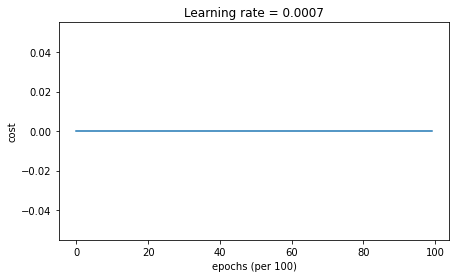

Accuracy: 0.5


AttributeError: module 'numpy' has no attribute 'arrange'

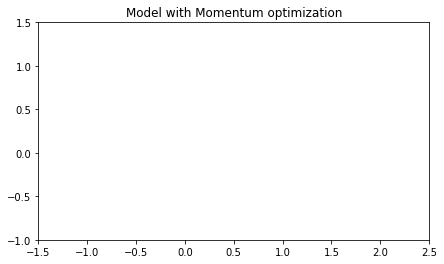

In [17]:
layers_dims = [train_X.shape[0], 5, 2, 1]
parameters = model(train_X, train_Y, layers_dims, beta = 0.9, optimizer = "momentum")

# Predict
predictions = predict(train_X, train_Y, parameters)

# Plot decision boundary
plt.title("Model with Momentum optimization")
axes = plt.gca()
axes.set_xlim([-1.5,2.5])
axes.set_ylim([-1,1.5])
plot_decision_boundary(lambda x: predict_dec(parameters, x.T), train_X, train_Y)

### Mini-batch with Adam mode


The number of training examples is : 300

The mini-batch size : 64


 OK OK 

[[1 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 1
  1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 1 0 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0 0 0 0 1 1 1 1 0 1 1 0
  1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 0 1 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0 1 0 1 1 0 1 1 1 0 1 0 0 0 1 1 1 1 1 1 1
  1 1 0 1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 0 0 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 0 0 1
  0 1 1 0 0 0 0 0 0 0 0 1 1 1 1 0 1 0 0 0 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 1 0 1 0 0 0 0 1 0 1 1 0 1 0 1 0 0 0 1 0 1 1 1 1 0 1 1 0
  1 0 0 0 0 0 0 0]]

 OK OK 

Cost after epoch 0: 0.000000

 OK OK 

[[0 0 0 0 1 1 1 0 0 0 1 1 0 1 0 1 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 1 0 0 1
  1 0 1 0 1 1 1 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 

/var/folders/11/9_0bxr017h92r81nbztybj540000gn/T/ipykernel_2327/3807882107.py:20: RuntimeWarning: invalid value encountered in true_divide
  parameters["W" + str(l+1)] = parameters["W" + str(l+1)] - learning_rate*v_corrected["dW" + str(l+1)]/(np.sqrt(s_corrected["dW" + str(l+1)]))
/var/folders/11/9_0bxr017h92r81nbztybj540000gn/T/ipykernel_2327/3807882107.py:21: RuntimeWarning: invalid value encountered in true_divide
  parameters["b" + str(l+1)] = parameters["b" + str(l+1)] - learning_rate*v_corrected["db" + str(l+1)]/(np.sqrt(s_corrected["db" + str(l+1)]))



 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 0 0 0 0 1 1 0 1 1 1 0 1 1 0 1 1 0 0 1 0 0 1 1 0 0 1 0 1
  1 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 1 1 1 1 0 1 0 0 0 1 1 1 0 1 0 1 0 0 0 0 0 1 0 0 0 0 1 1
  0 0 0 1 0 0 0 1 0 0 0 1 1 1 0 0 1 1 0 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 0 1 0 1 0 1 1 1 1 1 1 0 1 1 1 0 0 1 1 0 0 1 0 0 0 0 0 0 0
  1 1 1 1 0 0 1 0 1 1 0 1 1 0 1 0 1 1 0 0 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 1 1 0 1 0 1 0 1 1 1 0 1 0 1 1 1 1 0 1 1 1 0 0 0 1 0 1 0 0
  0 1 1 1 0 0 1 0 1 0 0 1 1 1 0 1 1 1 0 1 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 1 0 0 0 0 1 1 1 0 1 1 1 0 1 0 1 0 0 1 0 0 1 1 1 1 1 1 1
  0 1 0 1 1 0 1 0 1 0 0 0 0 0 1 0 0 0 0 0 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 0 0 1 1 1 0 1 1 0 1 0 0 0 1 0 0 1 0 0 0 1 0 1 0 1 1 1 0
  0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 1 1 1 1 1 0 0 0 0 0 1 0 1 1 1 1 1 0 0 0 0 1 0 0 0 1 1 0
  1 0 1 0 0 0 0 1 1 1 0 0 0 0 1 1 1 1 0 0 0 0 1 0 1 0 1 0]]

 

[[1 0 0 1 0 0 0 1 1 1 1 1 1 0 0 1 0 0 1 0 0 0 1 0 1 0 0 0 1 1 1 1 0 1 1 1
  0 0 1 0 1 0 1 1 1 0 1 0 1 1 0 1 0 0 1 0 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 1 1 1 1 0 0 1 1 0 1 1 0 0 0 0 1 0 1 0 1 0 0 0 1 1 0 1 1
  0 0 1 0 1 1 0 1 0 0 1 1 0 0 1 1 1 0 1 0 0 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 0 0 0 1 1 1 0 1 0 1 1 1 0 0 1 0 0 0 0 0 0 0 0 0 1 1 0 0
  0 1 1 1 1 1 1 0 1 1 1 1 1 1 0 0 0 1 1 1 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 0 1 0 1 0 1 0 0 0 1 0 1 0 1 1 1 0 1 0 1 0 1 0 1 1 0 0 1
  0 0 0 0 1 1 1 1 0 0 1 0 1 1 1 0 1 1 0 0 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 1 0 0 0 1 0 1 0 0 0 0 1 1 1 0 0 1 0 0 0 1 1 1 0 0 0 0 1
  0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 0 1 1 1 0 1 0 0 0 1 0 1 1 0 1 0 0 0 0 1 1 0 0 1 1 0 0 1 1
  1 1 1 1 0 0 1 0 0 0 0 0 1 1 0 1 0 0 0 1 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 1 0 1 1 1 1 0 1 1 1 1 1 0 0 0 1 0 1 0 1 1 0 0 1 0 1 0 1
  0 0 1 1 1 0 1 0 1 0 1 0 0 1 1 0 0 0 0 1 


 OK OK 

[[0 0 0 0 1 0 1 0 0 1 1 1 0 0 0 1 1 0 0 0 1 1 0 0 1 1 0 1 0 1 0 1 1 0 1 0
  0 1 1 1 1 1 0 1 1 1 0 0 0 0 1 0 1 1 0 0 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 1 0 0 0 1 1 0 0 1 1 0 1 0 1 1 0 1 0 0 1 1 0 0 0 1 0 0 0
  1 1 1 0 1 0 1 1 0 1 0 1 1 1 0 1 1 1 0 1 1 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 1 0 1 0 0 0 0 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 1 0 1 0 0
  0 1 1 1 1 1 1 1 1 1 0 0 1 1 0 0 1 0 0 0 0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 1 0 0 0 0 1 0 1 1 1 0 0 1 0 0 1 0 0 0 0 0 1 0 1 0 0 1 1
  0 0 1 0 0 1 0 1 1 0 1 0 0 1 1 0 0 0 0 1 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 0 1 1 0 1 0 0 1 1 0 1 0 0 0 1 1 0 1 1 1 1 1 0 1 1 0 1 1
  1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 1 1 0 1 0 0 1 0 0 0 0 1 0 0 1 1 1 0 0 0 1 0 1 0 0 0 1 0 0
  1 1 1 1 0 1 1 0 1 1 1 1 1 0 1 0 0 0 1 0 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 0 0 1 1 0 1 0 1 0 1 0 0 0 1 0 1 1 1 1 1 0 0 1 0 0 1 0 0
  1 0 1 1 0 1 0 0 0 0 1 0 1 1 0 

  1 1 0 1 0 0 1 0 1 1 0 0 1 0 1 0 0 1 0 1 0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 0 1 0 0 1 0 0 1 0 0 0 1 1 0 0 1 0 1 0 1 1 1 1 0 1 1 1 1
  0 1 0 0 1 1 1 0 0 0 0 1 1 0 0 0 1 1 1 1 0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 1 0 0 0 0 0 1 1 0 1 1 1 1 1 0 1 0 0 1 0 1 1 0 0 1 1 1 0
  0 0 1 0 0 1 0 0 1 1 1 0 0 0 1 1 0 0 1 1 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 1 1 1 1 0 0 1 0 0 0 1 0 1 1 0 1 1 0 0 0 1 1 0 1 0 0 0 0
  0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 1 1 1 0 1 0 1 1 0 0 0 1 0 0 0 0 1 0 0 1 0 1 1 0 0 1 1 0 0 1
  1 0 0 0 1 0 1 1 1 0 1 1 0 0 1 0 1 1 0 0 0 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 1 1 0 0 1 0 0 1 0 1 0 1 0 0 1 0 0 0 0 1 1 0 1 1 0 0 1 0
  1 1 0 0 1 0 0 1 0 1 1 0 1 0 0 0 0 0 1 0 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 0 0 1 1 0 1 0 1 1 1 0 0 1 1 1 0 0 0 1 1 1 0 0 0 1 1 1 0
  0 1 1 0 1 1 0 0 1 0 0 1 0 1 0 0 0 1 1 1 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 1 1 0 1 0 1 1 1 1 

  1 0 1 0 1 0 1 1 0 0 1 1 1 1 0 1 0 1 0 1 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 1 0 1 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1 1 1 0 1 0 0 1 0 0 0
  1 0 1 1 0 1 1 0 1 0 0 0 0 0 0 1 1 1 0 1 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 0 0 0 1 1 0 1 0 0 0 1 0 0 1 1 1 1 1 0 1 1 0 0 0 0 1 0 1
  0 0 1 1 0 0 1 1 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 0 1 0 0 0 1 1 1 0 1 0 0 0 1 0 0 0 1 0 1 1 1 1 0 1 0 0 0
  0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 1 0 1 0 1 0 0 1 1 0 1 1 0 1 0 1 1 1 1 1 0 1 1 0 0 1 1 0
  1 0 0 1 1 1 0 0 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 1 1 1 1 1 1 0 1 0 1 0 0 0 1 0 1 1 0 1 0 0 1 1 1 1 0 1 1
  1 1 1 1 0 1 1 0 1 1 1 0 1 1 1 0 1 0 1 0 1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 1 1 0 0 0 1 1 0 1 0 0 1 0 0 0 0 1 1 0 0 0 1 0 1 0 0 0
  1 0 1 0 0 1 0 1 1 1 1 1 1 1 1 0 0 1 1 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 1 0 1 0 0 1 0 0 0 



 OK OK 

[[1 0 0 1 1 1 0 1 0 1 0 1 0 1 0 1 0 1 1 0 1 0 0 0 0 0 1 1 0 1 1 0 1 1 1 1
  1 0 1 1 1 0 0 1 0 0 1 0 0 1 1 0 1 1 0 1 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 1 1 0 1 0 0 0 1 1 0 0 1 1 0 0 0 1 0 1 1 0 1 0 1 0 1 0 1
  0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 1 1 0 1 0 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 0 1 0 1 1 0 0 0
  0 1 0 0 0 1 1 0 1 0 0 0 1 0 1 0 1 1 1 1 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 0 0 0 1 1 0 1 0 0 1 1 1 1 1 0 0 1 1 1 0 1 1 0 1 0 1 1 0
  1 0 1 0 1 1 0 0 0 1 1 1 0 0 1 1 1 0 0 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 1 0 1 1 1 0 0 1 0 0 1 1 0 0 1 1 0 0 0 0
  0 1 0 1 1 0 1 0 0 0 1 0 0 1 1 0 0 0 1 0 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1 0 1 1 0 1 0 1 0 1 1 0 0 1 0
  1 1 1 0 0 0 0 0 1 1 0 1 0 0 1 0 1 1 1 0 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 0 0 0 0 1 0 0 0 1 1 1 0 1 1 0 0 1 0 0 1 0 1 0 1 1 1 1 0
  1 0 0 0 1 0 0 1]]

 OK OK 




  0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 1 1 1 1 1 1 1 0 0 0 0 1 0 1 0 1 0 0 0 1 1 1 0 0 0 0 0 1 1
  1 1 1 1 0 0 1 0 1 1 1 1 0 1 0 1 0 0 1 0 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 0 0 1 0 0 1 0 1 1 0 0 0 1 1 1 0 0 0 0 1 0 0 0 0 0 1 1 0 0
  0 0 1 1 0 1 0 1 0 1 0 0 1 1 0 0 1 0 1 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 1 0 1 1 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 1 1 1 0 0 0 0 0 1
  0 0 1 1 1 1 0 1 1 1 0 1 1 1 0 0 1 1 1 0 0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 0 0 0 1 1 0 0 1 1 1 0 1 1 0 0 0 1 1 1 1 0 0 1 0 0 1 1 1
  0 0 1 0 0 1 0 0 0 0 0 0 1 0 1 1 0 0 1 0 0 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 0 1 0 0 1 0 1 1 1 1 0 1 0 1 0 0 1 0 0 0 0 1 0 0 1 1 0 0
  0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 1 1 0 0 1 0 0 0 1 1 1 0 1 0 1 1 0 1 1 1 1 1 1 1 1 1 1 1
  0 1 1 0 0 1 1 1 1 0 1 0 1 1 0 0 1 1 1 1 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 1 0 1 0 0 1 1 0 1 0 1 1 0 1 0 0 0 0 0 0 1 1 1 1 1 0 1 1 1
  


[[1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 0 0 0 0 1 1 0 0 0 1 1 1 0 0
  0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 1 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 0 1 1 1 1 0 0 1 1
  1 1 0 0 0 0 1 1 1 0 1 0 0 0 0 0 1 1 0 0 0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 1 0 1 0 0 1 0 0 0 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 1 1 0
  0 0 1 0 1 1 1 0 0 1 0 0 0 1 1 1 0 1 0 0 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 1 1 1 1 1 0 0 1 1 1 1 0 0 1 0 1 1 0 1 1 0 0 1 1 1 0 1 1
  1 0 0 0 1 1 0 1 0 0 0 1 0 0 0 0 1 0 1 1 1 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 0 0 0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 1 0 0 1 1 1 0 0 0 1 1
  0 0 1 1 1 1 1 1 0 1 0 1 1 0 1 1 0 1 0 0 0 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 0 1 1 0 1 0 1 0 0 0 0 1 0 1 0 1 1 0 1 1 0 1 0 1 1 0 1 1 0 0
  1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 1 0 0 0 1 1 0 1 0 0 0 1 1 0 1 1 1 0 0 1 0 1 1 0 0 1 0 1
  0 1 0 1 0 0 0 1 0 1 0 0 0 0 0 1 1 1 0 0 0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[

  0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 1 0 1 1 1 0 0 0 0 0 1 0 0 0 1 0 0 1 1 0 0 0 0 1 0 1 1
  0 1 0 0 1 0 1 0 1 1 1 1 0 1 0 0 0 1 1 0 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 1 1 0 0 1 1 1 1 1 0 1 1 0 0 0 0 1 0 1 0 0 0 0 0 1 1 0 0
  1 0 1 0 0 0 1 1 1 0 0 0 1 1 0 1 0 0 0 1 1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 0 1 1 0 1 1 0 0 0 1 1 1 0 0 1 1 1 0 0 0 0 0 1 1 0 0 1
  0 0 1 0 1 1 0 1 1 1 1 1 1 0 1 0 1 1 1 0 1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 1 0 0 1 1 0 1 1 0 0 0 0 0 1 0 0 1 1 0 1 1 1 0 1 1 1 1 1 1
  0 1 1 1 1 0 0 0 1 1 1 0 1 0 1 0 1 1 1 1 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 0 1 1 1 1 0 1 1 0 0 1 0 1 1 1 0 1 0 1 1 1 1 0 1 0 1 0
  0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 1 0 1 0 1 1 0 0 1 0 0 1 0 0 0 0 1 0 0 0 1 0 0 1 0 1 1 1
  1 0 1 1 1 0 0 0 1 1 1 0 0 1 0 1 0 0 1 0 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 1 0 0 0 0 1 1 1 1 1 1 0 0 1 1 1 1 0 1 1 1 0 0 1 1 0 1 0
  


[[1 1 1 0 1 0 0 1 1 0 1 0 0 1 0 0 0 1 1 0 1 1 1 0 0 0 1 0 0 1 0 1 1 0 1 0
  1 1 1 1 0 0 0 0 1 0 0 1 0 1 0 0 1 1 1 1 1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 0 0 1 0 0 0 1 0 1 1 0 0 1 0 1 0 0 0 1 1 0 0 1 1 1 0 0 0
  1 1 0 1 0 0 1 0 1 0 0 0 1 1 1 1 0 0 0 1 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 0 0 0 1 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 1 0 1 1 1 1 1 0
  1 0 1 1 0 0 1 1 1 1 0 0 0 0 1 0 0 1 0 1 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 0 0 1 1 1 1 0 0 1 0 0 1 1 1 1 1 0 0 1 0 1 0 0 0 0 1 1 1 0
  1 1 0 0 1 0 0 0 0 1 1 0 1 1 0 0 0 0 0 0 1 0 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 1 0 1 1 0 1 1 1 1 1 0 1 1 1 0 0 1 0 0 1 1 1 1 1 1 0 0 1 1
  0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 0 1 1 0 0 0 0 1 1 1 0 1 0 0 0 0 1 1 0 1 1 1 0 0 0 1 1 1
  1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 1 1 0 0 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 1 1 0 1 1 0 1 1 1 1 1 1 1 1 0 0 1 1 1 1 0 1 1 1 0 1 1 0
  0 1 0 1 1 1 0 0 0 0 1 1 0 1 0 1 1 0 0 1

  0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 1 0 1 0 0 1 1 0 1 0 1 1 1 0 1
  0 0 0 0 0 1 0 0 1 0 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 0 1 0 0 1 0 0 0 1 0 1 1 1 0 0 1 0 0 0 1 0 1 0 1 1 1 1 0
  0 0 0 0 1 0 1 0 1 0 1 1 0 0 0 0 0 1 0 0 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 1 0 0 0 0 0 0 0 1 0 1 0 1 1 0 1 1 0 1 0 0 1 0 0 1 1 0 0
  0 0 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 1 0 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 1 1 1 0 0 1 0 1 1 1 1 0 1 1 0 0 1 0 0 0 1 0 1 0 0 1 0 0 0
  0 1 0 1 1 0 0 1 0 0 1 1 1 1 1 1 0 1 1 0 0 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 1 0 0 1 0 0 1 0 0 1 1 1 1 0 1 1 0 0 1 0 0 1 1 0 1 1 1 0
  1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 1 1 0 1 1 0 1 1 1 1 0 0 0 0 1 1 0 0 0 0 0 1 1 1 1 0 0
  0 1 0 1 1 0 0 1 0 1 1 1 1 0 1 1 0 1 0 1 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 1 1 0 0 1 1 0 0 0 0 1 0 1 1 0 0 1 1 1 0 1 1 1 0 0 1 1 0
  

  1 0 1 0 1 1 0 0 0 1 0 1 0 1 1 0 0 0 0 0 1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 1 0 1 0 1 1 1 1 0 0 1 0 1 1 1 0 1 1 0 0 0 0 1 0 1 0 1 1
  1 1 1 0 0 0 1 1 1 1 1 1 0 1 1 0 1 0 1 0 0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 0 0 1 1 0 1 1 1 1 1 0 0 1 1 1 1 0 1 0 1 1 0 0 1 0 0 1 0
  0 1 1 1 0 0 0 0 1 0 1 1 0 1 0 0 0 0 1 1 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 0 0 0 0 0 1 0 0 1 0 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 0 1 0 1
  1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 0 0 1 0 0 0 1 0 1 1 1 1 1 1 0 1 1 1 0 1 1 0 0 1 1 0 1 1
  1 0 0 0 1 1 1 0 0 1 1 1 0 1 0 1 0 0 1 0 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 0 1 1 1 1 1 0 0 0 0 0 1 0 0 1 0 0 1 0 1 1 0 0 0 1 0 1 0
  1 0 1 1 1 0 0 1 0 0 1 1 1 1 0 1 1 0 1 0 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 1 0 1 1 0 1 0 1 1 0 1 0 1 1 0 1 1 0 1 1 0 1 0 0 1 1 0 1
  0 1 0 0 0 1 0 1 0 0 1 1 1 0 0 1 0 0 1 0 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 0 0 1 1 0 0 1 0 0 


 OK OK 

[[0 0 0 0 1 1 1 0 1 1 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 0 0 1 1 1 1 0
  0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 0 1 0 1 0 0 0 0 0 0 1 0 0
  0 1 1 0 0 0 1 0 1 1 1 0 0 1 0 1 1 0 1 1 1 1 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 1 1 0 0 1 0 0 1 1 1 0 1 1 1 0 1 0 1 1 0 0 1 0 0 0 1 1 1
  1 1 1 1 0 1 0 0 0 1 1 1 0 0 1 1 0 0 1 0 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 0 0 0 1 1 1 0 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 0 1 1
  1 0 1 0 0 0 1 1 0 1 1 1 1 0 1 1 0 0 1 0 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 0 1 0 1 1 1 1 0 0 1 0 0 0 1 1 1 0 1 1
  0 1 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 1 0 1 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 0 1 0 0 1 0 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0 0 1 1 1 0 1 0 0
  1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 0 1 0 0 1 0 1 1 1 1 0 1 1 1 0 1 1 1 0 0 1 1 0 1 1 0 1 1 0
  1 0 0 1 1 1 0 0 1 1 1 1 0 1 0 0 1 0 1 0 1 1 0 0 1 1 1 0]]

 OK OK 


 



 OK OK 

[[0 1 0 1 1 1 0 0 1 1 0 1 1 1 1 1 0 1 1 1 1 0 0 0 0 1 0 1 1 0 1 0 1 1 0 0
  0 0 0 1 1 0 1 0 1 0 0 1 1 1 1 0 1 1 0 0 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 1 0 0 0 1 0 1 1 1 0 0 1 0 1 1 0 0 0 1 1 1 1 0 0 1 1 0 1
  0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 1 0 1 1 0 1 1 0 1 0 1 1 1 1 0 1 1 1 1 1 1 1 1 0 1 1 0 0 0
  0 1 0 0 1 1 0 1 1 0 0 0 1 0 0 1 1 1 0 0 1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 1 0 1 1 1 0 0 0 1 1 1 1 1 0 0 0 1 0 0 1 1 1 0 0 0 0 1 1 1
  0 1 0 1 0 1 0 1 1 0 0 1 1 0 1 1 0 1 1 0 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 1 1 1 1 0 1 0 0 1 0 0 0 0 1 0 1 1 1 1 0 1 1 0 0 0 1 1 1
  1 0 0 0 1 1 1 1 0 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 0 1 1 1 0 0 0 1 0 0 1 0 1 0 0 0 0 0 0 0 1 0 1 0 1 1 0 1 0
  0 0 1 1 0 1 1 0 0 1 0 1 0 0 0 0 1 1 1 0 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 0 0 0 1 1 1 0 1 0 1 1 1 1 0 0 0 1 1 0 1 1 0 0 0 0 0 0 0
  1 0 1 0 0 0 0 0]]

 OK OK 




  1 0 0 0 1 0 0 0 0 1 1 0 1 1 0 1 1 0 0 1 0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 1 1 1 0 0 1 1 0 1 1 1 0 0 0 0 0 0 1 1 0 0 1 0 1 1 1 0 1 0
  0 1 0 1 1 1 0 0 1 0 1 0 1 0 1 1 0 1 0 0 1 0 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 0 1 1 0 0 1 1 1 0 1 1 0 1 0 1 1 0 0 0 0 0 1 0 0 0 0 0 1
  1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 0 1 1 1 1 0 0 0 1 0 0 1 1 0 0 1 1 1 0 0 0 1 1 1 0 1 0 0
  0 0 0 0 1 0 0 1 0 1 0 1 1 1 1 0 0 0 0 0 0 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 1 1 0 0 1 1 0 0 1 0 0 0 1 0 0 0 1 0 1 0 1 1 0 0 0 0 1 0
  1 0 0 0 1 1 1 0 1 0 0 1 0 1 0 0 1 0 1 0 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 1 1 1 1 1 1 0 1 0 1 0 1 1 1 1 1 0 0 1 1 1 0 1 0 0 0 1 1 1
  1 1 1 1 1 1 0 0 1 1 1 1 1 0 0 1 1 0 1 1 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 1 0 0 1 1 1 1 0 0 0 0 0 0 0 1 1 0 0 0 1 0 0 1 1 0 1 0 1
  0 1 0 1 0 0 1 0 1 1 1 0 0 0 1 0 0 0 0 1 1 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 0 1 0 1 0 1 0 1 1 1 


[[0 1 0 1 0 1 0 0 0 1 1 1 1 0 0 0 1 1 1 0 0 0 0 1 0 0 0 1 1 1 1 1 1 0 0 0
  1 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 0 1 0 0 0 1 0 1 1 0 1 0 0 1 0 0 0 1 1 0 1 1 0 1 1 1 1 1
  0 1 0 1 1 0 0 0 0 0 0 0 1 0 0 0 1 1 1 0 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 1 1 0 1 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 1 0 0 1 1 0 1 0 0
  0 0 0 1 1 0 1 0 0 0 0 0 1 1 0 0 0 0 1 1 1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 0 1 0 0 0 0 0 0 1 1 1 1 0 0 0 0 0 1 1 1 1 1 0 1 1 0 1 1
  1 0 0 1 1 1 1 1 0 1 1 0 0 1 0 0 0 0 0 0 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 0 1 1 1 1 0 1 1 1 1 0 0 1 0 0 1 1 0 0 0 0 0 1 1 1 0 0 1
  1 1 1 1 1 0 1 0 1 1 0 1 1 1 0 1 0 1 1 1 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 1 0 0 1 1 1 1 0 1 0 1 0 1 0 0 1 1 0 1 0 1 0 1 0 0 1 0 1
  1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 1 0 0 0 0 1 0 1 0 0 1 0 1 1 0 0 1 1 0 0 0 0 0 0 1 1 1 0
  0 0 0 1 1 1 1 1 0 0 1 0 0 0 1 1 0 1 1 1 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[


[[1 1 1 1 0 0 0 1 1 0 1 0 0 1 0 0 0 1 1 0 1 0 1 0 1 1 0 1 0 1 1 0 1 1 1 0
  0 0 0 0 0 1 1 0 0 0 1 0 1 1 1 1 1 1 0 1 0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 0 0 0 0 0 1 1 0 0 1 1 0 1 0 1 1 0 0 1 0 1 1 0 0 1 0 0 1
  1 1 1 0 1 0 0 0 1 1 1 0 0 1 1 0 0 1 0 0 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 0 0 0 0 0 1 1 1 1 1 0 0 1 0 0 1 0 1 0 1 1 0 1 1 0 0 0 1
  0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 1 0 1 0 0 0 0 1 1 0 0 0 0 0 1 1 1 0 1 1 0 0 0 0 0 0 0 1
  1 1 0 0 0 1 1 0 1 1 1 1 1 1 0 0 0 1 0 1 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 0 0 0 1 1 1 1 1 1 0 1 1 0 1 0 0 0 1 0 0 0 0 1 0 0 1 0 0
  0 0 0 1 1 1 0 0 1 0 1 0 0 1 0 1 0 1 1 1 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 0 1 0 1 0 0 1 1 1 0 1 0 1 1 0 1 0 0 0 0 1 1 0 1 0 0 0 1
  1 1 1 0 1 0 0 1 0 1 1 0 1 0 1 0 1 0 0 0 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 1 1 0 0 0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 1 1 1 0 0 0 1 1 0
  1 1 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

  1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 1 1 1 0 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 0 1 1 0 1 0 0 0 1 1 0 1 1 0 0 1 0 0 0 0 1 1 0 0 0 0 0 0
  0 0 0 0 0 0 0 1 0 0 0 1 0 1 1 0 0 1 1 1 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 1 0 0 0 0 1 0 1 0 1 1 0 0 0 1 1 1 0 0 1 1 1 0 0 1 1 0 0
  1 1 1 1 0 1 1 1 1 0 1 1 0 0 1 1 1 1 1 0 1 0 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 1 0 1 0 1 0 1 1 0 1 1 1 1 1 1 0 0 1 0 0 0 1 0 0 0 0 1 1 0
  1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 0 0 1 1 1 1 0 1 0 0 0 1 0 0 1 0 1 1 0 1 1 0 0 1 1 0 1 1 1
  1 0 1 1 1 0 0 0 1 1 1 1 0 0 1 1 1 0 0 0 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 0 0 0 1 1 0 1 1 1 0 1 1 1 1 1 0 0 0 0 0 1 1 0 1 0 0 1
  1 0 1 1 0 1 0 0 1 0 1 1 0 0 1 0 1 1 0 0 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 1 1 0 1 1 1 1 0 1 0 1 1 0 0 1 1 1 0 1 1 0 0 1 1 1 0 1
  1 0 0 0 1 1 0 0 0 0 1 1 1 1 0 0 1 0 0 1 0 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 1 0 1 1 1 1 1 0 1 

[[0 0 1 0 0 1 1 1 1 0 1 0 0 0 0 0 1 1 1 0 1 1 1 1 1 1 1 0 0 1 0 1 1 1 1 1
  1 1 0 0 0 1 1 1 0 0 1 1 1 0 0 0 0 1 1 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 1 0 1 0 1 0 1 0 1 0 0 0 1 0 0 1 1 1 0 0 0 1 0 1 0 1 0 1
  1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 1 0 1 0 0 1 0 0 1 0 1 0 1 1 0 1 0 1 1 1 1 1 1 0 0 0 1 0
  1 1 0 1 1 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 0 1 1 0 1 0 0 0 0 1 1 1 0 1 0 0 1 0 1 0 0 1 1 1 1 0 1 1 1
  0 0 1 0 1 1 0 0 1 0 1 0 0 0 0 1 1 1 1 0 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 0 1 1 1 1 0 0 0 1 0 0 1 1 0 1 1 1 1 0 0 0
  1 1 0 1 1 1 1 1 1 0 1 0 0 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 1 0 0 0 1 1 1 0 0 0 1 1 1 0 0 0 1 1 0 0 1 1 1 0 1 0 0 1
  0 0 1 0 0 1 0 1 1 1 1 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 1 1 1 0 1 0 0 0 0 0 1 1 0 1 1 1 1 1 1 1 0 1 0 0 0 0 1 1
  1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[


 OK OK 

[[0 1 1 0 1 1 1 0 1 1 1 1 1 1 1 0 0 0 0 1 1 0 0 1 0 0 1 0 1 1 0 0 1 1 1 1
  0 1 0 1 0 0 1 1 1 1 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 0 1 0 1 1 0 0 1 0 0 1 1 0 0 1 1 1 0 0 1 0 0 1 0 1 1 0 1
  0 0 1 0 0 1 0 1 1 1 1 0 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 1 1 0 0 0 1 0 0 0 0 0 0 1 0 1 1 0 0 1 0 1 1 0 0 1 0 0 1
  0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 1 1 0 0 1 1 0 1 1 0 1 0 0 1 0 0 0 0 0 1 0 1 0 0 0 1 0 0
  1 0 1 1 1 0 0 1 1 1 0 1 0 0 1 1 1 0 0 1 0 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 0 1 1 0 0 0 1 1 0 0 1 1 1 0 0 1 1 0 0 0 1 0 0 1 0 1 1 0
  0 1 0 1 1 0 1 0 0 0 0 1 1 1 1 0 0 1 0 0 1 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 0 1 0 1 1 1 0 0 0 1 0 1 1 0 1 0 1 1 0 0 0 0 1 0 0 1 0 0
  1 0 1 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 1 1 0 1 1 1 0 1 1 0 0 1 1 1 1 0 1 1 1 1 1 1 0 0 0 0 1 0 0
  0 1 1 0 1 0 0 1 1 1 0 0 1 0 0 


[[1 0 1 0 0 1 0 1 0 0 1 1 1 1 0 1 0 0 1 1 0 1 1 0 0 1 0 0 0 1 1 0 0 0 0 1
  1 0 1 1 1 1 0 1 0 0 0 1 1 1 1 0 0 0 1 1 1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 1 0 1 1 0 0 0 0 0 1 1 1 1 1 0 1 0 0 0 1 1 0 0 0 1 0 0 1
  0 1 0 1 1 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 1 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 0 1 1 0 0 0 1 0 0 1 1 0 0 1 0 1 1 1 0 0 1 1 0 0 0 1 1 0
  0 0 1 0 0 1 0 0 1 0 1 0 0 1 0 1 0 1 0 0 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 1 0 1 0 0 1 1 1 1 1 1 1 1 0 0 1 1 1 1 0 0 1 0 0 1 1 0 0 0
  1 1 0 1 0 0 1 0 0 1 0 1 1 1 0 0 1 1 0 1 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 1 1 1 1 0 1 1 1 0 1 0 1 0 0 0 0 0 1 0 0 1 0 0 0 0 0 1 0
  0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 1 1 0 0 1 0 1 1 1 1 0 1 0 0 0 1 1 1 1 1 1 0 1 1 1 1 1 0
  1 0 0 0 1 0 1 0 1 0 1 0 1 1 1 1 0 1 1 0 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 1 1 0 1 0 0 1 0 1 1 1 1 0 1 0 1 1 0
  1 1 0 1 0 1 0 0 0 0 0 0 1 1 0 1 0 1 1 0

  0 0 0 1 0 0 1 1 1 0 1 0 0 1 0 0 0 1 0 1 1 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 1 0 0 0 1 0 1 0 0 0 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 1 0 1
  1 1 0 1 0 0 0 1 1 1 1 1 1 1 1 1 0 1 1 0 0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 1 1 1 1 1 1 0 1 0 0 1 1 0 1 1 1 1 0 1 1 0 0 1 0 1 1 0
  0 0 0 1 1 0 1 1 0 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 0 1 0 1 1 0 1 1 0 1 0 1 1 1 0 0 1 0 0 1 0 0 1 0 0 1 0 0 1 1
  0 1 0 0 1 1 0 0 1 1 1 1 0 1 0 1 0 1 0 0 0 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 1 0 0 1 1 1 1 0 0 1 0 0 0 0 0 0 0 1 1 0 0 0 1 0 1 1 0 1
  0 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 0 0 1 0 0 0 0 1 1 1 0 1 0 1 1 1 1 1 1 1 1 1 0 0 1 0 0 0
  1 1 0 0 1 1 0 0 0 1 1 1 1 0 0 1 0 1 0 1 0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 1 0 0 0 0 1 0 0 1 1 1 0 0 0 0 0 1 1 0 1 1 1 0 1 1 0 0 0
  1 1 0 0 0 1 1 0 0 0 1 1 1 1 0 0 1 1 0 1 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 1 0 1 1 1 0 0 1 0 0 


 OK OK 

[[1 1 0 0 0 0 1 0 0 0 0 1 1 1 1 1 0 1 0 0 0 1 1 0 1 0 1 0 0 0 0 0 1 1 1 1
  0 1 0 1 1 1 0 0 0 0 1 1 1 1 1 1 1 1 1 0 0 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 0 1 0 1 1 1 1 1 0 0 1 0 0 0 1 0 0 1 0 1
  1 1 1 0 0 0 0 1 1 1 1 1 0 1 1 0 0 1 0 0 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 1 0 1 0 0 1 0 1 1 1 1 0 0 1 1 1 0 1 1 1 0 1 1 1 0 0 1 0
  1 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 1 0 0 1 0 0 1 0 0 0 0 1 1 0 0 1 1 1 0 1 0 0 0 0 1 1 1 0 0 1
  1 1 0 1 0 1 1 1 1 1 1 0 1 1 1 1 1 1 0 1 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 0 0 1 0 1 1 1 0 1 1 1 1 0 1 0 0 1 1 0 0 0 0 0 0 0 1 1 0
  0 0 0 0 1 0 0 1 0 1 1 1 0 1 0 1 1 1 1 0 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 0 1 1 0 1 1 0 0 1 1 0 0 0 0 0 0 0 1 1 1 1 1 0 1 0 1 0 1
  0 0 0 1 1 0 1 1 0 0 0 0 0 0 0 0 1 0 0 1 0 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 0 1 0 0 1 1 0 1 0 0 0 0 0 1 1 0 1 1 0 1 1 1 1 0 1 0 0 0
  1 1 0 0 0 0 0 0 0 1 0 1 1 1 0 


 OK OK 

[[0 1 1 1 0 1 1 1 1 0 0 1 1 1 0 1 0 1 1 1 0 1 1 1 1 1 1 1 0 0 0 1 0 0 1 1
  0 0 0 0 0 0 1 0 1 1 1 0 0 0 0 0 0 1 0 1 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 1 0 0 0 0 0 0 1 0 0 1 1 1 0 0 1 0 1 0 0 0 1 1 0 1 1 1 0 0
  0 0 1 1 1 0 0 1 1 0 0 0 1 1 0 0 0 1 0 1 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 1 0 0 1 1 1 0 0 1 0 1 0 1 0 0 0 1 1 0 0 1 1 1 0 0 0 0 0
  1 1 1 0 0 0 0 0 1 1 1 1 1 1 0 1 0 0 1 1 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 0 1 1 1 1 0 1 0 0 1 1 0 1 1 0 1 1 1 1 1 0 0 0 1 0 1 1 0
  0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 0 1 0 0 1 1 1 1 1 0 0 1 1 1 1 0 1 1 0 0 1 0 1 0 1 0 1 1
  0 1 1 1 1 0 0 0 0 0 0 1 1 0 1 1 0 0 1 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 0 1 0 0 0 0 0 1 0 0 0 0 1 1 1 0 1 1 1 1 0 1 0 1 0 1 0 0
  1 0 0 0 0 0 1 1 0 1 0 0 0 0 0 0 1 0 1 0 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 0 1 1 1 1 0 1 1 1 0 1 0 0 1 1 0 1 1 1 0 0 0 1 1 1 0 1 0
  1 0 1 0 0 0 1 0 0 1 0 0 1 0 1 


 OK OK 

[[1 0 1 0 1 1 1 1 1 1 1 1 0 1 1 0 1 0 1 1 0 0 0 1 0 1 0 1 0 1 1 0 1 1 0 0
  0 1 1 0 0 0 1 1 0 0 1 1 0 0 1 1 0 0 1 1 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 0 1 0 1 1 0 0 0 1 0 0 1 1 0 1 0 0 1 0 1 1 1 1 0 0 0 0 0
  1 1 0 1 0 1 0 0 1 1 1 1 1 0 0 1 0 1 0 1 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 0 1 1 0 1 1 1 1 0 1 1 0 1 0 0 1 1 1 0 0 1 0 1 1 1 0 0 0
  0 1 0 0 1 1 1 1 1 1 1 0 0 1 1 1 1 0 1 0 0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 0 0 1 1 0 1 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 1
  0 0 0 0 0 1 0 1 0 1 0 1 1 1 0 1 1 1 1 0 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 0 0 1 0 1 1 1 1 1 1 0 0 1 1 0 1 1 0 1 0 0 0 1 1 0 1 0 0
  0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 0 0 1 0 0 1 1 1 1 0 0 1 0 0 1 0 1 1 1 0 0 0 1 1 0 0 0
  1 0 0 0 1 0 0 0 1 0 1 1 1 0 0 1 1 0 0 1 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 0 0 1 1 0 0 1 1 1 0 0 1 0 0 0 0 1 1 0 0 0 1 0 1 1 0 0 1 1
  0 1 0 0 1 1 0 1 0 1 1 0 1 1 0 


 OK OK 

[[1 0 1 1 0 1 0 1 1 1 0 1 0 1 1 0 1 1 1 0 1 1 0 0 0 0 0 0 1 1 1 1 1 0 1 1
  0 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 0 0 0 0 1 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 0 0 0 1 0 0 0 0 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 0 1 0 0 0
  1 0 0 0 0 0 1 1 0 1 0 0 0 0 0 1 0 0 1 0 0 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 0 0 0 0 1 1 1 1 1 1 0 0 1 1 1 1 1 0 0 1 0 0 1 1 1 0 0 0
  0 1 0 1 0 0 0 1 0 0 0 1 1 0 0 1 0 0 1 1 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 1 0 0 0 1 0 1 1 1 1 0 1 1 0 1 1 1 1 1 0 1 0 0 0 1 0 0 0
  0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 0 0 0 0 1 1 1 1 1 1 0 0 0 1 0 0 1 1 0 0 0 1 1 1 0 1 0 0
  0 0 0 0 0 1 1 1 0 0 0 0 1 1 1 1 0 1 1 1 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 0 0 1 1 0 1 0 1 0 0 0 0 0 0 1 0 1
  0 0 1 0 1 1 0 1 0 0 1 1 0 0 1 1 0 0 0 0 1 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 1 1 0 0 1 0 1 0 1 0 0 1 0 0 0 0 0 0 0 1 1 0 1 0 1 1 1 1 1
  0 1 1 1 0 1 1 1 0 0 0 0 1 1 1 


 OK OK 

[[1 1 0 0 1 0 0 0 0 1 1 0 0 1 1 1 1 0 1 1 1 0 0 1 0 1 0 1 1 0 0 1 1 1 0 1
  0 0 1 0 1 1 1 1 0 0 1 1 0 1 0 1 0 0 1 1 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 0 1 0 1 0 1 1 1 0 1 0 1 1 0 1 0 0 1 0 1 0 1 0 0 1 1 0 0
  0 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 1 1 0 0 0 0 1 1 1 0 0 1 0 1 1 0 1 0 1 1 0 1 0 0 1 1 0 0 0
  1 1 1 1 0 1 0 1 0 1 0 0 1 0 0 1 0 1 1 1 0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 1 1 1 0 1 1 0 0 1 0 0 1 1 0 1 0 1 1 0 1 0 1 0 0 0 0 1 1 1
  1 1 0 0 1 0 0 0 1 1 0 0 1 0 0 0 1 0 0 0 0 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 1 1 1 0 1 1 0 1 1 0 0 0 1 1 1 0 0 1 1 1 0 0 1 0 1 0 1 1
  0 0 0 1 1 0 0 1 1 1 1 1 0 1 1 1 0 1 0 1 0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 0 1 0 1 0 1 0 1 0 0 0 0 0 1 0 0 0 1 0 1 1 1 0 0 1 1 1 1 0
  1 1 1 0 0 0 1 0 0 1 1 0 0 0 1 1 1 0 0 0 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 0 0 1 0 0 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 1 1 1 1 0 0 1 1
  0 0 0 0 1 1 0 1]]

 OK OK 


 


[[0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 0 0 1 1 0 1 0 0 0 0 1 0 0 1 1 1 1 0 1
  1 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 1 0 1 1 1 0 0 1 0 1 0 0 1 1 0 0 0 0 0 0 1 1 0 0 0 0 1
  1 1 1 0 0 1 0 0 0 0 1 0 0 0 1 0 1 1 0 0 0 1 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 0 0 0 1 0 0 0 0 1 0 0 0 1 1 0 0 0 1 0 0 1 1 0 0 1 0 1 1
  0 0 1 0 0 1 0 0 0 0 0 1 0 0 1 1 1 1 0 0 0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 1 1 0 1 1 0 1 0 1 1 1 1 0 0 1 1 0 1 0 1 1 0 0 1 0 1 0 1
  0 0 1 0 0 0 0 0 1 1 1 1 1 0 0 1 1 1 0 1 1 1 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 0 1 1 0 0 1 1 0 1 1 1 1 0 0 0 0 0 1 0 0 0 1 1 1 0 0 0 1
  1 0 0 1 0 1 0 1 0 0 0 0 1 0 1 1 1 1 1 1 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 1 1 1 1 1 1 0 1 1 0 0 0 1 1 0 1 1 1 1 1 1 1 0 1 0 1 0
  0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 0 0 1 1 1 0 1 0 0 0 0 1 1 1 0 1 1 0 1 0 0 1 0 0 0 1 1 1
  1 0 0 1 1 1 0 1 1 0 1 0 1 1 0 0 0 0 0 1 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[


 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 0 0 1 1 1 0 0 1 0 0 1 0 0 1 1 0 0 1 0 0 1 0 1 0 0 1 1 1 1
  0 0 1 1 0 0 1 1 1 0 0 1 0 0 1 0 1 1 0 0 1 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 0 0 0 1 1 1 0 1 0 1 1 1 0 1 0 1 0 0 1 0 1 0 0 1 1 0 0 1
  1 0 1 0 1 0 0 1 1 1 1 0 1 0 1 1 1 0 1 0 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 0 0 0 1 1 1 0 1 0 1 1 1 1 0 1 1 1 1 0 0 1 0 0 0 0 1 0 1
  1 1 1 1 1 0 0 0 0 1 0 0 1 1 0 1 1 0 0 1 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 1 0 1 1 1 0 0 0 1 0 1 1 0 0 0 0 1 1 1 1 1 0 0 1 0 1 1 0
  1 1 1 1 1 0 0 1 1 0 0 1 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 1 1 1 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 1 0 1 0 1 1 0 0 0 1 1
  1 1 1 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 0 0 1 0 1 0 1 0 0 1 1 0 0 0 1 0 0 0 0 0 0 1 0 0 1 1 1 1 0
  1 1 0 1 0 1 1 0 1 1 0 1 0 0 1 1 1 1 0 0 1 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 1 0 0 1 1 0 0 0 0 1 0 1 0 1 0 0 1 0 1 1 0 0 1 1 1 1 1 1
  0 1 0 0 1 1 0 1 0 1 


 OK OK 

[[0 1 1 0 1 1 1 0 0 0 0 1 0 1 0 0 1 0 1 1 0 1 1 1 1 0 0 1 1 1 1 0 0 1 0 0
  0 1 1 1 1 1 1 0 0 1 0 0 0 1 0 1 0 1 0 1 1 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 1 1 0 1 1 0 1 1 1 0 1 0 0 0 0 1 0 1 1 0 1 0 0 0 1 0 0 1
  0 0 1 0 1 0 0 0 0 0 1 1 1 1 0 0 1 1 1 1 0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 1 1 0 0 0 0 1 0 0 0 0 0 1 0 1 1 1 0 1 0 1 0 1 0 1 0 1 0 1
  1 0 0 0 1 1 0 1 1 0 0 0 0 1 0 0 1 0 1 1 1 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 1 1 0 0 1 0 1 0 1 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 1 0 0 1 0
  0 0 1 0 1 0 1 0 1 1 0 0 1 0 0 0 1 0 0 0 1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 0 0 1 1 1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 1 1 1 1
  1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 1 1 0 0 0 1 1 0 0 1 1 1 0 0 1 0 0 1 1 0 1 0 0 0 1 0 1 0
  1 1 1 0 0 1 1 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 1 0 0 1 0 0 0 1 0 1 0 1 0 1 1 1 0 1 1 1 1 0 1 1 1 0 0 1
  0 1 0 1 0 0 0 0 0 0 1 1 0 1 0 


[[0 1 1 0 1 1 0 1 1 0 0 0 1 0 1 0 0 1 0 1 0 0 0 0 0 0 0 1 0 1 1 0 0 0 1 1
  0 1 0 1 0 0 0 0 1 1 1 0 1 1 0 1 0 0 1 1 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 0 1 0 0 0 1 0 0 0 1 1 0 0 1 0 1 0 1 1 1 0 0 1 1 1 1 0 0
  1 0 0 0 0 1 1 0 0 1 0 0 0 0 1 1 0 1 1 0 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 1 1 0 0 1 1 1 1 0 0 0 0 0 1 1 1 0 0 1 1 1 0 0 0 1 0 0 0 0
  0 1 0 1 0 1 1 0 1 1 1 0 1 1 0 1 0 0 0 1 1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 0 1 0 0 0 1 1 1 0 1 1 1 1 1 1 0 0 0 0 1 0 1 1 0 0 0 0 0
  0 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 1 1 1 1 1 1 0 0 1 1 1 1 1 1 1 0 1 1 0 0 0 1 0 0 0 0 0 1 0
  0 0 0 1 0 0 0 1 0 1 1 0 0 1 0 1 0 0 0 0 1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 0 0 0 0 0 1 1 1 1 1 0 1 1 0 1 0 1 0 1 0 0 1 0 1 1 1 0 0 1 1
  1 1 0 0 0 0 0 0 0 0 1 1 1 1 1 0 1 1 1 1 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 0 0 1 1 0 0 0 1 0 1 0 0 0 1 1 1 1 0 0 0 0 0 1 1 1 0 0 0
  1 0 1 0 1 0 0 1 1 0 0 1 0 1 0 1 0 1 0 1


[[1 0 1 0 1 0 0 0 1 0 0 1 1 0 0 1 0 1 1 1 1 1 1 0 0 0 1 0 0 1 0 0 1 1 0 1
  1 0 0 1 1 1 1 1 1 0 1 0 0 0 0 1 1 0 1 1 0 0 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 1 0 0 0 1 1 0 0 0 0 1 0 1 0 1 1 1 0 0 0 1 1 1 1 1 0 0 0
  1 1 0 1 0 0 0 1 1 1 1 0 0 1 0 1 0 1 1 1 1 0 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 1 0 0 1 1 1 1 1 1 1 1 1 0 0 0 1 1 0 0 0 1 0 0 1 0 1 1 0
  1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 0 0 0 0 1 0 1 1 1 1 1 1 0 1 0 1 0 1 0 1 1 0 1 1 1 1 1 1
  1 0 1 0 0 1 1 0 1 1 0 1 0 0 1 0 0 1 0 1 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 0 1 0 1 1 0 1 1 1 0 0 1 0 0 0 1 0 0 1 1 0 0 1 1 1 1 0 1
  1 0 1 0 0 1 0 1 1 0 1 0 0 0 1 1 0 1 0 0 1 0 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 1 1 0 1 0 0 0 1 1 1 1 1 1 1 0 1 1 0 0 0 0 1 1 0 1 0 0 1 1
  1 0 0 0 1 0 0 1 1 0 1 0 1 1 1 1 1 0 1 0 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 0 0 1 0 0 1 0 0 0 1 0 0 0 0 1 1 1 1 1 1 1 1 0 0 0 0 1 0 1 1
  1 0 0 1 1 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0


 OK OK 

[[0 0 1 0 1 1 1 1 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 0 0 1 0 0 1 0 1 1 1 0 1 1
  1 0 0 1 0 1 1 1 0 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 0 0 0 1 1 1 0 1 1 1 0 0 1 0 1 1 0 0 0 1 0 1 1 1 0 1 0 1 1
  1 1 1 1 0 1 0 0 1 1 1 1 1 1 1 1 0 1 1 0 0 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 0 0 1 1 1 0 0 0 0 1 0 1 1 0 0 1 1 1 1 0 0 0 0 0 0 0 1 0
  0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 0 1 1 0 1 1 1 1 0 1 1 0 1 0 1 0 0 1 1 1 0 1 1 1 1 1 1 1 1
  1 1 1 0 0 0 0 0 1 1 0 0 1 1 0 1 0 1 1 0 0 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 1 1 0 1 0 0 1 0 0 0 0 1 0
  1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 1 1 0 1 0 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 0 1 1 1 1 0 1 0 1 1 0 0 0 0 1 0 0 0 1 1 1 0 1 1 0 1 1 0
  1 0 1 1 0 0 0 1 1 0 1 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 0 0 1 1 1 1 1 1 1 0 1 1 1 0 0 0 0 0 1 0 1 1 1 1 0 0 0 0 1 0
  0 0 1 1 1 0 0 0 1 0 1 1 0 1 1 


[[0 0 0 1 1 1 0 0 1 0 0 1 1 0 1 1 0 1 0 0 1 1 0 0 0 1 1 0 0 0 1 0 1 0 0 0
  0 1 1 1 1 1 0 1 1 0 0 1 1 0 1 1 0 0 1 0 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 0 0 1 0 1 1 1 0 0 0 0 1 1 1 1 0 0 1 0 0 1 1 0 0 1 1 0 1 0 0
  0 0 0 0 1 0 0 1 0 0 0 1 1 0 1 1 1 0 0 1 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 0 0 1 0 1 1 1 0 1 0 0 0 0 0 0 0 0 1 0 0 1 0 1 0 0 1 0 1 0 0
  0 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 1 1 1 1 1 1 0 0 1 1 0 0 1 0 1 1 1 1 0 1 1 1 1 0 1 1 1 1
  0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 1 0 0 1 0 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 1 1 0 0 0 0 0 1 0 1 0 1 1 1 1 0 1 1 1 0 0
  0 1 1 0 0 0 1 0 1 1 0 1 0 0 1 0 0 1 1 0 1 1 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 1 0 0 0 1 1 0 1 0 0 0 0 1 0 1 1 1 1 1 0 0 0 0 0 1 1 1 1 1
  0 1 1 1 1 1 0 0 0 0 0 0 0 1 1 0 1 1 1 1 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 0 0 0 1 0 0 0 0 0 0 1 1 0 0 0 0 0 1 0 0 0 0 0 1 0 1 0 1 1
  1 1 1 0 0 0 1 1 1 0 1 1 1 0 1 1 0 1 1 0


[[1 0 0 1 1 1 0 1 1 1 1 0 0 0 0 0 1 1 0 0 1 1 0 0 1 0 1 1 0 1 0 1 1 0 1 1
  1 0 1 0 0 1 1 1 0 1 0 1 0 0 1 1 0 1 1 1 0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 0 1 1 1 0 0 0 0 1 1 0 0 1 0 1 1 0 0 1 1 0 1 0 1 1 1 1 0 0 0
  1 1 0 1 0 1 1 1 1 0 1 0 0 1 0 1 1 0 1 1 1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 0 0 1 1 1 0 1 0 0 0 1 1 1 0 1 0 0 1 0 1 0 1 1 0 0 1 1 0 1
  0 0 1 0 0 0 1 0 0 0 0 0 1 0 1 1 0 0 0 0 0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 1 0 1 0 0 0 1 0 0 0 0 0 1 0 1 0 0 1 1 0 0 1 0 0 0 0 1 1 1
  1 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 0 1 1 0 0 1 1 0 0 1 0 0 1 0 1 0 1 1 0 1 0 0 1 1 1 0 1 0
  0 0 0 0 0 1 1 1 0 1 0 0 0 1 0 0 1 1 0 1 0 0 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 1 1 1 0 1 0 1 1 1 1 1 1 1 1 0 0 0 1 1 1 0 1 1 1 0 1 0 0 1 0
  0 1 0 0 0 0 0 0 0 0 1 1 0 1 1 1 0 0 0 1 1 0 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 1 0 1 0 0 1 0 0 1 0 0 0 1 1 1 1 0 0 0 0 1 0 1 0 0 0 0 1 0
  1 0 1 0 1 0 0 0 1 0 0 1 0 1 0 1 0 0 1 0


[[1 0 1 0 0 1 0 1 0 0 0 1 0 1 1 1 0 0 0 1 1 0 1 1 1 0 1 1 0 1 1 1 0 0 1 1
  0 1 0 1 0 1 0 1 1 0 0 0 0 1 1 1 0 0 1 1 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 1 0 0 1 0 0 0 0 1 1 0 1 1 1 1 1 0 1 0 1 0 1 0 0 0 1 0 1 1
  0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 0 1 0 1 0 1 0 1 0 0 1 1 0 1 0 0 0 0 0 1 1 0 1 1 1 1 0 1
  1 1 0 0 1 1 0 1 1 0 1 1 1 0 0 1 1 1 1 1 1 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 0 1 0 0 1 1 1 1 1 0 1 0 1 1 0 1 0 1 1 1 1 0 1 0 1 1 0 1 1
  0 0 1 1 0 0 0 1 0 1 1 0 0 0 1 1 0 1 0 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 0 0 1 1 1 0 0 1 0 1 1 1 0 0 1 0 1 1 0 0 0 0 0 0 1 0 1 1 1 1
  0 1 0 0 0 1 1 0 1 1 1 0 1 0 0 0 1 1 0 1 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 1 0 0 0 1 0 0 0 1 0 1 1 0
  0 0 1 1 0 1 0 0 0 1 1 1 0 1 0 1 1 1 1 0 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 0 0 1 0 1 1 0 0 1 0 1 1 1 1 1 0 1 0 0 0 0 0 0 0 0 1 0 1
  1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 1 1 0 0 0 1 0 0 1 0 1 0 0 0 1 0 0 0 0 0 1 0 1 0 0 1 0 0 1 1 0 1 1 1 1
  0 1 1 0 1 1 1 0 1 1 0 1 0 0 1 0 0 0 1 0 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 1 0 0 0 0 0 0 0 1 1 0 1 0 0 0 1 1 1 1 1 0 1 0 1 1 0 0 0
  0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 1 1 0 1 1 1 1 0 0 0 1 0 0 1 1 1 0 1 1 1 1 1 0 1 0 1 1 0
  0 0 1 1 0 0 0 0 1 1 1 1 1 0 0 1 0 0 0 0 1 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 1 1 0 1 1 1 1 0 1 1 1 1 1 1 0 1 1 1 0 0 0 0 0 1 0 0 0 0
  1 0 1 1 1 0 0 0 1 0 0 1 0 0 1 0 0 0 1 1 1 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 0 1 0 1 0 0 1 0 0 1 1 0 0 0 1 0 1 1 0 0 1 0 0 0 1 1 1 0
  0 0 1 1 1 1 1 1 1 0 0 1 0 0 0 0 0 0 1 1 1 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 0 0 0 1 1 1 0 1 0 1 1 1 1 1 0 0 0 0 1 0 1 0 0 1 1 0 1 1 0
  0 0 0 0 1 1 0 0 0 1 0 1 0 0 1 0 0 0 0 1 1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 0 1 1 0 0 0 1 0 1 0 0 0 1 0 0 0 0 0 0 1 0 1 0 1 1 1 1 1 1
  1 1 1 0 0 1 1 0]]

 OK OK 


 

  1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 1 1 0 1 1 0 0 0 1 0 0 1 1 0 0 0 1 1 0 0 0 0 0 1 1 1 1 1
  0 1 1 1 0 0 0 0 0 1 0 1 0 0 0 0 0 1 0 1 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 0 0 1 1 1 0 1 0 1 0 1 0 1 1 1 1 1 0 1 0 1 0 1 0 0 0 1 1 0
  0 1 1 1 1 0 0 1 1 0 1 0 1 1 1 0 0 1 1 1 0 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 1 1 0 0 0 0 1 0 1 1 1 0 1 1 0 1 0 0 0 1 1 0 0 1 1 1 1 0 1
  0 0 1 0 1 0 1 1 0 0 1 0 1 1 0 1 0 0 1 0 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 0 0 1 1 0 0 1 0 0 1 1 0 0 0 0 1 1 1 1 0 0 1 0 1 0 0 0 0
  1 0 0 0 0 1 1 1 1 0 0 0 0 0 0 0 1 1 0 1 0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 0 1 0 1 0 1 1 1 1 0 1 0 0 1 1 1 0 1 1 0 1 1 0 1 0 0 1 1
  0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 1 1 0 1 0 0 0 0 1 1 1 1 0 1 1 0 0 1 1 0 1 1 1 0 1 1 1 0 1
  0 1 1 1 1 1 0 0 1 1 1 1 0 1 0 0 0 1 0 1 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 1 0 1 0 0 0 0 0 0 0 0 1 0 1 0 1 0 0 0 1 0 1 1 0 1 1 0 1 0
  

  1 0 1 0 0 1 1 1 0 1 1 0 0 0 0 0 0 0 1 1 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 1 0 1 0 1 0 1 0 1 1 1 1 1 1 0 0 0 0 0 0 0 1 0 1 0 1 0 1
  1 1 1 0 1 0 1 0 1 1 1 0 1 0 0 0 0 0 0 1 1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 0 0 1 0 1 0 1 0 0 0 1 0 0 1 0 0 1 1 0 0 1 0 0 1 0 1 1 0 0
  1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 0 1 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 1 0 0 0 1 0 0 1 0 1
  1 1 1 0 0 1 0 0 1 0 0 1 0 1 1 0 0 0 1 1 0 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 1 0 1 0 1 0 0 0 1 0 0 0 0 0 0 0 1 1 1 0 0 0 0 1 1 0 0 1
  1 1 1 1 0 1 1 1 1 1 1 0 0 0 1 1 0 0 1 0 0 1 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 1 1 1 0 1 0 1 1 1 0 0 0 0 1 0 0 1 0 0 0 1 1 0 1 0 1 0 1
  1 1 1 1 1 0 0 1 0 1 1 0 1 1 1 1 1 1 1 0 0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 1 0 0 1 1 0 1 1 1 0 1 0 1 1 1 0 1 0 0 1 1 1 1 0 0 0 1 0
  0 1 0 0 0 1 1 1 0 1 1 0 0 1 0 1 0 0 0 1 0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 1 0 0 1 1 0 1 1 1 



 OK OK 

[[1 0 0 1 1 0 0 0 0 0 0 1 1 1 0 1 1 1 1 1 0 1 0 0 1 1 0 0 0 0 0 1 1 1 0 0
  1 1 1 1 0 1 0 0 0 0 1 1 1 1 1 1 0 0 1 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 0 0 1 0 1 0 1 1 1 0 0 1 0 1 0 0 0 0 0 1 1 1 0 0 1 0 1 0 1
  0 1 0 1 0 1 1 0 0 1 1 1 1 0 0 1 1 0 0 0 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 0 0 0 0 0 1 1 1 0 0 1 1 1 1 0 0 0 0 1 0 1 0 0 1 1 0 0 0 0 0
  0 0 1 0 0 1 1 0 0 1 1 1 1 1 0 0 0 1 0 0 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 0 1 0 1 1 1 0 0 1 1 1 0 1 1 1 0 1 1 1 0 0 1 0 0 0 0 0 1
  0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 1 1 0 0 1 0 0 0 1 0 0 0 1 1 0 1 0 1 0 0 1 0 0 0 1 1 1 0 1
  0 0 1 1 0 1 1 0 0 1 0 0 1 0 0 1 0 0 1 1 1 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 0 1 1 1 0 1 1 1 0 1 1 1 1 0 1 0 1 0 1 0 1 0 0 1 1 0 0 1 1
  0 1 0 1 0 0 0 0 0 0 0 0 0 0 1 0 1 1 0 1 0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 1 1 1 0 0 0 1 1 1 0 0 1 1 1 0 0 1 1 1 0 1 1 0 1 1 0 1 1
  1 1 1 0 1 0 0 0 1 0 1 0 0 0 0


[[0 1 0 1 1 0 1 1 0 1 1 1 0 1 0 0 0 0 1 1 1 0 0 0 0 0 0 1 1 1 1 0 0 0 1 0
  0 0 1 0 1 0 1 0 1 0 0 1 0 0 1 0 1 1 0 0 1 0 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 0 1 1 0 0 1 1 0 1 1 0 0 1 0 0 0 1 1 1 0 1 0 1 1 0 1 0 0 0 0
  0 0 1 1 1 1 0 0 0 1 1 0 0 0 1 1 1 1 1 0 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 0 1 1 1 1 1 0 1 0 1 0 1 1 0 1 1 1 0 0 1 1 0 1 1 1 0 1 1
  1 0 0 1 1 0 0 0 1 1 0 0 1 0 1 1 1 1 1 0 1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 1 0 0 0 1 1 0 0 0 0 0 1 0 0 1 0 1 0 0 1 1 0 0 1 1 1 1
  1 1 0 0 1 1 1 1 1 0 0 1 0 0 1 1 1 0 0 0 0 1 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 0 1 1 1 1 1 1 1 1 0 0 1 1 0 0 0 1 0 0 1 0 0 1 0 1 1 0 0 0
  1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 0 0 0 1 0 0 1 1 1 0 0 0 1 0 0
  0 1 0 0 0 0 1 1 1 1 1 0 1 0 0 0 1 1 0 1 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 1 0 1 0 0 1 1 1 1 0 0 1 1 1 0 0 0 1 0 1 1 1 0 0 0 0 0 1
  1 1 0 0 0 1 0 1 0 0 0 1 0 0 1 0 0 1 1 0


 OK OK 

[[1 1 1 1 0 1 1 1 0 1 0 1 1 0 1 1 1 1 0 0 1 0 1 1 0 0 0 1 1 0 1 0 0 0 0 0
  1 1 0 1 1 0 1 1 1 1 1 1 1 0 0 1 1 0 1 1 1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 0 0 1 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 1 1
  1 0 1 0 1 0 1 0 1 0 0 0 1 0 0 1 0 1 0 0 1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 1 0 0 1 1 1 0 0 1 0 1 1 1 0 0 0 1 0 1 1 1 1 1 0 1 1 1 1 1
  1 0 0 0 1 0 0 1 0 1 1 1 0 0 0 1 1 0 1 1 0 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 1 1 1 0 1 1 1 0 0 0 0 1 0 1 1 0 1 0 1 0 0 0 0 0 0 0 1 1
  1 0 1 0 1 1 0 0 1 0 1 0 1 0 0 0 1 1 0 0 0 1 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 1 0 0 0 1 1 1 1 1 1 1 1 1 0 0 1 0 0 0 1 0 0 1 0 0 0 0 0
  1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 0 1 0 0 0 1 1 1 0 0 1 1 1 0 1 1 1 0 0 0 1 1 0 0 1 0 1 1
  0 1 1 0 1 0 0 0 0 1 0 1 1 0 0 1 1 0 1 0 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 1 1 1 1 0 1 0 0 0 0 1 0 1 1 1 1 0 0 1 0 1 1 0 0 1 0 0 0 1 0
  0 0 0 0 1 1 1 1 0 0 0 1 1 1 1 


[[1 1 0 1 0 1 0 0 1 0 0 0 0 1 1 0 0 1 0 1 0 1 0 0 0 0 1 1 1 0 0 0 0 0 0 1
  0 1 0 1 0 0 0 0 0 0 1 0 1 0 0 1 0 0 0 0 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 1 1 1 1 1 1 1 0 1 1 0 0 1 0 0 0 0 0 1 1 1 0 1 0 0 1 1
  1 1 1 1 0 0 1 0 0 0 0 1 0 1 1 1 0 1 0 0 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 1 1 1 0 0 1 0 0 0 1 0 0
  0 0 0 1 1 1 1 1 0 1 0 0 1 0 0 0 0 1 1 0 1 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 0 1 0 1 0 1 0 1 1 0 0 0 1 1 0 1 0 0 1 1 1 1 0 0 1 1 0 1
  0 1 1 0 0 1 1 0 0 1 1 1 1 0 1 0 0 1 1 1 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 1 0 0 1 0 1 1 0 0 0 1 1 1 1 1 1 1 1 1 0 0 1 1 1 0 1 0 0
  0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 0 0 0 1 0 1 0 1 1 1 1 1 0 0 1 1 0 1 1 0 1 0 0 1 1 0 0 1
  1 1 1 1 1 1 0 0 1 0 0 0 1 1 0 1 0 0 0 0 0 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 1 1 0 0 0 1 1 0 1 1 1 1 0 1 1 1 1 1 0 0 0 1 1 1 1 1 0 1
  0 1 0 1 0 0 0 0 0 0 0 0 0 1 0 1 1 0 0 1

  0 1 0 1 0 0 1 1 0 1 0 0 0 1 0 0 1 1 1 0 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 0 1 0 1 0 1 1 0 1 1 1 0 0 0 1 1 0 0 1 1 1 1 1 0 1 0 1 0
  0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 0 1 0 0 0 0 1 1 0 1 0 0 0 1 0 1 0 0 1 1 0 0 0 1 0 1 0
  0 1 1 1 0 0 1 0 1 1 0 0 1 0 0 1 0 1 0 0 1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 1 1 1 1 1 0 0 1 0 1 0 1 1 1 0 1 0 1 0 0 0 0 1 0 0 1 1
  0 0 0 0 0 0 1 1 0 1 1 0 0 0 1 1 1 1 1 1 1 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 1 1 1 0 1 0 0 0 0 1 0 1 0 0 0 0 0 0 1 1 1 0 1 1 0 1 0 0
  1 1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 0 0 0 0 1 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 1 0 0 0 0 0 1 0 1 0 1 0 1 0 0 1 1 0 0 0 1 1 1 1 1 1 1
  0 0 0 0 1 0 1 1 0 1 0 1 1 1 1 0 1 0 0 1 1 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 1 0 0 0 1 0 1 1 1 1 1 0 1 1 1 1 0 1 1 0 1 1 1 1 0 1 1 1 0 0 0
  0 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 0 1 1 0 1 1 0 1 0 0 0 0 0 0 0 1 0 1 1 0 1 0 1 1 1 0 0
  


 OK OK 

[[0 1 1 1 0 0 1 0 0 1 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0 0 1 0 0 0 1 0 0 1 0 1
  0 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 1 0 1 1 1 1 1 0 0 1 0 0 1 0 1 0 0 1 0 1 0 1 1 0 1 1 0 1
  0 0 1 1 1 1 0 0 1 0 1 0 1 1 1 1 1 1 1 0 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 0 1 0 0 0 0 0 1 1 1 0 1 0 1 0 0 0 0 0 0 1 1 0 0 0 1 1 0 0
  1 1 0 0 0 1 0 1 0 0 1 0 0 0 1 1 1 0 1 0 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 1 0 1 0 0 0 0 0 1 0 1 1 0 0 1 0 0 1 1 1 1 1 0 1 1 0 0 1
  1 1 0 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 1 1 1 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 0 1 1 0 1 1 1 1 0 1 1 0 0 0 1 1 0 1 0 1 0 1 0 1 0 0 1 0
  0 0 0 1 0 1 0 0 0 1 1 0 0 0 1 0 0 0 1 0 1 0 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 1 1 0 1 0 0 0 0 1 1 0 1 0 0 0 1 0 1 1 1 0 1 1 0 0 0 0 1
  1 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 0 0 1 0 0 1 1 1 1 1 1 0 1 1 0 1 0 1 1 1 0 1 0 1 1 0 1 0 0 0
  1 0 0 0 1 1 0 0 0 1 1 0 0 1 1 0 1 1 0 0 1 1 1 1 0 0 1 1]]

 OK OK 


 


 OK OK 

[[1 0 1 0 1 0 1 1 1 0 1 1 1 0 0 1 1 1 1 0 1 0 0 1 1 0 1 1 0 1 1 1 0 1 0 1
  1 1 0 1 0 0 1 0 1 0 0 0 1 0 1 0 1 1 0 1 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 1 0 1 0 0 0 0 1 0 0 0 1 0 1 1 0 0 0 1 1 0 1 0 0 0 1 1
  0 0 1 1 1 1 1 0 1 0 0 1 1 1 1 1 1 0 0 0 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 0 1 0 0 0 0 0 0 1 1 1 0 0 0 1 1 0 1 1 1 0 1 1 1 0 1 1 0
  0 0 0 0 1 1 1 1 0 0 1 0 1 1 0 0 0 0 1 0 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 1 0 0 1 0 0 1 0 0 1 1 1 1 0 0 1 0 0 1 0 1 0 0 1 0 1 0 0
  0 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 0 0 0 0 0 0 1 0 1 0 1 0 0 1 0 0 0 1 0 0 0 0 0 0 1 1 1 0
  0 0 1 0 1 0 0 0 1 0 0 1 0 1 1 0 1 0 1 0 1 1 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 1 1 1 0 1 1 1 1 0 1 0 1 0 1 1 1 1 0 1 1 1 1 0 1 1 0 0 1 1 1
  0 0 1 0 0 0 0 1 0 1 1 1 0 1 0 0 1 1 0 0 0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 1 1 1 0 0 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 0 0 1 1 1 1 0 1 0 1
  0 1 1 1 0 1 1 0 0 1 0 1 0 0 1 


 OK OK 

[[1 0 0 0 0 1 0 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 0 1 0 0 0 1 0 1 1
  1 1 1 0 0 1 0 0 1 1 1 1 1 1 1 0 0 0 1 1 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 0 1 0 0 1 1 0 1 0 1 1 0 1 1 0 1 0 1 0 0 0 0 0 0 0 0 1 0
  1 0 0 0 1 0 1 0 1 0 1 0 1 0 0 1 0 0 1 1 1 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 1 1 0 1 0 1 1 1 1 0 1 0 1 1 0 0 1 0 0 1 0 0 0 0 1 0 0 1 1 0
  1 0 1 1 1 1 1 1 0 0 0 0 0 1 0 1 0 0 0 0 0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 0 1 0 1 0 1 0 1 0 0 0 1 1 1 0 0 1 1 0 0 0 1 0 0 1 0 1 0
  0 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 0 0 1 0 1 1 1 1 1 1 1 1 0 1 0 1 1 1 1 1 1 1 1 0 0 1 1 0 1
  0 0 0 1 1 1 0 1 1 0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 1 0 1 0 1 1 0 0 1 1 0 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1 0 0
  1 0 1 1 0 0 0 0 0 1 1 1 0 0 1 0 1 1 1 0 0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 0 0 0 1 1 0 0 0 0 0 1 1 1 1 0 0 0 0 0 1 0 1 0 1 1 0 1 1 1
  0 0 0 0 1 0 1 1 1 1 1 1 1 0 0 



 OK OK 

[[1 0 0 0 0 1 0 1 1 0 1 1 1 1 0 1 0 1 0 0 0 1 0 1 1 0 1 1 0 0 0 0 1 1 1 1
  1 1 1 1 0 1 0 1 1 1 1 0 0 0 1 1 1 1 0 0 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 1 0 1 0 1 1 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 1 0 0 0 0
  1 0 1 0 1 1 0 0 0 0 1 1 0 1 0 1 1 0 0 1 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 0 0 1 0 1 1 1 1 0 1 0 1 0 0 0 1 1 1 0 0 1 1 0 1 1 0 0 1
  1 0 1 0 1 0 1 1 0 1 1 0 1 0 1 0 1 0 1 0 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 1 0 0 1 1 0 0 0 0 0 1 1 1 1 0 1 1 0 0 1 0 0 1 0 0 1 1
  1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 0 1 1 0 0 0 0 1 1 0 0 0 1 0 0 1 1 1 0 0 0 1 0 0 0 1 1 1 0
  0 1 0 0 0 1 1 1 0 1 1 0 1 1 1 1 0 0 0 0 0 1 1 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 0 0 1 0 1 1 1 1 1 0 0 0 1 1 0 1 0 1 0 0 1 0 0 0 1 0 1 0
  1 0 0 0 1 1 0 0 0 0 1 0 1 0 1 0 1 0 0 0 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 0 0 1 1 1 0 1 0 0 0 1 1 1 0 0 1 1 0 0 1 1 1 1 0 1 1 0 0 1
  0 1 0 0 1 1 1 1 0 1 1 0 0 1 1


 OK OK 

[[1 0 1 1 1 1 0 0 0 1 1 0 0 1 0 1 1 1 0 1 0 0 0 0 0 0 1 1 1 1 0 1 1 1 0 1
  0 0 1 0 0 1 1 1 1 1 0 0 0 0 0 0 1 0 1 1 1 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 1 1 1 0 1 0 0 1 0 1 0 1 1 0 1 0 1 1 1 0 0 0 1 0 1 0 0 0
  0 1 0 1 1 0 0 0 1 0 0 1 0 0 0 1 0 0 1 1 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 0 0 0 1 1 1 1 1 0 1 1 1 1 0 0 1 0 0 1 1 0 1 0 0 0 1 0
  0 1 0 1 1 1 0 1 1 1 1 0 0 0 1 1 1 0 0 1 0 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 0 0 0 1 1 1 1 0 1 1 0 1 0 0 0 1 0 1 1 0 0 1 1 1 1 0 0 0
  0 1 1 1 0 1 1 0 0 1 1 1 1 1 1 0 0 0 0 1 0 0 0 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 1 1 0 1 0 0 1 1 0 0 1 0 1 1 1 1 1 0 1 0 1 0 1 1 0 0 0 1 1
  1 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 0 1 0 1 0 0 0 1 0 1 0 0 1 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 1
  0 1 0 0 0 1 0 0 0 1 0 0 1 1 0 0 1 1 0 1 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 0 0 1 1 1 0 0 0 1 1 0 1 1 1 1 0 1 0 1 1 1 0 0 0 1 0 1 1
  1 0 0 0 1 1 1 1 1 0 0 0 1 1 1 


[[1 0 0 1 1 0 1 0 1 0 1 1 1 0 1 0 0 0 0 1 0 0 0 1 1 1 1 1 1 1 1 1 0 0 0 1
  1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 1 0 0 1 1 0 0 1 1 1 1 0 1 1 0 1 1 1 1 1 1 0 1 1 0 1 0 0 1
  1 0 1 1 0 1 1 0 0 1 0 0 1 1 1 1 0 0 1 1 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0 1 0 0 1
  1 0 1 0 1 1 0 1 1 1 0 1 0 0 0 1 0 0 0 0 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 1 1 1 0 1 1 0 0 0 1 1 1 1 0 0 1 1 0 0 1 0 0 0 0 0 1 1 1 0 0
  1 0 1 1 1 0 1 1 1 0 1 0 0 0 0 0 0 0 0 1 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 0 0 0 0 1 1 1 0 1 0 1 1 1 0 0 1 1 0 0 0 0 1 1 0 1 0 0 0 1 0
  0 1 0 1 1 1 0 0 1 0 1 1 1 1 1 1 1 0 0 1 0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 1 1 1 1 0 1 1 1 0 1 1 1 1 0 1 0 0 0 0 0 0 0 0 1 1 0 1 0 1
  0 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 0 0 1 1 1 0 1 1 0 0 0 1 0 1 1 0 0 0 1 0 0 1 0 0 0 0 1 0
  0 1 1 0 1 0 1 0 0 1 0 1 1 1 0 0 0 1 0 0 0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[


[[0 1 1 1 0 1 1 0 1 1 1 0 0 0 0 1 0 1 0 0 1 0 0 0 1 1 1 0 1 0 1 1 0 0 1 1
  1 1 1 0 0 0 0 1 1 1 1 1 0 0 0 1 1 1 0 0 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 1 1 1 1 0 1 0 1 0 0 0 1 0 0 1 0 1 0 1 1 0 0 0 1 0 1 0 1
  1 1 1 0 1 0 1 0 0 0 0 0 0 1 1 1 0 0 0 1 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 0 1 0 1 0 1 1 0 0 1 0 0 0 1 1 1 1 0 1 0 0 1 1 0 1 0 1 1
  0 0 0 1 1 0 0 1 0 0 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 0 0 0 1 0 0 1 1 0 1 1 0 1 1 0 0 0 0 0 0 0 1 0 1 1 0 1 0 0
  0 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 1 1 0 0 0 0 1 1 0 1 1 1 1 0 0 0 1 0 1 1 0 1 0 1 1 0 0 1 0
  0 1 0 1 1 1 0 0 0 0 1 0 0 1 1 0 1 0 0 0 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 0 0 0 0 1 0 1 1 1 1 0 0 0 0 0 0 0 1 0 1 1 1 1 1 0 1 1 1 0 1
  1 1 1 1 1 1 0 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 0 1 1 0 0 1 0 1 0 1 0 0 0 0 0 1 1 1 1 1 0
  1 0 1 1 0 0 0 1 0 1 0 0 0 0 0 0 0 0 1 1


[[1 1 1 0 0 0 0 1 1 1 1 0 1 0 0 1 1 0 0 1 1 0 0 1 1 1 1 1 1 1 1 1 0 1 1 1
  1 0 0 0 0 1 1 0 1 0 1 1 0 1 1 1 1 1 0 1 1 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 1 1 0 1 1 1 1 1 0 0 1 0 0 0 1 0 0 1 0 0 1 1 0 0 1 1 0 0
  0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 1 0 0 1 0 0 1 1 1 1 0 0 1 1 1 1 1 1 1 1 1 1 1 0 0 1 0 1
  1 0 1 0 1 1 0 0 1 0 1 1 1 0 0 1 1 0 1 1 0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 1 0 1 0 0 0 1 1 0 1 1 1 0 0 0 1 0 0
  1 1 0 1 0 1 0 1 1 0 0 0 0 0 1 1 0 0 1 1 0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 0 1 0 0 0 0 1 0 1 0 1 0 0 1 0 0 1 0 0 0 0 0 1 0 1 0 1 0 0
  0 1 1 1 0 0 0 1 1 1 1 0 0 0 1 0 0 1 0 1 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 0 1 1 0 0 1 0 0 1 1 0 0 1 0 1 0 1 0 0 0 0 1 1 0 0 0 0 0
  1 0 1 0 0 1 1 0 1 0 1 1 0 0 1 0 1 1 1 1 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 0 1 0 1 0 1 0 1 1 0 0 1 1 0 0 1 1 1 0 1 0 0 0 0 1 0 0 0 1 1
  1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[


 OK OK 

[[0 0 0 1 0 0 0 0 0 0 0 1 1 0 0 0 1 0 1 1 0 1 1 1 1 1 1 0 1 0 0 1 0 0 0 1
  1 0 1 1 1 0 0 0 1 1 1 0 1 0 0 0 1 0 1 1 1 1 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 0 1 1 1 1 1 0 0 0 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 1 0 0 1
  0 1 1 0 1 0 0 0 0 0 0 0 0 1 0 1 0 1 0 1 1 1 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 1 1 0 1 0 0 1 1 0 1 1 1 0 1 0 1 1 1 0 1 1 0 0 0 1 0 0 0 1 0
  1 0 1 1 1 1 1 0 1 1 0 1 1 0 1 1 0 1 0 0 1 1 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1 1 1 1 1 1 0 0 1 0 1 1 0 0 1 0 0 1 1 1
  0 0 1 0 0 0 1 0 1 1 0 0 1 0 0 0 0 0 1 1 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 0 0 0 1 0 0 1 1 1 0 0 1 1 0 0 0 0 1 1 1 0 1 0 0 1 0 0 1 0
  0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 0 0 1 1 0 0 1 0 0 1 0 0 1 1 1 0 0 1 1 0 0 0 0 1 1 0 1 0
  0 0 0 1 0 1 0 1 0 0 0 1 0 1 1 0 1 0 1 0 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 0 1 1 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 1 0 1 1 1 1 0 0 0
  1 1 0 0 0 0 0 0 0 0 1 0 1 0 0 


[[1 0 0 0 1 0 1 1 1 1 0 1 0 0 0 1 0 0 1 1 0 0 1 1 1 1 0 0 1 0 0 1 1 0 1 0
  0 1 0 0 1 1 0 0 1 1 1 0 0 0 0 1 1 0 0 0 1 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 1 0 1 1 0 0 0 0 1 1 0 1 1 1 1 1 1 0 0 1 0 0 1 0 0 0 1
  0 0 0 1 0 0 1 0 0 0 0 0 0 1 0 0 0 1 1 1 1 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 0 1 0 1 1 1 1 1 0 1 0 0 0 0 0 0 1 0 0 0 1 1 1 1 1 0 0 1 0
  0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 0 0 1 1 0 1 1 1 0 1 1 1 1 0 1 0 1
  0 1 1 1 0 0 1 1 0 1 0 1 0 1 0 0 0 0 1 1 1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 0 0 0 1 1 0 0 1 1 0 1 1 0 0 1 1 0 1 1 0 1 1 0 0 0 1 0 0 0 0
  0 1 1 0 0 1 0 1 1 1 1 0 0 1 0 1 1 0 0 0 1 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 0 1 0 0 0 1 1 1 0 1 1 0 0 1 1 0 1 0 0 0 1 1 0 0 0 0 1 1
  0 1 1 0 0 0 0 1 1 1 0 0 0 0 1 0 1 1 1 0 1 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 1 1 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 1 1 0 0 1 0 0 1 1 0
  1 1 1 1 1 0 0 1 1 1 0 1 0 0 0 1 0 0 0 1


 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 1 1 1 0 1 1 0 1 0 1 0 0 0 1 1 0 0 1 1 1 1 0 1 0 1 1 1 1 0
  1 1 0 1 0 1 1 0 1 0 1 0 1 0 0 0 1 0 0 1 1 0 0 0 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 1 1 1 0 0 0 1 1 1 1 0 1 1 0 0 1 0 1 1 1 0 0 0 1 1 1 1 1 1 0
  1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 1 0 1 1 0 0 1 0 0 0 1 1 1 1 0 0 0 1 1 0 1 1 1 1 0 0 1 0
  0 0 0 1 0 1 0 0 0 1 1 0 0 1 0 1 0 0 0 1 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 1 1 1 0 0 0 1 1 1 0 1 0 1 1 0 0 1 1 1 1 0 0 0 1 0 1 0 0 1
  0 0 1 0 1 0 1 1 0 1 0 0 0 0 1 0 1 0 1 0 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 0 0 1 0 0 0 1 0 1 0 1 1 0 1 1 0 1 0 0 0 0 1 0 0 1 1 0 1
  0 0 1 1 1 1 0 1 1 1 1 0 0 0 0 1 1 0 1 1 0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 0 1 0 1 0 1 0 0 1 1 0 1 0 1 1 1 1 0 0 1 0 1 0 1 1 0 1 0
  0 1 0 1 0 1 0 1 0 0 1 0 1 0 1 1 0 0 0 1 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 0 1 1 0 0 1 1 1 1 0 1 1 0 1 0 1 0 1 1 1 1 0 1 1 1 0 0 1 1
  1 0 0 0 0 0 1 0]]

 


 OK OK 

[[1 0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 1 1 1 1 0 0 0 1 1 1 1 0 1 0 0 1 0 1 1
  1 0 0 1 1 0 1 0 1 0 0 1 1 1 1 1 0 0 1 1 1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 0 1 0 0 1 0 1 1 0 1 1 0 0 1 0 0 1 1 0 1 1 0 1 1 0 0 1
  0 0 1 0 0 1 0 0 1 0 1 1 0 1 1 0 1 1 0 0 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 0 0 0 0 0 0 1 1 0 1 1 0 1 1 1 0 1 1 0 0 0 1 1 1 0 0 1
  1 1 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 1 1 1 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 1 1 0 0 0 1 1 0 1 1 0 1 1 0 0 0 0 0 0 1 1 1 1 1 0 0 1 0
  0 0 0 1 1 0 0 1 1 1 0 1 1 0 0 0 1 0 1 1 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 1 0 1 0 1 0 1 1 0 1 1 1 1 1 1 0 1 1 0 0 1 0 1 1 1 1 1 0 1 1
  0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 0 0 1 0 0 1 1 1 0 1 1 1 0 0 0 0 0 0 1 1 1 0 0 0 1 1 1 1
  0 0 1 1 0 0 1 0 0 1 0 1 0 0 0 0 0 1 0 1 1 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 0 0 0 1 1 1 0 0 0 0 0 0 1 0 1 0 0 0 1 1 1 0 1 0 1 1 0 0
  1 0 1 0 0 0 1 0 0 1 1 1 0 1 0 


 OK OK 

[[1 0 0 0 1 0 1 0 1 0 0 1 1 1 1 1 0 1 1 1 1 0 0 0 0 1 1 1 0 1 1 0 0 0 0 0
  1 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 0 0 1 0 0
  0 1 1 0 0 0 0 1 1 0 0 1 1 0 0 0 0 0 1 0 1 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 1 1 0 0 1 1 1 1 1 0 0 1 0 1 1 0 0 1 0 1 0 0 0 1 0 0 1 0
  0 1 1 1 0 1 1 0 0 1 1 0 0 0 1 1 0 0 1 0 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 0 0 1 1 0 1 0 0 1 0 1 0 0 1 1 0 0 1 0 1 1 0 1 1 1 1 0
  0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 1 0 1 1 0 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 1 0 0 0 0 1 1 0 1 0 1 1 1 1 0 1 1 0 1 1 0 0 0 0 0 1 0 1
  1 1 1 0 1 0 0 0 1 0 1 1 1 1 0 1 0 0 1 1 0 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 0 1 0 0 1 0 1 0 0 1 0 1 0 0 1 1 0 0 0 0 1 0 1 0 0 1 0 0 0
  1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 1 0 0 0 1 1 0 1 0 1 1 0 0 1 0 1 0 1 1 1 0 0 0 1 0 1 0 1 1
  1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 0 0 0 0 1 1 0 1 0 0 1 0 1]]

 OK OK 


 


 OK OK 

[[1 0 0 1 1 0 0 1 1 0 0 1 1 0 1 1 1 1 1 1 1 1 0 0 0 0 1 0 1 0 0 1 1 0 0 0
  1 1 0 0 1 1 1 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 1 0 1 0 1 1 1 1 0 0 1 1 0 0 0 1 1 1 0 0 1 0 1 1 1 0 1 0 0 0
  1 1 0 1 1 0 1 1 1 0 0 0 1 0 1 1 1 1 1 0 0 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 0 1 0 0 0 0 1 1 0 0 0 1 1 0 1 1 0 0 1 0 0 0 1 0 1 1 1 1
  0 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 0 0 1 1 1 0 1 1 0 1 0 1 1 1 1 0 0 1 1 0 0 1 0 1 0 0 0 0
  0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 1 1 0 1 0 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 1 0 1 1 1 1 1 1 1 0 0 0 1 0 1 0 1 1 1 1 0 0 1 1 0 1 0 1 0
  1 1 0 0 1 0 1 1 1 1 0 1 1 0 1 0 0 1 0 1 0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 1 0 0 1 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 0 1 1 1 0 0 0 0 1
  0 0 1 1 1 0 1 0 1 0 1 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 1 0 1 1 1 1 0 1 1 1 1 1 0 0 0 0 1 0 1 1 0 0 1 0 0 0 0 1 1 0
  0 1 0 0 0 1 0 1 0 1 1 1 0 1 1 

[[1 0 0 1 0 1 1 0 0 0 1 1 0 0 1 0 1 1 0 1 0 0 1 0 0 1 0 1 1 1 1 0 1 1 0 0
  0 0 1 0 0 0 1 1 1 0 1 1 0 1 0 1 0 1 1 0 1 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 1 1 1 1 1 0 1 0 0 0 0 0 0 1 1 0 0 0 1 0 0 1 0 0 1 1 0
  1 1 1 0 0 1 1 0 1 0 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 0 0 1 0 1 1 0 0 1 1 1 1 1 0 1 1 0 1 0 1 1 1 0 0 0 1 1 0
  1 0 0 0 0 1 1 1 1 1 1 0 1 1 1 1 0 0 0 1 0 0 0 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 1 1 1 1 1 1 0 1 0 1 0 0 1 0 0 0 1 1 0 1 1 1 0 1 1 0 1
  1 0 0 1 0 1 1 0 1 1 0 1 1 1 1 0 0 1 0 0 0 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 1 0 1 0 1 0 1 1 1 0 0 0 0 1 1 0 0 1 1 0 0 1 1 1 0 1 1 1
  0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 1 1 1 0 1 1 1 1 1 1 1 0 1 0 1 0 0 1 1 1 1 0 1 0 0 1 0 0 1 1 0
  1 1 0 1 0 0 1 1 1 1 0 1 0 0 1 0 0 1 0 0 0 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 1 1 0 0 1 0 0 1 1 1 0 1 1 1 1 0 1 1 1 1 1 0 0 1 1 1 0 0 1 0 1
  0 1 0 0 1 1 0 0 0 1 1 0 1 1 1 0 0 1 0 1 


[[0 1 1 1 1 0 1 0 0 0 0 1 1 1 0 0 0 1 1 0 1 1 1 0 0 1 0 1 1 1 0 1 0 0 1 0
  1 0 0 0 1 1 1 1 1 0 0 1 1 1 1 0 1 0 0 1 0 1 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 1 1 1 0 0 1 0 1 0 1 1 0 0 1 0 0 1 0 1 1 0 1 1 0 0 1 0 0 1
  0 1 1 0 0 0 0 0 0 1 1 0 1 0 1 1 0 1 0 1 1 0 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 1 0 1 1 0 1 1 1 0 1 1 1 1 0 0 0 1 1 0 0 0 1 1 0 1 1 0 0
  0 1 0 0 0 1 0 1 1 0 0 0 1 0 0 1 1 1 1 0 1 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 0 0 0 0 0 1 0 1 0 0 1 0 0 0 1 1 1 1 0 0 1 1 0 0 1 1 0 1
  1 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 1 1 0 0 1 1 0 1 1 1 0 1 1 0 1 0 1 1 1 1 0 0 0 0 0 0 1 0
  1 1 0 0 1 1 0 1 1 1 1 1 1 1 0 1 0 0 0 1 1 0 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 0 0 1 1 0 1 0 0 0 0 0 1 1 0 1 0 1 0 0 1 1 1 0 0 0 0 1 0 1 0 1 0
  0 0 0 1 1 1 1 1 1 1 0 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 1 1 0 1 0 1 1 0 0 0 0 1 1 0 0 1 0 0 0 0 0 1 0 1 1 0 0 1 1
  1 1 1 1 0 0 1 0 0 0 1 0 1 1 0 0 1 0 0 1


 OK OK 

[[1 1 1 0 0 1 1 1 0 0 0 0 0 0 1 1 0 1 1 0 1 1 0 1 0 0 0 0 0 1 1 1 1 0 1 0
  0 0 0 0 1 1 0 1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 1 0 0 1 1 0 0 0 0 1 1 0 0 0 1 1 1 1 1 0 1 0 0 1 1 0 1 0 1
  0 0 1 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 1 0 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 1 0 0 0 0 1 1 0 1 0 1 1 0 0 0 1 1
  1 1 0 1 0 1 0 1 1 0 1 1 1 0 0 0 0 0 1 1 1 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 1 0 1 0 0 0 0 0 1 0 1 1 0 1 1 1 1 1 0 0 1 0 1 1 1 1 1 1
  1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 0 0 0 1 0 1 0 1 0 0 1 0 1 0 0 1 0 0 0 0 0 1 1 0 1 0 1 1
  1 0 0 1 1 0 1 1 1 0 1 0 1 0 1 1 1 0 0 1 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 1 0 0 0 1 0 1 0 1 0 0 1 1 1 1 0 0 1 0 0 1 0 0 0 1 1 1 0
  1 1 1 1 0 0 1 0 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 0 0 1 1 0 1 0 0 0 0 1 0 0 0 0 0 0 1 0 1 1 1 0 1 0 1 1 0 0
  0 1 1 1 1 1 0 0 0 0 0 0 0 0 1 


[[1 0 1 1 0 0 1 1 1 1 0 1 0 0 1 0 0 0 1 0 0 1 1 0 1 0 0 1 1 0 0 0 1 0 0 0
  1 0 1 1 0 0 1 1 0 0 1 1 1 0 0 0 0 1 0 1 0 0 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 0 0 1 0 1 0 0 1 1 1 0 0 1 1 1 0 0 1 0 0 1 1 0 0 0 1 1 0 1 0 0
  0 1 0 0 1 1 1 0 0 0 1 0 0 1 0 0 1 1 1 0 1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 0 0 0 1 1 0 0 1 0 1 1 1 1 0 0 1 0 0 1 0 0 1 1 0 0 1 1 1 0 1
  1 1 0 0 1 0 1 0 0 1 1 0 1 0 1 0 0 1 0 1 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 0 1 1 1 0 0 1 1 1 1 1 1 1 1 0 1 0 0 1 0 1 1 1 0 0 1 1 1
  0 0 1 1 1 0 0 0 0 0 1 0 1 1 0 0 0 0 1 0 0 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 0 0 0 0 1 1 0 1 0 1 1 0 1 0 1 1 0 1 1 1 0 1 0 0 1 1 1 1 0 0
  0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 1 1 0 0 1 0 1 1 0 1 0 0 1 0 0 1 1 0 1 1 1 1 0 0 0 0 0 0 0
  1 0 0 0 1 1 0 0 1 1 1 0 1 0 0 0 0 0 0 1 1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 1 1 0 1 0 1 1 0 1 1 0 1 1 0 0 0 0 1 0 1 1 0 1 0 1 0 1 0
  0 0 1 1 0 0 1 0 0 1 0 1 0 0 1 1 0 1 0 1


 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 1 0 0 1 1 1 1 1 1 0 1 0 1 1 0 0 1 1 1 0 1 0 0 1 0 1 0 0 1
  0 1 1 0 1 0 1 1 0 1 1 0 1 1 0 0 0 0 0 0 1 1 1 0 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 1 1 0 0 0 1 0 1 0 0 1 0 0 1 0 1 1 0 1 1 1 1 0 0 1 1 1
  0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 0 1 0 1 1 0 0 1 0 0 0 1 1 0 0 1 0 1 0 0 0 0 1 0 1 1 0 0 1
  1 1 1 0 1 0 1 1 0 1 1 0 0 1 0 1 0 0 0 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 1 0 1 0 0 0 0 1 0 1 0 1 0 0 0 0 1 0 1 1 1 1 1 1 0 1 0 1
  0 0 0 1 0 0 1 0 1 0 0 1 1 1 1 0 1 0 0 1 0 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 0 1 1 1 0 1 0 0 0 1 1 1 1 0 1 1 1 0 0 1 0 0 1 0 1 0 1 1 0
  1 1 0 1 0 0 0 1 0 1 0 1 0 0 0 0 1 0 0 0 0 0 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 1 0 1 1 1 0 1 0 0 1 0 0 1 0 1 1 1 1 1 1 1 1 1 0 1 0 0 0
  1 1 1 1 0 1 1 0 0 1 1 1 0 0 1 1 0 0 0 1 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 0 1 1 0 0 0 0 1 0 0 0 0 1 0 1 0 0 1 0 0 1 1 0 1 0 0 0 0
  0 0 1 0 0 1 1 1]]

 


[[0 1 0 0 1 1 0 0 1 0 1 1 1 0 0 0 0 1 0 1 0 0 0 1 1 1 1 0 1 1 1 0 0 1 1 0
  1 1 0 1 0 1 0 1 1 0 1 1 0 0 1 0 1 0 1 1 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 0 1 1 1 1 0 0 1 0 0 1 0 0 1 0 0 1 1 0 1 0 0 1 0 0 0 0 0 0
  1 1 1 0 1 0 1 0 0 1 1 1 1 1 1 0 0 1 1 1 0 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 0 0 1 0 0 0 1 1 1 1 1 0 0 0 1 0 0 1 0 1 1 0 0 1 0 0 0 1 1 0
  0 0 0 0 0 1 1 1 0 1 0 0 0 1 1 1 0 1 1 1 0 1 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 0 1 0 1 0 1 1 1 1 1 1 0 1 0 1 0 1 0 0 1 0 1 0 1 0 0 1 1 0
  0 0 0 0 0 1 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 0 1 0 1 1 0 0 0 1 0 0 0 0 1 1 0 0 0 0 0 1 0 1 1 0 1 0 0 0 1
  0 0 0 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 1 0 0 1 1 0 0 0 1 0 1 1 0 0 0 1 0 1 0 1 0 1 1 0 0 1 0 0 0
  1 0 1 0 0 1 1 0 1 1 1 0 1 0 1 1 1 0 0 0 1 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 1 0 0 1 1 0 1 0 1 0 0 1 1 1 1 1 1 1 1 0 0 0 0 0 0 1 0 1
  0 0 1 1 1 0 1 0 0 0 0 1 0 0 0 1 1 1 1 1


 OK OK 

[[1 0 1 0 1 1 1 1 0 0 0 1 0 1 0 0 0 1 0 0 1 0 0 1 0 0 0 1 1 0 0 0 1 0 1 0
  1 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 1 0 0 1 0 1 1 0 0 0 0 1 0 0 0 0 1 0 1 1 0 1 0 0 1 0 1 0
  1 0 0 0 1 1 1 1 1 0 1 0 0 1 0 1 0 1 0 1 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 0 1 0 1 0 0 0 0 0 1 0 1 1 1 0 0 0 1 0 0 0 1 1 1 1 1 0 1 0
  0 1 1 1 0 1 0 1 1 0 1 1 0 0 1 0 1 1 0 0 0 1 1 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 0 0 0 0 1 1 1 1 1 1 0 1 1 1 0 1 1 1 0 0 0 0 1 1 0 1 1 0 1
  0 1 0 1 1 1 1 0 0 1 1 0 0 0 1 0 0 1 1 0 0 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 1 1 1 1 0 1 1 0 0 0 1 1 0 1 0 1 0 0 0 1 0 0 0 1 0 1 0 0 0 0 1
  0 1 0 1 1 1 0 0 1 1 1 0 1 0 1 0 1 0 1 0 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 1 1 0 1 0 0 0 1 1 1 1 1 0 0 1 0 0 0 0 0 0 0 0 1 0 1 1 0
  0 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 1 0 0 0 1 0 0 1 1 1 0 1 1 0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 1
  1 1 1 0 1 0 1 0 1 0 1 0 0 1 1 0 0 1 1 1 0 1 1 0 0 0 1 1]]

 OK OK 


 



 OK OK 

[[0 1 1 1 1 1 0 1 0 1 0 1 1 0 1 1 0 1 1 1 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0
  0 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 1 1 0 0 1 0 0 0 1 1 1 0 0 0 1 0
  1 0 0 0 0 1 0 1 1 0 1 1 0 1 1 0 0 0 1 1 0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 0 0 1 0 0 0 0 0 0 1 0 1 0 1 1 1 0 1 0 0 0 1 0 1 1 1 1 1 0 0
  1 1 1 1 1 0 1 1 1 0 1 1 0 1 0 0 0 0 1 1 0 1 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 1 1 0 0 0 1 0 1 1 1 1 0 1 1 1 1 1 0 0 1 1 1 0 0 0 0 1 1 0 1 0 1
  0 1 1 1 0 0 0 1 0 1 0 1 1 0 1 0 0 0 0 0 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 0 1 1 1 0 0 0 1 0 1 1 1 0 1 1 0 1 1 1 0 1 0 0 1 1 0 1 1 1 0 1 0 0
  0 0 1 0 0 0 1 1 1 1 0 0 0 1 1 0 0 0 1 0 0 0 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 0 1 0 0 0 1 1 0 1 1 1 0 0 1 1 1 0 0 1 0 0 1 1 1 0 0 1 1 1 1
  0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 1 1 1 1 1 0 0 0 0 1 0 0 0 1 0 1 1 0 0 0 0 0 0 0 0 1 0 1 1
  1 0 1 1 0 0 0 1 1 0 1 1 0 0 0 1 0 1 0 0 0 1 0 1 0 1 1 1]]

 OK OK 





 OK OK 

[[1 0 0 1 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 0 1 1 0 1 0
  1 1 1 1 1 1 1 0 1 1 0 1 0 0 1 1 1 0 0 1 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 1 0 0 1 1 1 1 0 0 0 0 0 1 1 1 0 0 1 0 0 0 1 0 0 1 0 0 0 0 0
  1 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 1 0 0 0 0 1 0 1 0 1 0 1 0 0 1 0 0 1 0 1 1 0 0 1 0 0 1 1 0
  0 1 1 0 0 1 1 1 1 1 1 0 1 0 0 0 1 1 0 1 1 1 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 0 1 0 1 1 0 0 0 0 1 1 0 1 0 1 1 1 0 0 1 1 0 1 1 0 1 1 1
  0 1 0 0 0 1 1 1 1 1 1 1 1 0 0 0 0 0 1 0 1 1 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 1 1 0 1 0 0 1 0 1 0 0 1 0 0 0 1 0 0 0 1 1 0 1 0 1 0 1 0 0
  0 1 0 1 0 1 0 1 1 1 0 0 0 0 1 1 0 1 0 1 0 1 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 0 1 0 0 1 0 1 0 1 1 0 0 0 0 0 1 1 1 0 0 0 1 1 1 1 1 0 0
  0 1 0 1 1 1 1 1 0 1 1 0 0 0 0 0 0 1 0 1 0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 0 1 1 1 0 1 0 0 0 1 0 0 1 1 0 1 1 0 0 1 1 0 0 0 1 0 0 0 0
  0 1 1 1 1 1 1 1]]

 OK OK 


 


 OK OK 

[[1 1 1 0 0 0 0 0 0 0 1 0 1 1 1 1 1 1 0 1 0 0 0 1 0 0 0 1 0 1 1 0 0 1 0 0
  1 1 1 0 0 1 1 1 0 1 0 0 1 1 0 1 0 0 1 0 0 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 1 0 0 0 1 1 0 0 0 1 0 1 1 1 0 0 0 1 1 1 1 0 1 1 0 0 1 0 0
  0 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 1 1 0 0 1 0 0 1 0 0 0 0 0 0 0 1 1 1 1 1 0 0 1 0 0 0 0
  0 0 1 1 0 1 0 1 0 1 1 1 0 1 0 0 1 0 1 0 1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 0 1 1 0 1 1 0 1 1 0 0 0 0 0 1 1 1 1 1 1 0 1 1 1 1 0 0 0 1
  1 1 1 0 0 0 1 0 0 0 1 0 1 1 0 0 0 0 0 1 0 0 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 1 0 1 1 0 1 0 0 1 1 0 1 0 0 0 1 0 0 0 1 0 1 0 1 0 1 1 1 1
  1 0 1 0 0 0 0 1 0 1 1 0 0 1 0 1 0 1 0 1 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 0 0 0 1 0 1 1 0 0 0 1 0 1 1 1 1 1 0 0 0 0 0 1 1 0 0 1 1 1 1
  0 1 0 1 0 1 0 0 1 0 1 0 0 0 1 1 1 1 0 0 0 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 1 0 0 0 1 1 1 1 0 0 0 1 0 0 0 1 0 0 1 1 1 1 1 1 1 1 1 1
  0 1 1 1 0 0 1 1]]

 OK OK 


 


 OK OK 

[[0 0 1 0 0 1 1 1 0 0 0 1 0 1 0 0 1 0 1 0 0 1 1 0 0 0 0 1 1 1 0 1 0 1 0 0
  1 1 0 1 1 0 0 0 1 0 0 1 0 1 0 0 1 0 1 1 1 1 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 1 1 0 1 1 1 1 1 0 0 0 0 1 1 1 1 0 1 1 0 0 0 1 0 1 1 1 1 0 0
  1 0 1 0 0 1 1 1 1 0 0 1 0 1 1 0 0 1 0 1 1 1 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 1 0 0 0 1 0 1 0 0 1 0 0 1 0 1 1 1 0 0 0 1 1 1 0 0 1 0 1 1 1
  1 1 0 0 0 1 0 1 0 0 0 1 0 0 0 1 1 1 1 1 0 0 1 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 1 0 1 0 0 1 1 1 0 0 0 1 1 1 1 1 0 0 1 1 1 0 0 0 1 1 1 1
  0 1 1 0 0 0 1 1 0 0 1 1 1 1 1 1 1 0 0 0 0 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 0 1 1 0 1 1 1 1 1 0 0 0 0 0 1 0 0 1 0 1 1 0 1 0 0 0 0 1
  0 0 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 1 1 0 1 1 1 0 1 0 0 0 1 0 0 1 1 1 0 1 1 1 0 1 1 1 0 1 0 1 0 0
  1 0 1 0 1 0 1 1 1 1 0 0 1 1 1 1 0 0 1 0 0 0 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 0 1 0 1 1 0 1 0 0 0 1 1 0 0 1 0 1 0 1 0 0 1 0 1 0 0 0 1
  0 0 1 0 1 0 0 0 0 1 1 0 1 1 0 


[[0 0 0 1 0 0 1 1 1 0 1 1 0 0 1 1 0 0 0 0 1 1 1 1 1 0 1 1 1 1 1 1 1 0 0 1
  0 0 1 0 1 0 0 0 0 0 0 1 1 1 1 0 1 1 1 1 0 1 0 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 1 0 1 1 1 1 1 0 0 0 0 0 0 0 1 1 1 1
  1 0 0 1 0 1 0 1 1 1 0 0 0 1 1 1 0 1 0 0 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 1 1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 1 0 1 0 1 1 0 1 1 0 1 1
  1 0 1 1 0 0 0 1 1 0 1 1 1 1 0 0 0 0 0 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 0 1 0 1 0 1 1 1 1 0 1 1 1 0 0 1 0 1 0 0 1 1 0 0 0 1 0 1 0
  0 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 0 0 0 1 1 1 0 0 1 1 0 0 0 0 1 0 1 1 0 0 1 1 1 1 1 1 0 1
  1 1 1 1 1 1 0 1 0 0 0 1 0 0 0 1 1 1 1 1 0 1 1 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 1 1 0 1 0 1 1 0 1 1 0 1 0 1 0 0 0 0 0 1 1 1 0 1 1 1 1 1 0 0
  1 1 1 1 0 1 0 0 0 1 0 1 0 1 0 0 1 1 0 0 0 1 1 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 0 1 0 1 0 0 0 0 1 1 0 1 1 0 0 1 1 1 1 1 1 1 0 0 0 1 0 0 0 1 0 0
  0 1 1 1 0 0 0 1 1 0 0 0 1 0 1 1 1 1 0 0


 OK OK 

[[1 0 1 1 1 1 1 0 0 1 1 0 1 1 0 1 0 1 0 1 0 1 0 0 0 1 0 1 0 1 1 0 1 1 0 0
  0 1 1 0 1 0 0 1 1 1 1 0 1 0 0 0 1 0 1 1 1 0 1 1 0 1 1 1]]

 OK OK 


 OK OK 

[[0 1 1 1 0 1 1 0 0 1 0 0 1 0 0 0 1 0 0 1 1 1 1 1 1 1 0 1 0 1 0 0 1 0 0 0
  1 0 1 0 0 1 0 1 1 1 0 0 0 1 0 0 0 0 0 0 1 1 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 1 1 0 1 0 1 1 0 0 0 0 0 0 1 1 1 1 1 1 1 1 0 1 0 1 1 1 0 1 0 1 1 1
  0 0 0 1 0 0 0 1 1 0 0 0 0 1 0 1 1 0 0 1 1 0 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 0 1 1 1 1 1 0 0 0 1 0 0 0 1 1 0 0 0 0 0 0 1 0 1 1 1 1 0 0 1 0
  0 0 0 1 0 0 0 1 1 0 0 1 0 1 1 1 1 0 0 1 1 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 1 0 1 1 0 0 0 0 1 1 0 1 0 0 0 1 0 1 0
  1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 0 0 1 1 0 1 1 0 1 0 1 1 0 1 1 0 0 1 1 0 0 1 0 0 0 0 0 0
  0 1 0 1 1 1 1 0 1 1 1 1 1 0 0 0 1 1 0 1 1 1 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 1 0 0 1 1 0 1 1 1 1 0 1 0 0 1 0 0 0 1 1 1 0 0 0 1 0 0 1 0 1
  0 1 1 1 1 1 1 0 1 0 1 0 1 1 1 

  0 1 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 1 0 1 0 1 1 1 0 0 0 1
  1 1 1 1 1 0 0 1 0 0 1 0 0 1 0 0 0 1 0 1 0 0 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 1 0 0 0 1 1 1 0 1 1 1 0 0 0 0 1 0 0 0 1 1 1 0 1 0 1 1 0 0 1 1 1 1 0
  0 0 1 1 1 1 1 1 1 0 0 0 0 1 0 1 0 0 0 1 1 1 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 0 0 1 0 0 1 0 1 0 0 1 1 1 1 1 0 1 1 0 1 1 0 0 1 1 1 0 1 1 1
  0 1 1 0 0 0 1 0 0 0 0 1 1 1 1 0 1 0 0 0 1 0 1 1 0 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 0 0 0 1 0 1 0 1 0 1 0 0 0 0 1 0 0 0 0 1 0 1 0 0 0 0 1 1
  0 0 0 0 1 1 0 1 0 0 1 0 1 0 1 0 0 0 0 0 0 1 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 1 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 0 1 0 0 0 1 0 1 1 1 0 1
  1 0 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 0 0 1 1 0 1 1 0 1 0 0 1 1 1 0 0 0 1 1 0 1 0 1 0 0 1 1 1 1 1
  1 0 1 0 1 1 1 0 1 0 0 0 1 0 0 0 1 1 0 0 0 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 0 0 0 0 1 0 1 1 1 1 0 1 0 1 0 0 1 1 0 0 0 1 0 0 0 0 1 1 0
  

[[0 1 0 0 1 1 1 1 0 0 1 1 0 0 1 1 0 1 1 1 0 1 1 1 0 0 1 1 0 0 1 0 0 0 1 0
  1 1 0 1 0 1 1 0 0 1 0 0 1 0 1 1 1 1 0 0 0 1 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 1 1 0 0
  1 0 1 0 0 1 0 0 1 1 1 1 1 0 0 0 0 1 0 1 0 0 0 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 1 1 1 0 1 1 1 0 1 1 1 1 1 1 1 1 1 0 0 1 1 0 0 1 0 1 0 0
  1 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 1 0 1 1 0 0 1 0 1 1 0 1 1 1 1 0 1 0 1 0 0 0 0 1 0 1 0 0 0
  0 0 0 1 1 0 1 1 0 1 0 0 1 1 1 1 0 0 1 0 0 1 1 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 0 0 0 1 0 0 1 1 0 1 1 1 0 1 0 1 1 0 1 1 0 0 1 0 1 0 0 0 0 1 0
  1 1 1 1 1 0 1 1 1 0 1 1 0 0 0 1 0 1 0 1 1 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 0 1 1 0 0 1 1 1 1 0 0 1 0 1 1 1 0 1 0 0 0 1 1 0 1 0 0 0 1 1
  1 0 1 1 1 1 0 0 1 1 1 0 0 0 1 0 1 1 1 1 1 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 1 1 1 0 0 1 1 0 0 1 1 1 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0
  1 1 1 0 1 0 1 1 0 0 0 0 1 1 0 0 0 1 0 1 


 OK OK 


 OK OK 

[[1 0 1 1 1 0 0 0 1 1 0 0 1 1 0 0 0 1 1 0 0 0 1 0 0 1 0 1 1 1 1 1 0 1 0 0
  1 1 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 0 0 1 1 0 1 0 1 1 0 0 0 0 1 0 0 1
  1 0 1 0 1 1 0 0 0 1 0 1 0 1 1 0 1 1 1 1 1 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 1 0 1 0 0 1 1 1 0 0 0 1 1 1 0 0 0 0 1 0 0 1 1 0 1 1 1 0 0
  1 0 1 0 0 0 0 1 1 0 0 0 0 1 0 0 1 0 1 1 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 1 1 0 0 1 0 1 0 1 1 0 0 0 0 1 1 0 0 0 1 1 1 1 1 0 0 1 0
  0 0 0 0 1 0 1 0 0 0 1 1 0 0 0 1 0 0 0 1 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 1 0 1 0 1 1 1 1 0 1 0 1 1 0 1 0 1 1 1 0 0 0 0 0 1 0 1 0
  1 0 0 1 1 0 0 0 1 1 0 0 0 0 0 1 0 0 0 1 1 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 0 1 1 1 0 1 1 1 0 0 0 1 1 0 1 0 1 0 1 1 1 1 1 1 1 0 0 1 1 1
  1 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 0 1 1 0 0 1 0 0 0 1 1 0 1 0 1 1 0 1 1 1 1 0 0 1 1 1 1 0 0 1 1
  1 1 0 1 0 1 0 0 1 0 0 1 1 1 0 0 0 0 1 0 1 1 0 1 0 0 1 0]]

 


 OK OK 


 OK OK 

[[0 1 1 1 1 1 1 0 1 1 0 0 1 1 0 0 0 0 0 0 1 1 0 1 0 0 0 0 1 1 0 0 0 0 1 0
  1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 1 0 1 1 1 0 1 1 0 1 1 1 0 0 1 1 1 1 1 0 1 1 1 0 0 1 0 0 1 1 1
  0 1 1 1 1 1 1 1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 0 0 0 0 1 1 0 0 0 1 0 0 1 0 1 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0
  1 0 0 0 0 1 1 0 0 0 1 1 1 1 1 0 1 1 0 0 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 1 1 0 0 1 0 1 1 1 0 0 1 1 1 1 0 1 0 0 0 1 0 0 1 0 1 0 0 0 0 1 1 0 1
  0 0 0 1 1 0 0 0 1 1 0 0 1 1 1 1 0 0 1 0 0 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 1 1 0 0 1 1 1 0 1 1 1 1 1 1 1 1 0 1 1 1 0 1 0 0 1 0 0 1 0 0
  0 1 1 0 0 1 0 0 1 0 0 1 1 1 1 0 0 0 0 0 1 1 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 0 1 1 1 0 1 1 0 1 1 0 0 0 1 1 1 1 0 0 1 1 1 1 1 0 0 1 0 0 0 1 0
  0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 1 0 0 1 1 1 1 1 0 1 0 1 1 0 1 1 0 0 0 0 1 1 0 0 1 0 0 0 0 0 0 1 1
  0 1 0 0 0 0 0 1 0 1 0 1 0 1 0 1 1 1 0 1 0 0 1 1 0 1 1 1]]

 


[[0 1 1 1 0 0 0 0 0 0 1 1 0 0 0 1 1 0 0 0 0 0 1 0 1 0 0 0 0 1 1 1 1 1 0 0
  1 1 1 0 1 1 1 0 1 0 0 1 1 0 0 0 0 1 0 0 1 1 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 1 0 1 1 1 0 0 0 0 0 1 0 1 1 0 1 0 1 0 1 0 1 1 1 1 0 0 0
  0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 1 1 1 0 1 0 0 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 1 0 1 1 0 0 0 0 1 1 1 1 1 0 0 1 1 1 0 1 1 1 1 1 1 1 0 1 1 1 0
  0 1 0 1 0 1 0 0 0 0 1 1 0 0 0 1 0 0 0 0 0 1 0 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 0 1 1 0 1 0 1 0 0 0 0 1 0 1 0 0 1 1 0 0 0 1 0 1 0 0 1 0 1
  1 0 1 1 1 1 1 1 0 1 0 1 0 0 0 1 0 0 1 1 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 0 0 0 0 1 1 1 0 0 0 0 1 1 1 1 1 1 0 1 1 1 1 0 0 0 1 1 1 0
  0 0 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 1 0 1 0 1 0 0 0 1 1 0 0 0 1 0 1 1 1 1 0 0 1 1 0 0 0 1 1 0 0
  1 1 0 1 0 0 0 1 1 0 0 0 0 0 1 1 1 0 1 1 0 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 0 0 0 0 0 1 1 1 1 0 0 1 1 1 1 0 1 0 0 1 1 0 1 1 0 0 1 1 1 1
  0 1 1 0 1 1 0 1 0 1 0 1 1 0 1 0 0 1 1 0


[[0 1 1 1 1 0 0 1 0 0 1 1 1 1 0 1 0 0 0 0 0 1 0 1 0 1 1 0 0 1 0 1 0 0 1 1
  1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 0 1 1 0 0 0 1 1 1 1 1 1 0 0 0 0 0 0 0 0 1 0 1 1 1 1 0 0 0
  1 1 1 1 1 0 1 1 0 1 1 1 0 1 0 1 0 0 0 1 1 0 1 1 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 1 0 1 0 1 1 1 0 1 1 1 0 0 1 1 1 1 1 0 1 1 1 1 0 1 0 1 0 0 0 0 1 1
  1 1 1 0 0 1 0 0 1 1 0 0 1 1 1 0 1 0 1 0 0 1 0 0 0 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 1 1 1 1 0 0 0 0 1 1 0 1 1 1 0 1 0 1 0 0 0 0 0 0 1 0 0 1 0 0 0 0
  1 1 0 0 0 0 1 1 0 0 1 1 1 0 0 1 0 1 0 1 1 1 0 1 1 0 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 0 1 1 1 0 1 0 0 1 1 0 1 0 1 0 1 1 1 1 1 1 0 0 0 0 0 1 1 0 1
  0 0 1 0 0 1 0 1 1 0 1 0 0 0 0 0 0 0 1 1 0 0 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 0 1 0 1 0 1 1 0 0 0 1 0 1 0 1 1 0 1 0 0 1 0 1 1 0 1 0 1 1 0 0 1 1 0 0
  1 1 0 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 0 1 0 0 0 0 1 1 1 1 1 0 1 1 0 1 1 1 1 0 0 1 1 1 0 0 0 0 1 1
  0 1 0 1 1 1 1 0 0 1 1 1 0 0 0 1 0 0 0 0 0 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[


[[1 0 1 1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 1 1 0 1 0 0 1 1 1 1 0 0 0 1 0 0 1 0
  1 1 1 0 1 1 1 1 1 0 1 1 0 1 0 1 0 0 0 0 1 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 0 1 1 0 1 1 1 1 0 0 0 1 1 1 1 0 1 1 0 0 0 1 0 1 1 0 0 1
  0 0 1 1 1 0 0 0 1 1 1 0 1 1 0 0 0 1 1 0 1 0 1 0 0 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 1 0 0 1 1 0 1 1 1 0 0 0 1 0 0 1 1 0 1 0 1 0 0 1 0 0 0 1 0 1 0 0 0
  0 0 1 0 1 0 1 0 0 0 0 0 0 0 1 0 1 0 1 0 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 1 1 1 0 0 1 1 0 1 1 1 0 0 1 1 0 0 0 0 0 0 0 1 1 1 1 0 0 1
  0 0 1 0 1 0 1 0 1 1 0 1 1 0 1 1 0 1 1 0 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 1 1 0 0 0 0 0 0 1 0 0 1 0 1 1 1 1 0 1 0 1 1 0 1 1 0 0 0 1 0 1
  0 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 0 0 0 1 0 0 1 1 0 0 1 0 0 1 1 1 1 1 0 1 1 1 1 1 0 0 1 0 1 1
  1 1 1 0 1 0 0 0 1 0 1 1 0 1 0 0 1 0 0 0 1 1 1 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 1 0 0 1 0 0 0 0 1 0 1 1 0 0 1 1 1 0 1 0 0 0 1 0 0 0 1 0 0 0 0 0 0 1
  0 0 1 0 0 1 0 0 1 1 1 1 0 0 1 1 0 1 0 0

  0 1 0 0 1 1 1 0 1 0 0 1 1 0 1 0 1 1 1 1 1 0 0 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 1 1 0 1 0 1 1 0 1 0 0 1 1 1 1 1 1 1 1 1 0 1 0 0 0 1 1 0
  0 1 1 1 0 1 1 1 0 1 0 0 0 1 0 1 1 0 0 0 0 0 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 1 1 0 0 1 1 1 1 0 0 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 1 1 1 0
  0 0 1 0 1 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 0 0 1 0 1 1 0 0 0 1 0 1 1 1 1 1 0 0 1 0 0 1 1 1 1 1 1 0 0 1 0 0 0
  1 0 1 1 1 1 1 0 1 0 1 1 0 0 0 1 0 1 0 1 0 0 0 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 0 0 1 0 0 1 1 1 1 0 0 0 1 0 1 1 0 1 0 0 1 0 1 0 0 0 0 1 0 1 1
  1 0 1 0 1 0 0 1 1 1 1 0 0 0 0 1 1 0 0 0 0 1 1 1 0 0 0 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 0 1 1 0 0 1 0 1 0 1 0 0 0 1 0 0 1 0 0 1 1 0 0 0 0 1 1 0 0 1
  1 0 0 1 0 1 0 0 0 1 1 0 1 0 1 1 0 1 0 1 1 1 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 1 1 0 1 1 1 0 1 0 1 0 0 0 0 1 0 0 0 1 1 1 0 0 1 1 0 0 0 0 0
  1 0 1 1 1 0 1 0 1 0 1 1 0 1 0 0 0 0 1 1 1 0 1 1 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 1 0 0 1 1 0 0 1 0 1 1 0 0 0 0 

  1 1 1 0 1 1 1 1 0 1 0 0 1 0 1 0 1 0 0 0 0 0 1 0 0 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 0 0 1 1 0 1 1 0 1 0 1 1 0 1 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0
  1 0 1 0 0 0 1 0 1 0 0 1 0 1 1 0 0 0 0 0 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 1 1 0 1 0 0 1 0 0 1 0 1 1 1 1 0 1 0 1 1 0 1 1 1 1 1 0 1
  1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 0 0 1 1 0 0 1 0 0 0 1 0 0 1 1 0 1 1 1 1 1 1 0 0 0 0 0 1 0 1 1
  0 0 1 0 0 0 0 1 1 1 1 0 1 0 0 1 1 1 1 0 0 0 1 1 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 1 1 1 1 1 0 1 1 0 1 1 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 1 1 0 0 1
  1 1 0 0 1 0 0 1 1 0 0 1 0 0 0 0 0 1 0 0 1 0 1 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 1 0 1 1 0 0 0 1 0 0 0 0 1 0 1 1 1 0 0 0 1 1 0 0 1 0 1 1 1 1
  0 1 0 1 0 0 1 1 1 0 1 0 1 0 0 1 0 0 0 1 1 1 0 1 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 0 0 1 1 0 1 0 1 0 1 0 0 0 1 1 1 1 1 0 0 0 1 0 1 1 1 1 1 1 1 0 0
  0 1 0 0 1 1 0 0 1 1 0 0 1 1 1 1 1 0 1 0 1 0 0 1 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 0 0 0 0 1 0 0 1 


 OK OK 

[[1 0 0 0 1 0 0 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 1 1 0 1 0 0 0 0 1 1 1 1 1 0
  0 1 0 1 1 1 0 0 1 1 0 1 0 1 1 0 1 0 1 0 0 0 1 0 1 0 1 1]]

 OK OK 


 OK OK 

[[0 1 0 0 1 0 1 0 1 0 0 0 1 1 1 1 1 1 0 1 0 1 0 0 1 0 1 1 1 1 0 1 0 1 0 1
  0 1 1 0 1 0 0 0 0 0 0 1 0 1 1 0 1 0 0 1 1 1 0 1 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 1 1 1 0 1 0 1 0 1 0 0 0 0 0 0 1 1 1 1 0 1 0 0 0 0 1 0 1 0 0 0 1
  1 1 1 0 1 1 0 1 1 1 1 1 1 0 1 0 0 1 0 0 1 0 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 0 1 1 1 0 1 1 1 0 0 1 1 0 1 0 0 1 0 1 1 0 0 0 1 1 0 1 0 0 1 1 1 1 1 1
  0 0 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 0 0 0 1 1 1 1 1 1 0 1 1 1 1 0 0 1 0 1 0 0 1 0 0 1 1 0 1 0 1 0
  1 1 1 1 1 0 1 0 1 0 0 0 0 0 1 1 0 0 0 1 0 0 1 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 1 1 0 0 1 1 1 0 0 1 0 0 1 0 0 0 1 1 0 0 1 1 1 1 1 0 1 0
  1 0 0 1 0 0 0 1 1 0 0 1 1 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 0 0 0 1 0 1 1 1 0 1 1 1 0 0 0 0 0 0 1 0 1 1 0 0 0 1 0 0
  0 0 1 0 0 1 1 0 1 0 1 0 1 0 0 


 OK OK 

[[0 0 0 0 0 0 1 1 1 0 0 1 1 0 1 1 1 0 1 1 1 0 1 1 1 0 1 1 1 1 0 0 0 0 0 1
  1 0 0 1 0 0 1 0 1 1 0 0 1 0 1 0 1 0 1 0 1 0 1 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 0 0 0 1 1 0 1 1 0 1 0 1 1 0 0 0 1 0 0 0 0 0 0 1 1 0 0 1 0 0 1 0 0 0 0
  0 0 1 1 0 1 0 1 0 0 0 0 0 1 0 1 0 1 1 0 0 1 0 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 1 1 0 1 1 0 0 0 0 1 0 0 0 1 1 1 0 1 0 1 0 0 1 1 0 0 1 1 1 0 1 0 0 1
  1 1 1 1 0 0 0 1 0 1 0 1 1 1 0 0 1 0 1 0 0 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[0 1 1 0 0 1 1 0 1 1 1 1 1 0 1 0 0 1 0 0 0 1 0 1 1 0 1 1 0 0 0 1 0 1 1 1
  1 1 1 1 1 1 1 1]]

 OK OK 


 OK OK 

[[0 0 0 0 1 0 1 1 1 1 1 0 1 0 1 1 1 0 0 0 0 1 0 0 1 0 1 0 1 0 0 1 0 1 0 0
  0 1 0 0 1 0 1 0 1 0 1 0 0 0 1 0 0 1 1 0 0 1 0 1 1 1 1 1]]

 OK OK 


 OK OK 

[[1 0 0 0 0 0 1 0 1 1 1 1 0 0 1 1 0 1 1 0 1 1 0 1 0 0 1 1 0 0 0 0 1 1 1 1
  1 1 1 0 0 1 1 0 1 0 0 1 1 1 1 1 0 0 1 1 1 1 0 0 1 1 1 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 0 0 0 1 0 1 1 0 1 1 1 0 1 1 0 1 0 0 0 1 1 0 1 0 1 1 1 0 0
  1 0 1 1 1 1 1 1 0 0 1 1 1 0 1 


[[0 0 0 0 1 1 1 0 0 0 1 1 1 1 0 0 0 0 1 1 0 0 1 0 1 0 1 1 1 1 0 0 1 0 0 0
  1 0 0 1 1 1 1 0 0 1 1 1 1 1 0 0 0 1 1 1 1 1 0 0 0 0 1 0]]

 OK OK 


 OK OK 

[[1 1 1 1 1 1 0 1 0 1 0 1 0 1 0 1 1 1 0 0 1 1 0 1 0 1 1 1 1 0 1 1 1 1 0 0
  1 1 0 0 1 0 1 0 1 0 0 0 0 0 0 1 1 0 0 0 0 0 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[1 1 1 0 1 0 0 0 1 0 1 1 1 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 1 1 0 0 1 1 1 0
  0 1 0 0 0 1 0 0 1 1 1 1 0 0 1 0 1 1 1 0 0 0 1 0 0 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 1 0 0 1 1 1 0 1 1 1 0 1 1 0 0 1 1 0 0 1 1 1 1 1 0 0 0 1 1 1 0 0 0
  1 0 0 0 1 1 0 0 1 0 1 0 0 1 1 1 0 0 1 1 1 1 1 1 0 1 0 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 0 1 0 1 1 0 0 0 1 0 0 0 1 1 1 1 0 1 1 0 1 1 1 0 1 0 0 1 0 1 0
  1 0 0 1 0 0 0 1]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 0 0 0 0 0 0 1 0 1 1 0 1 1 0 0 0 0 1 1 1 1 0 0 0 0 1 1 0 0 0
  0 1 1 1 1 0 0 0 0 1 1 0 0 1 1 1 1 0 0 1 1 0 0 0 1 0 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 1 1 1 1 1 0 1 0 1 1 1 1 0 1 1 0 0 0 0 1 0 0 1 1 0 0 0 1 1 1 0 1
  0 0 0 1 1 0 0 1 0 1 0 0 0 0 0 1 1 0 0 1


 OK OK 

[[1 1 1 0 0 1 1 1 0 1 1 0 0 0 1 0 1 1 0 0 1 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1
  1 0 0 1 0 1 1 1 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 1 0 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 0 1 1 0 1 0 1 0 0 1 1 0 1 1 1 0 0 1 1 0 0 0 0 1 1 0 1 1 0 1
  1 0 0 1 1 1 1 1 1 0 0 1 1 1 0 1 1 1 0 0 1 1 0 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 0 1 0 1 1 1 0 1 0 1 0 1 0 1 1 0 0 0 1 0 1 1 1 1 0 0 0 0 0 0 0 0 1 1
  0 0 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[0 0 1 0 1 1 0 1 1 0 1 1 0 0 1 1 1 1 0 0 1 0 1 1 0 1 1 0 0 1 0 1 1 1 0 1
  1 1 1 1 1 0 1 1 0 0 0 0 0 1 0 1 0 1 1 0 1 1 0 1 0 1 1 1]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 0 1 0 1 1 0 1 1 0 1 0 1 0 1 0 0 1 0 0 1 1 0 0 1 1 0 0 0 1
  0 1 0 1 1 0 1 1 0 1 0 0 0 1 1 1 0 0 0 0 1 0 0 1 0 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 1 1 1 1 0 1 1 1 0 0 0 0 0 0 0 1 0 1 1 0 0 0 0 1 1 0 0 1 0 1 0 1
  0 0 0 1 1 1 0 1 1 0 0 0 0 1 0 0 1 1 0 0 0 0 1 0 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 1 1 1 0 1 1 0 0 1 0 0 0 1 0 0 1 1 0 1 1 1 0 0 1 0 0 0
  0 0 0 1 1 1 1 1 0 0 1 1 0 1 1 


 OK OK 


 OK OK 

[[0 0 1 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 0 0 0 0 0 1 1 1 1 0 0 0 1 0 0 0 1 1
  0 0 0 1 0 0 0 1 0 1 0 1 0 1 1 1 1 1 0 1 1 0 0 1 0 0 1 0]]

 OK OK 


 OK OK 

[[0 1 0 1 1 0 1 1 1 0 0 1 1 0 0 0 1 0 1 0 1 0 0 0 1 0 0 0 0 0 0 1 0 1 0 1
  0 1 1 1 1 1 1 1 1 1 0 0 0 0 1 1 1 0 1 0 1 0 1 0 0 1 0 1]]

 OK OK 


 OK OK 

[[0 0 0 1 0 0 1 0 0 0 0 0 1 0 1 0 1 0 0 0 0 1 1 1 0 1 1 1 0 0 0 0 0 1 1 0
  1 0 0 0 1 0 1 1]]

 OK OK 


 OK OK 

[[1 1 1 0 0 0 0 0 1 0 0 0 1 0 0 0 1 1 1 1 1 0 1 1 1 1 0 1 1 0 1 0 0 1 0 0
  0 0 1 0 0 1 0 0 1 0 0 1 0 0 0 1 1 1 0 1 0 1 1 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 0 0 0 0 1 1 1 0 0 1 0 0 1 1 1 0 0 1 1 0 0 0 0 0 1 0 1 0 1 0
  1 1 1 0 0 1 0 1 0 0 1 1 0 0 0 1 1 1 1 1 1 0 1 0 1 1 1 0]]

 OK OK 


 OK OK 

[[1 0 0 1 0 1 0 0 1 0 0 1 1 1 0 0 1 1 1 1 0 1 0 1 0 1 1 0 1 1 1 1 1 1 1 0
  0 1 1 1 0 0 1 0 0 1 0 0 1 1 1 0 0 0 0 0 0 1 0 0 1 1 0 0]]

 OK OK 


 OK OK 

[[0 0 0 0 0 0 0 0 0 0 1 0 1 0 1 0 0 1 1 0 1 1 1 1 0 1 0 1 1 1 1 1 0 1 1 1
  0 0 0 1 1 0 0 1 0 0 


 OK OK 

[[1 0 1 1 0 0 1 1 0 1 1 0 1 0 0 0 0 0 1 0 1 1 0 0 0 1 0 1 1 0 1 1 1 1 1 1
  1 0 1 0 0 0 1 1 0 0 1 0 1 0 0 1 1 0 1 1 1 0 0 0 0 1 0 0]]

 OK OK 


 OK OK 

[[0 1 1 0 1 0 0 0 0 1 0 0 0 1 1 1 1 0 0 0 1 1 1 0 0 0 1 0 0 1 1 1 0 0 1 0
  0 1 0 0 0 1 0 1 0 0 1 1 0 1 0 0 1 1 0 0 0 0 0 1 1 0 0 1]]

 OK OK 


 OK OK 

[[1 1 0 0 1 0 1 1 0 1 0 0 1 0 0 0 0 1 0 1 1 0 0 1 0 0 1 1 0 0 1 1 1 1 1 1
  0 0 1 1 0 1 1 0 0 1 1 0 0 1 0 1 0 1 0 1 1 1 1 1 1 1 0 1]]

 OK OK 


 OK OK 

[[1 0 0 1 1 1 1 0 0 0 1 1 1 0 0 0 1 1 0 0 1 1 0 1 1 0 0 0 0 1 1 0 0 0 0 1
  1 0 1 0 1 0 1 1 0 0 1 1 1 0 1 0 1 0 1 0 0 1 1 0 0 1 1 0]]

 OK OK 


 OK OK 

[[1 1 0 0 0 1 1 1 0 0 0 1 0 1 0 0 1 1 1 0 0 1 0 1 0 1 0 1 1 1 0 1 1 0 1 0
  0 1 0 1 0 1 0 1]]

 OK OK 


 OK OK 

[[0 1 0 0 0 0 1 0 1 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 1 1 0 0 1
  0 0 0 1 0 1 1 1 1 1 1 0 1 0 1 0 1 0 0 1 0 1 1 0 1 0 1 0]]

 OK OK 


 OK OK 

[[1 1 0 1 0 1 1 1 0 0 0 0 1 0 1 1 0 0 1 0 0 1 1 1 0 1 1 0 0 1 1 0 0 0 1 1
  1 1 1 0 1 1 1 0 0 0 0 0 1 0 0 

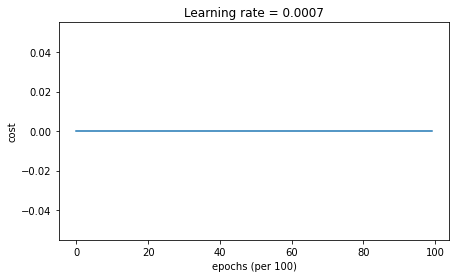

Accuracy: 0.5


AttributeError: module 'numpy' has no attribute 'arrange'

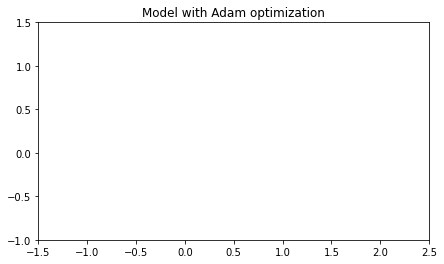

In [18]:
layers_dims = [train_X.shape[0], 5, 2, 1]
parameters = model(train_X, train_Y, layers_dims, optimizer = "adam")

# Predict
predictions = predict(train_X, train_Y, parameters)

# Plot decision boundary
plt.title("Model with Adam optimization")
axes = plt.gca()
axes.set_xlim([-1.5,2.5])
axes.set_ylim([-1,1.5])
plot_decision_boundary(lambda x: predict_dec(parameters, x.T), train_X, train_Y)

### Summary
Momentum usually helps, but given the small learning rate and the simplistic dataset, its impact is almost negligeable. Also, the huge oscillations you see in the cost come from the fact that some minibatches are more difficult thans others for the optimization algorithm.

Adam on the other hand, clearly outperforms mini-batch gradient descent and Momentum. If you run the model for more epochs on this simple dataset, all three methods will lead to very good results. However, you've seen that Adam converges a lot faster.

Some advantages of Adam include:

* Relatively low memory requirements (though higher than gradient descent and gradient descent with momentum)
* Usually works well even with little tuning of hyperparameters (except α)